# Simulating HETI's internship allocation algorithm and the problem of "stacking"
By Christopher Chen

This is a redux of an [article that I first wrote on my Github Pages](https://newageoflight.github.io/stack_sim/readme.html). Some of the library code has been modified to better adapt it to the format of a Jupyter notebook as well as implementing speed optimisations (via `numba.njit`) and fixing some general bad practices that I now recognise in my old code.

(Run the next few code cells to get started.)

In [1]:
# Only run if you're on Colab
# !git clone "https://github.com/newageoflight/stack_sim_revisited.git"

In [2]:
# Only run if you're on Colab
# cd stack_sim_revisited/

In [3]:
# Run this cell to perform code setup and get started

from heti_stack.tests import create_and_run_sim, create_and_run_single_strategy_simulation, compare_two_groups_all_conditions

## Motivation for this article

In the final year of medical school in Australia, most students are subjected to HETI's Optimised Allocation Pathway, and over the years, many people have looked for ways to optimise their own allocation. One such way this has been attempted is through "stacking", wherein a predefined order of hospitals is fed to the algorithm by candidates in an attempt to "beat" the algorithm and have a better shot at obtaining their highest preference. In this article, we will examine if that is really what it is doing, and explore the impact of HETI's allocation system on candidates. Later on we will also be going through some alternatives to the current algorithm and exploring if they really are as good as their proponents say they are.

## HETI's internship allocation algorithm

### Basic approach

- HETI's algorithm uses an approach called ["Simulated Annealing"](https://en.wikipedia.org/wiki/Simulated_annealing). This is an approach often used in disciplines like machine learning and optimisation problems to find the global minimum of a function.
    - The name "simulated annealing" comes from the idea that if you freeze a hot liquid metal quickly it won't cool down to form nice crystals, but if you cool it slowly, then it will.
    - Likewise, when our system is "hot", it is more likely to jump over ["energy barriers"](https://www.google.com/url?sa=i&url=https%3A%2F%2Fwww.khanacademy.org%2Fscience%2Fhigh-school-biology%2Fhs-energy-and-transport%2Fhs-enzymes%2Fa%2Factivation-energy&psig=AOvVaw1cwTMn0VeH1-dqOJFlgUKk&ust=1605411976792000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCMDvpeWPge0CFQAAAAAdAAAAABAD) i.e. make decisions that might initially appear unwise, but lead to better outcomes in the long-term.

### Details of the algorithm itself

- HETI's algorithm starts by allocating every Category 1 applicant to a random hospital.
- Subsequent categories have this process applied to them:
    - If there are more applicants than unfilled spots:
        - Randomise the list of remaining applicants in that category.
        - Then, take from the top however many will fill those remaining spots.
    - Else, randomise them all similar to Category 1.
- At this point the calculation begins.
    - Each applicant has an "unhappiness score" calculated based on how far down their preferences list their allocated hospital is.
    - The system tries to swap two people. If it results in a net decrease in unhappiness, then the swap is more likely to be followed through with. Else, nothing happens.
        - Remember, our system starts "hot", so it is more likely to make unwise decisions that might increase unhappiness at first.
    - HETI claims to repeat this process for "millions" of iterations.


    

## Implementation

### Model assumptions
1. With unweighted randomness, it is assumed that no hospital is more favourable than another.
2. With weighted randomness, hospital favourability at all levels is assumed to be similar to that at the first preference. That is, the probability-weight of a simulated applicant selecting each hospital is correlated with their popularity based on last year's survey.
3. Either everybody having the same stack or using two different variants of the stack were tested.
4. Everyone who applies accepts the first job offer they get.
5. DRA and other pathways that cannot be considered part of the optimised allocation algorithm have not been accounted for in running the simulation. However, parts of it are included as options in the code if you want to try it yourself.
6. Only 1 round of offers is simulated. Rejections are not accounted for.
7. Corollary from 4-6: Category 1 applicants are basically guaranteed a job.
8. Corollary from 7: Anyone category 3 or below will not get a job.
9. (from a reader) In real life, category 2 placements and beyond tend to be based more on luck of the draw (offer timing, rounds, category 1 rejections).
10. Corollary from 8,9: in terms of informing you as to what to do, this simulation is basically worthless for anyone outside of category 1, and maybe 2.

### Strategy function notes

- Random selection here is weighted based on the most popular first-preference hospitals of 2019 and is supposed to model overall population hospital preferences.
- For the random strategy, the first choice is weighted-random and the subsequent ones are unweighted-random.
- For the sake of convenience I've also assumed that there are only 7 stack variants floating around at any one time; in real life the number is probably much larger but I don't have precise data on which numbers are swapped or not.

### Annealing parameters used

α is the cooling rate and T the temperature.

| Parameter | Value | 
| :- | -: |
| α | 0.001 |
| T| 10000 |

## How does each strategy stack up?

(pun intended)

Each strategy has the following results reported:
- Convergence graph: shows progress of global unhappiness as the system makes more iterations
- Bar plots: shows how many applicants were placed at their nth preference in each category. If a category does not appear, it means that nobody from that category could be placed in the first round.
- If multiple strategies were used in the simulation, bar plots and significance tests are also included to compare different subgroups.
- Filters for wanting or getting a top 4 or 6 hospital are also included.

### Single strategies

#### All stack

C:\Users\camin\Code\stack_sim_revisited\heti_stack\sim_utils.py:77: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "heti_stack\sim_utils.py", line 63:
@numba.njit(parallel=True)
def np_colsum(a):
^

  next_over_capacity = (np_colsum(next_state_arr) > capacity_arr).any()


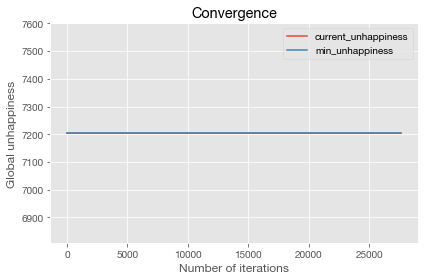

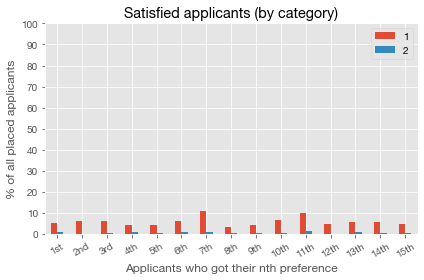

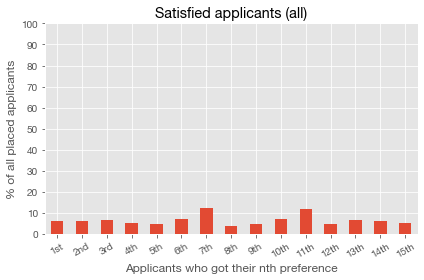

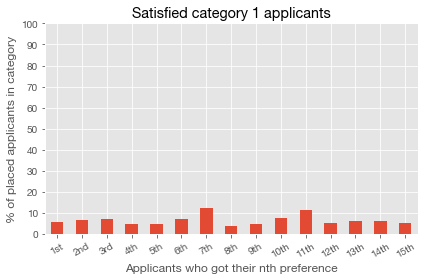

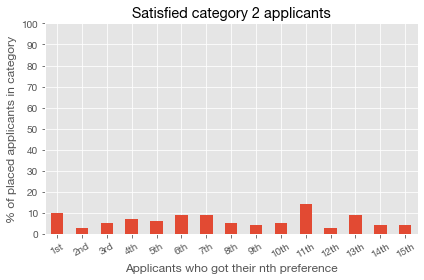

...

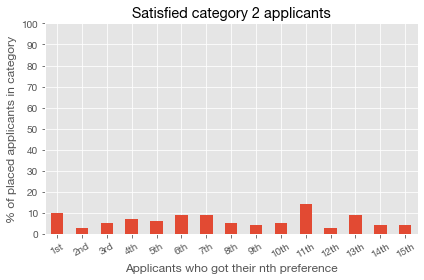

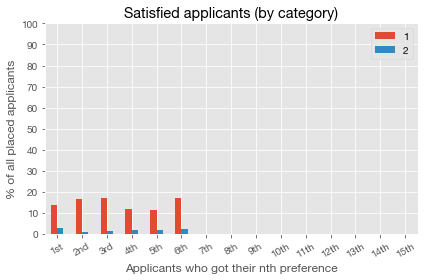

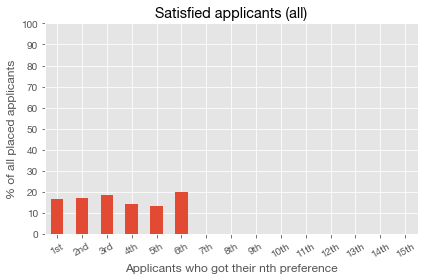

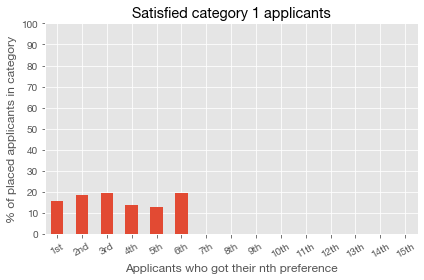

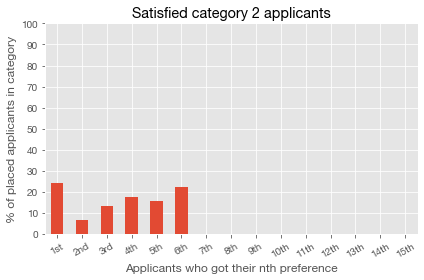

AnnealSimulation([('stack', 1.0)])

In [4]:
create_and_run_single_strategy_simulation("stack")

#### All random

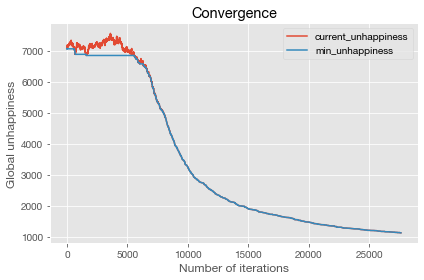

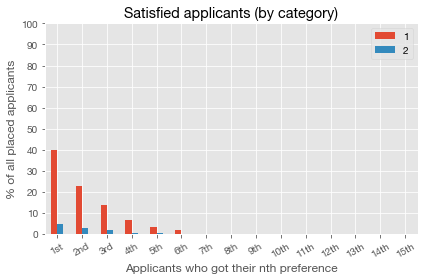

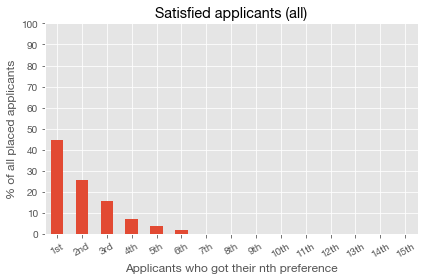

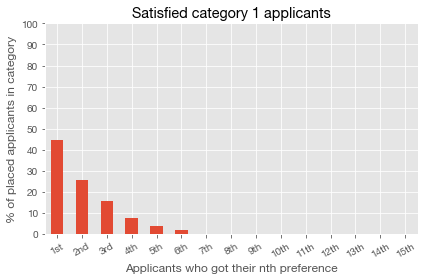

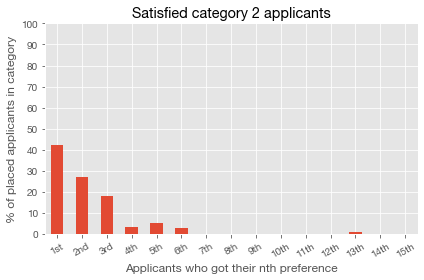

...

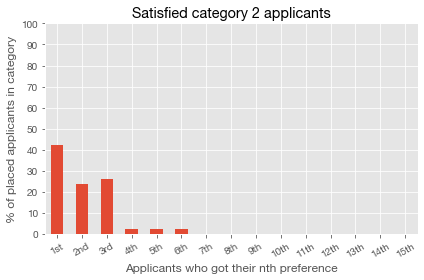

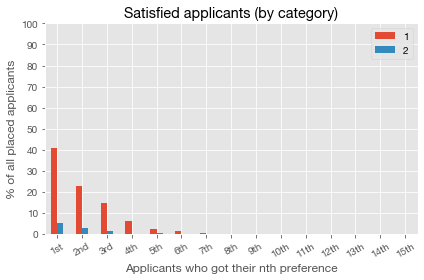

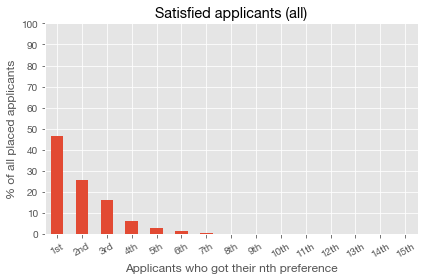

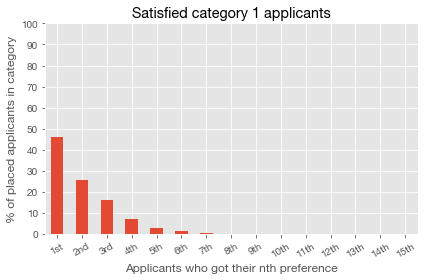

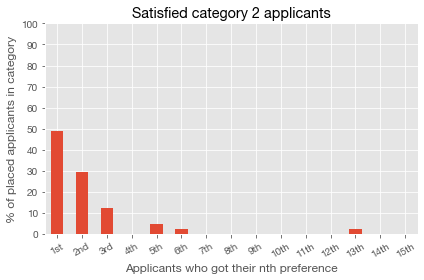

AnnealSimulation([('random', 1.0)])

In [5]:
create_and_run_single_strategy_simulation("random")

#### Mixed stacks

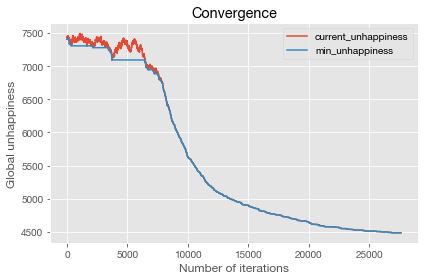

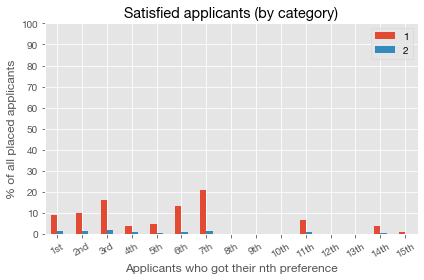

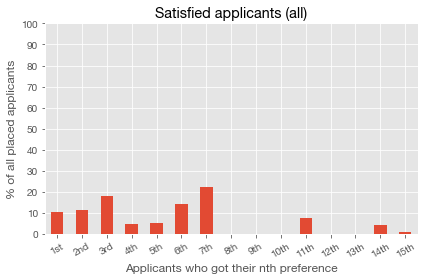

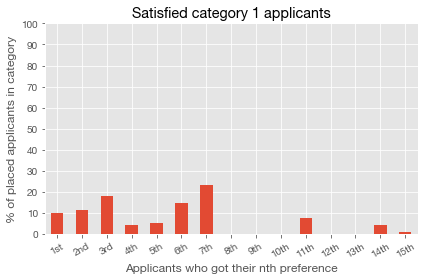

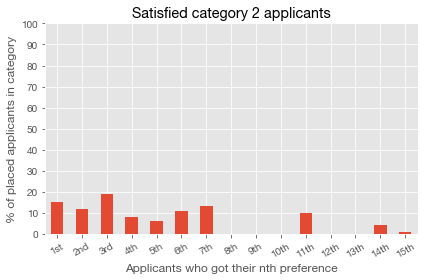

...

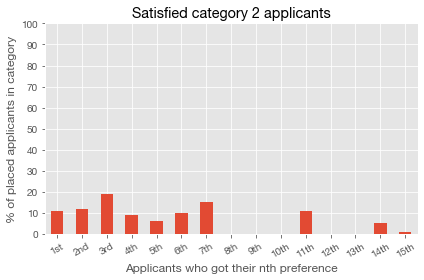

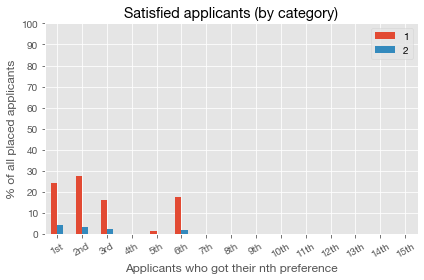

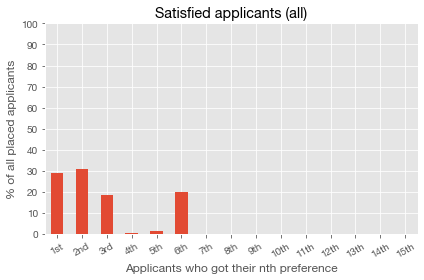

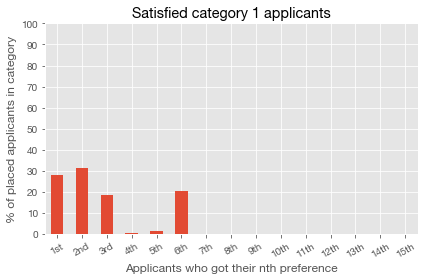

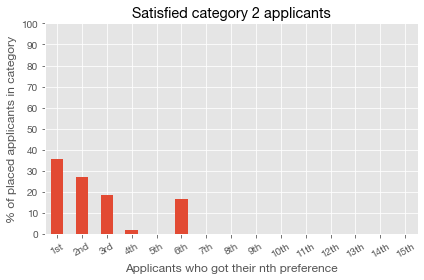

AnnealSimulation([('variant stack', 1.0)])

In [6]:
create_and_run_single_strategy_simulation("variant stack")

#### With all stacks identical

##### All stacks identical, random top

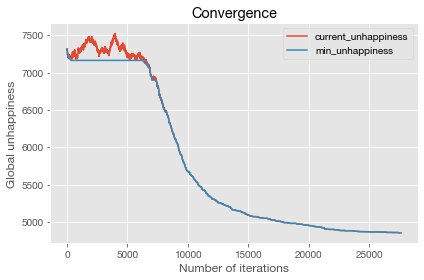

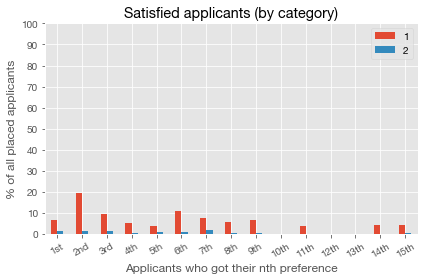

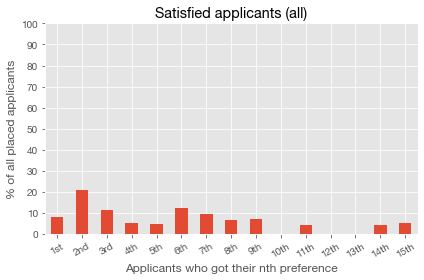

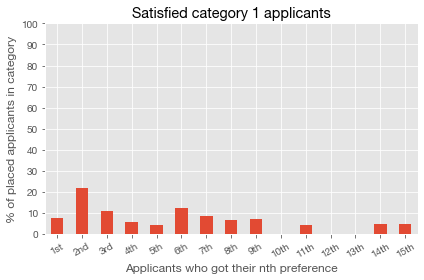

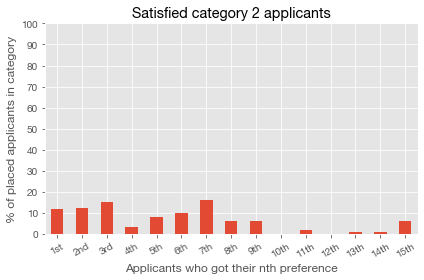

...

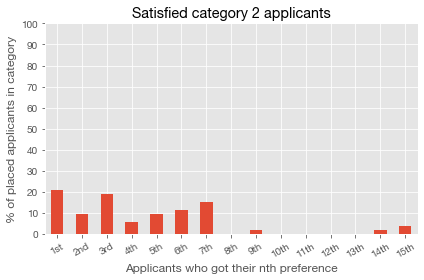

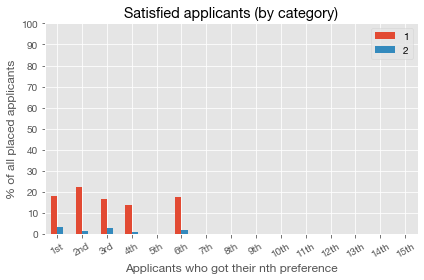

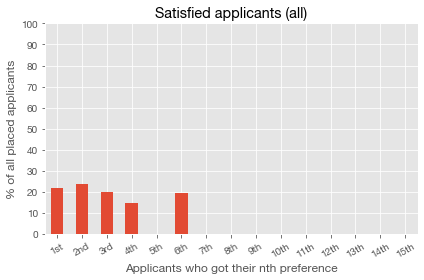

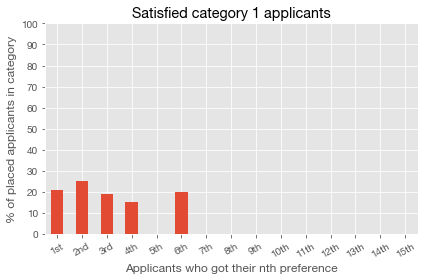

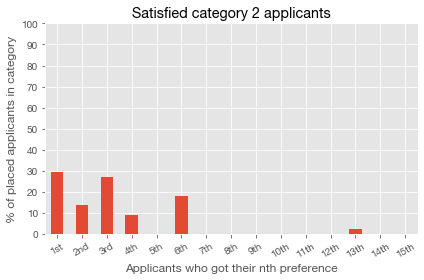

AnnealSimulation([('stack with random top', 1.0)])

In [7]:
create_and_run_single_strategy_simulation("stack with random top")

##### All stacks identical, random top and 12th

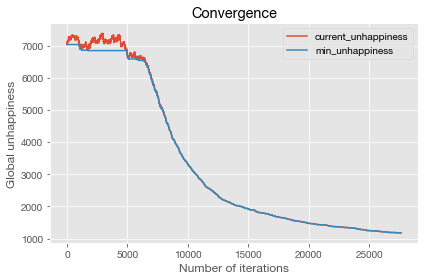

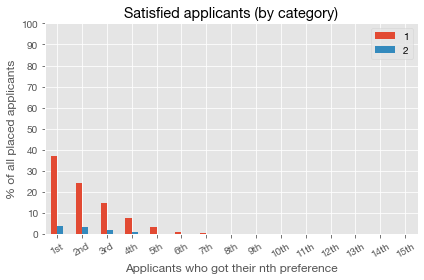

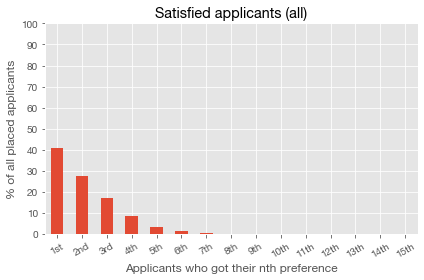

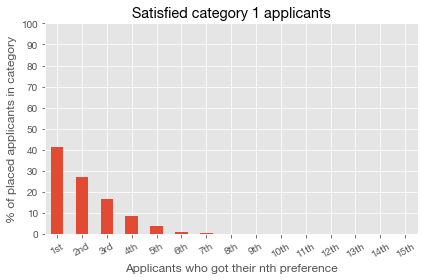

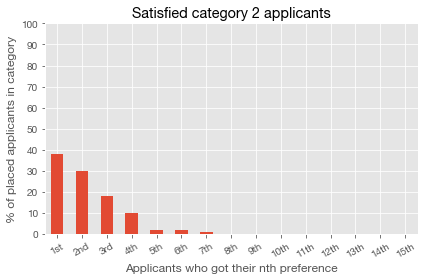

...

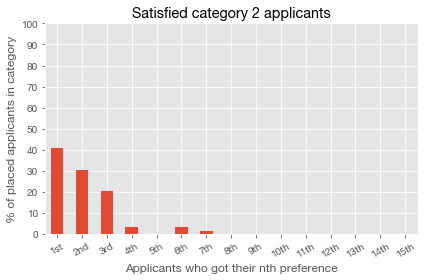

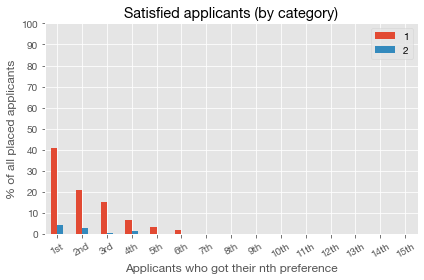

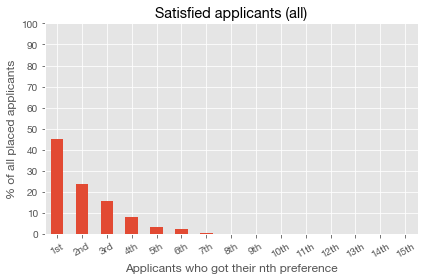

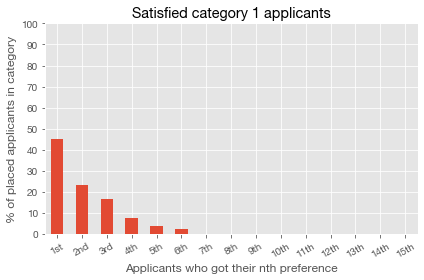

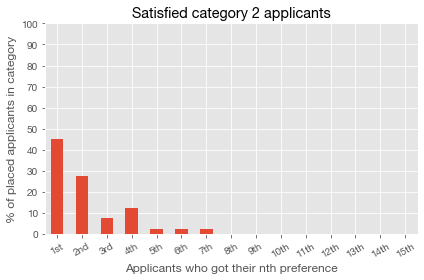

AnnealSimulation([('stack with random 1st and 12th', 1.0)])

In [8]:
create_and_run_single_strategy_simulation("stack with random 1st and 12th")

##### All stacks identical, random top and 14th

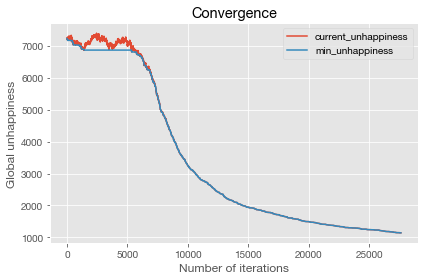

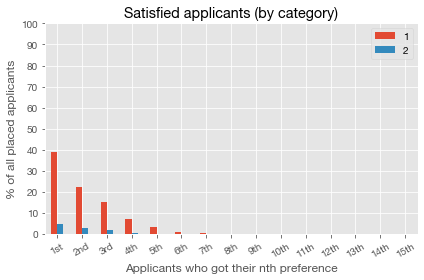

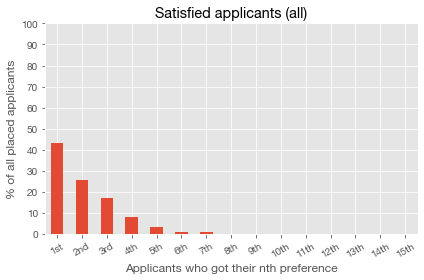

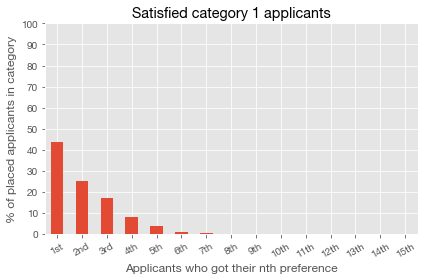

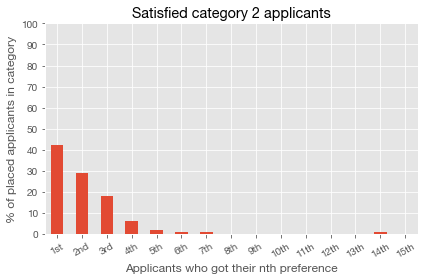

...

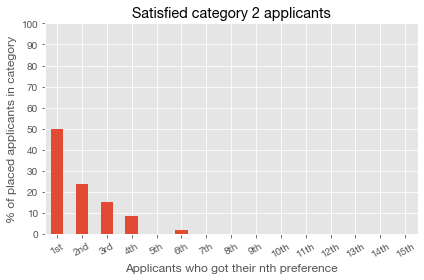

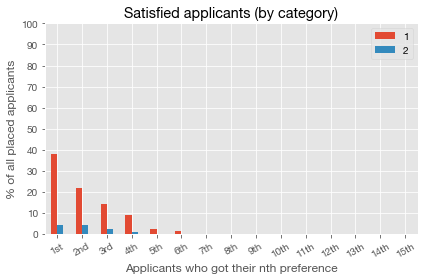

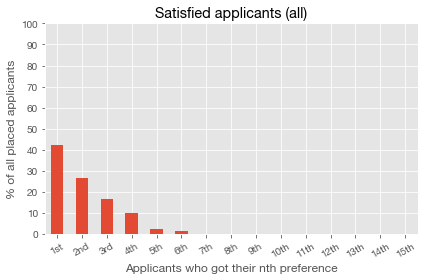

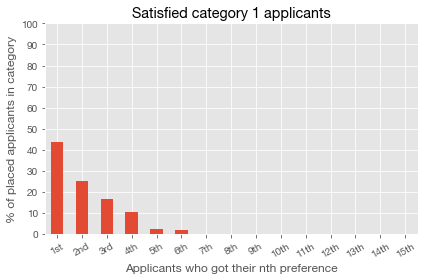

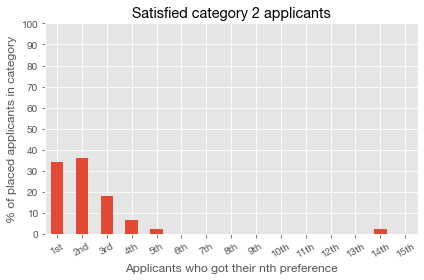

AnnealSimulation([('stack with random 1st and 14th', 1.0)])

In [9]:
create_and_run_single_strategy_simulation("stack with random 1st and 14th")

#### With mixed stacks

##### Mixed stacks, random top

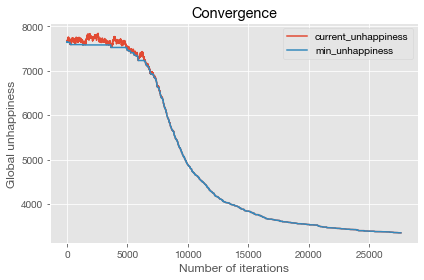

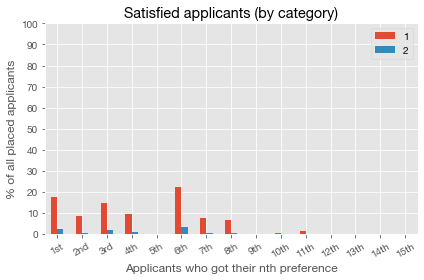

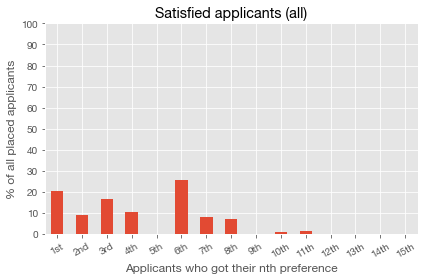

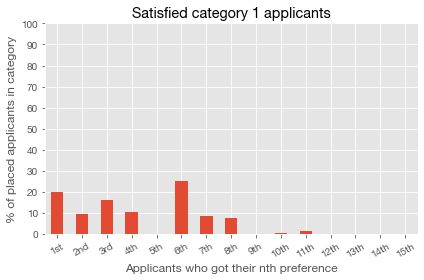

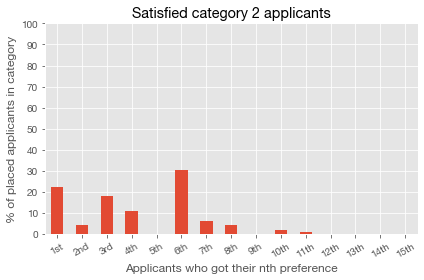

...

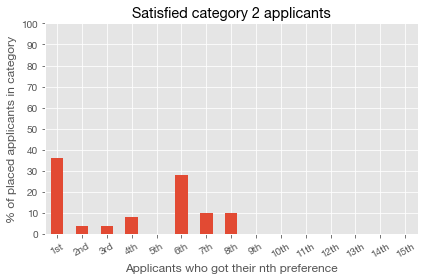

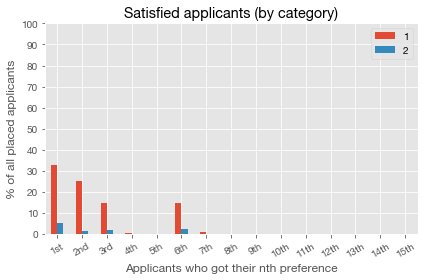

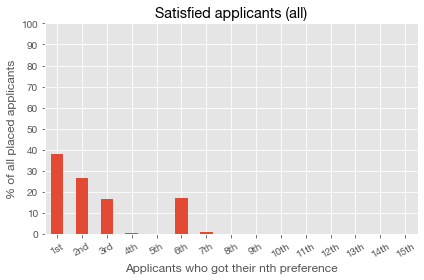

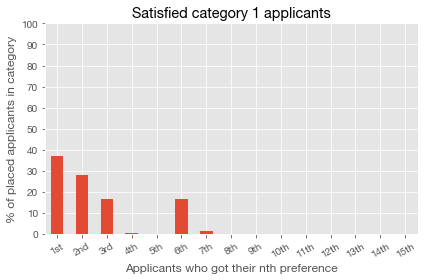

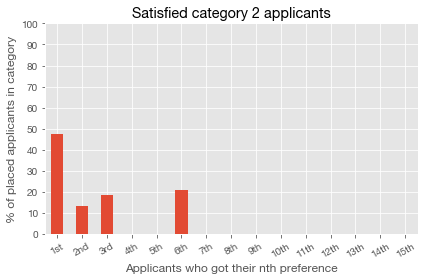

AnnealSimulation([('variant stack with random top', 1.0)])

In [10]:
create_and_run_single_strategy_simulation("variant stack with random top")

##### Mixed stacks, random top and 12th

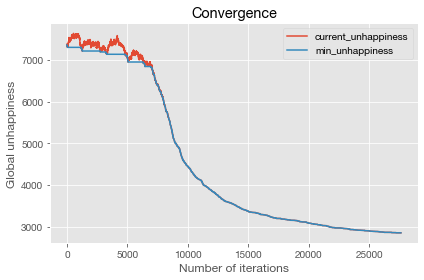

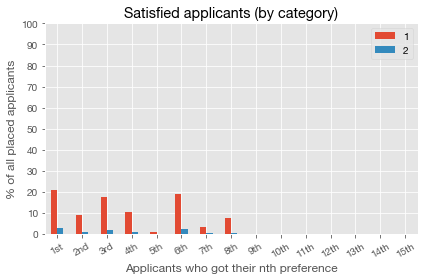

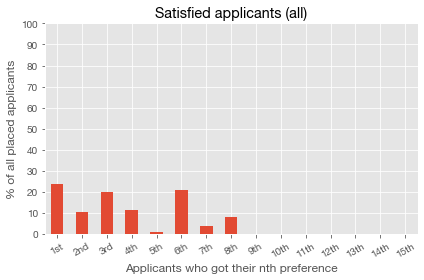

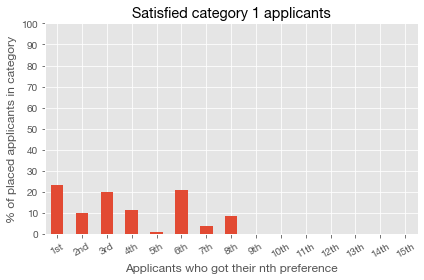

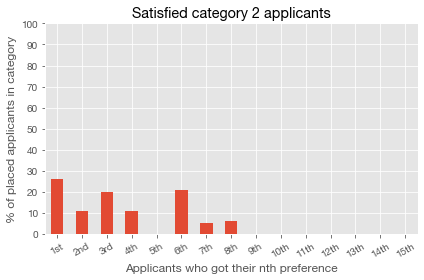

...

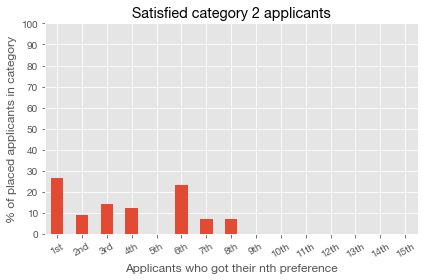

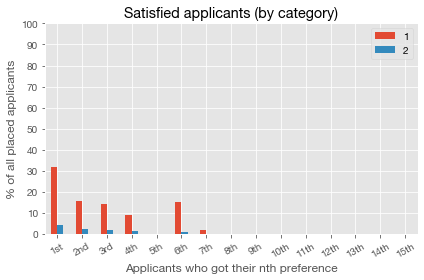

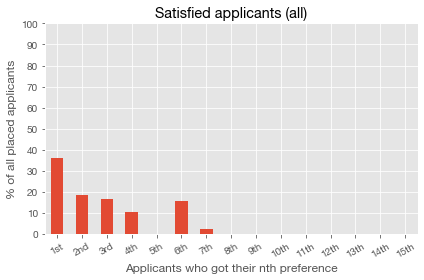

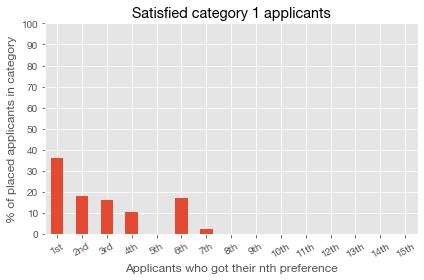

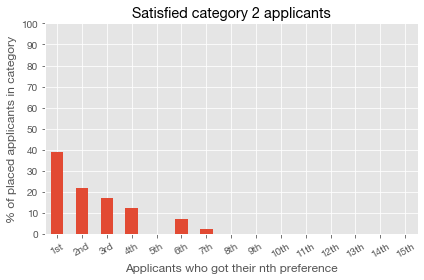

AnnealSimulation([('variant stack with random 1st and 12th', 1.0)])

In [11]:
create_and_run_single_strategy_simulation("variant stack with random 1st and 12th")

##### Mixed stacks, random top and 14th

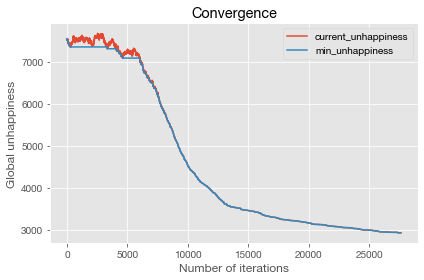

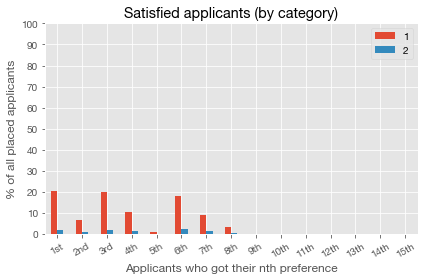

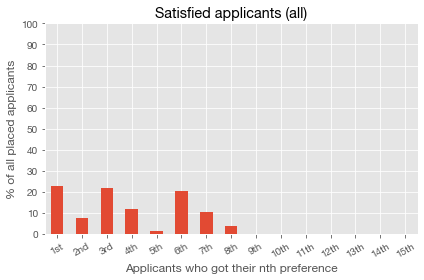

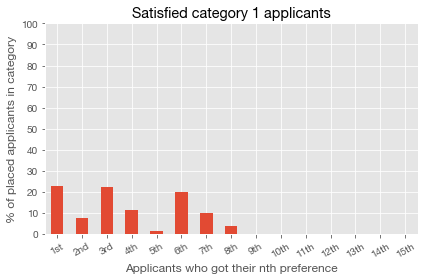

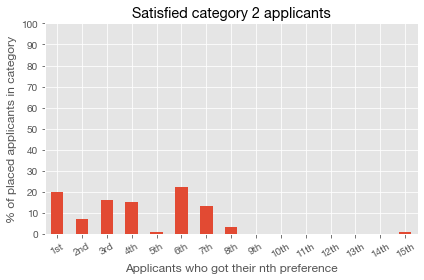

...

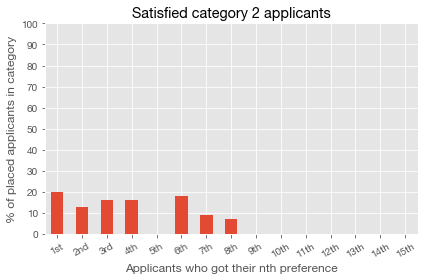

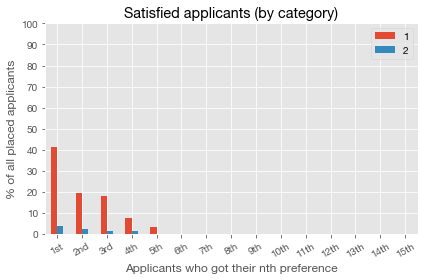

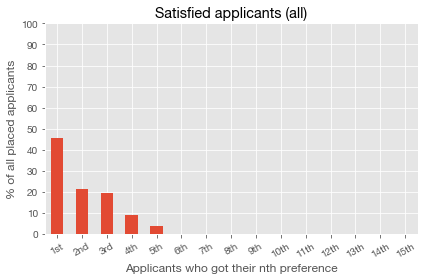

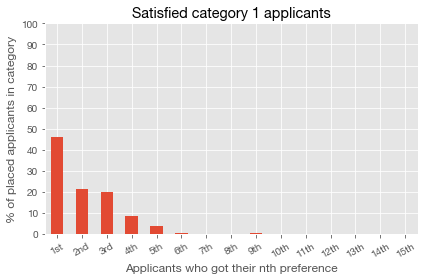

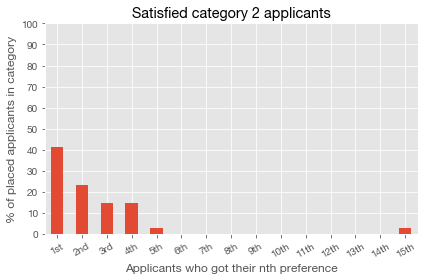

AnnealSimulation([('variant stack with random 1st and 14th', 1.0)])

In [12]:
create_and_run_single_strategy_simulation("variant stack with random 1st and 14th")

### Mixed strategies

Of course, it's unrealistic to expect that everyone will use the exact same strategy. A more realistic model would be to have a mix of different strategies in different proportions.

(run the next code block to get started)

In [13]:
from heti_stack.tests import compare_two_groups_all_conditions

#### 80% stack with random first, 20% random

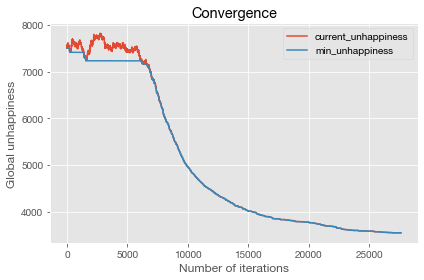

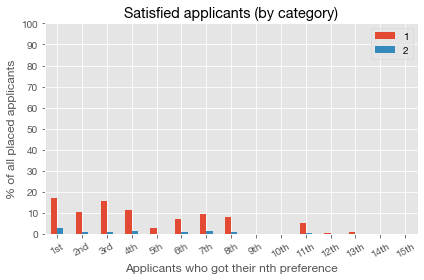

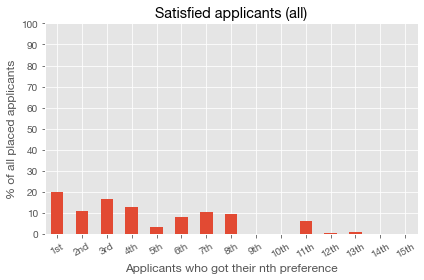

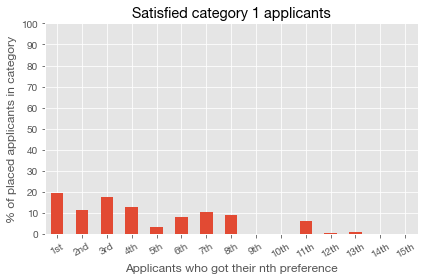

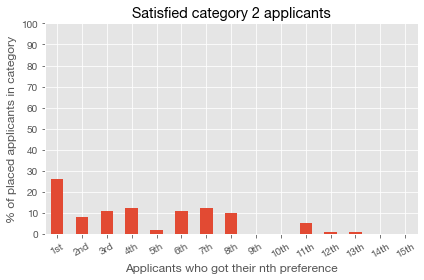

,Average unhappiness
strategy,
random,1.924107
stack with random top,3.890411


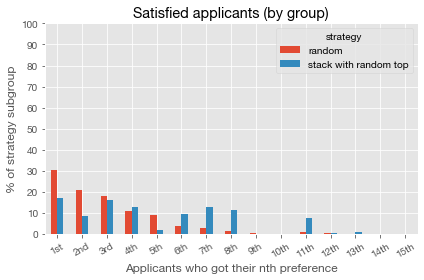

,random,stack with random top
Got first preference,30.36%,17.19%
Did not get first preference,69.64%,82.81%


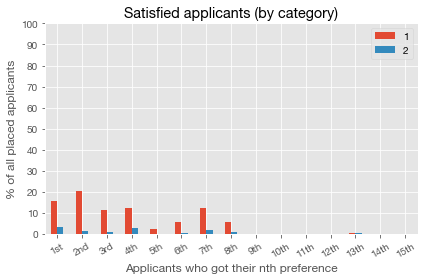

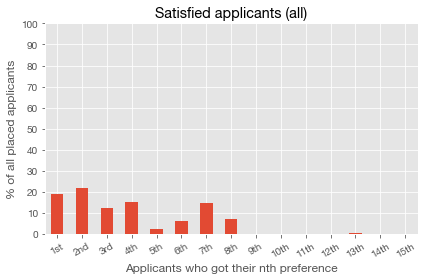

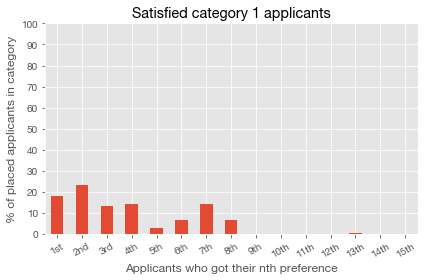

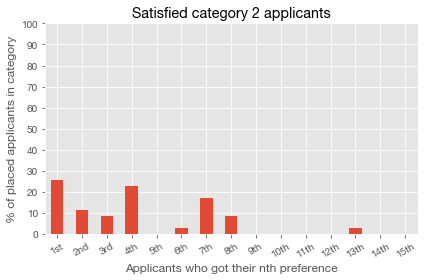

,Average unhappiness
strategy,
random,1.928571
stack with random top,3.013043


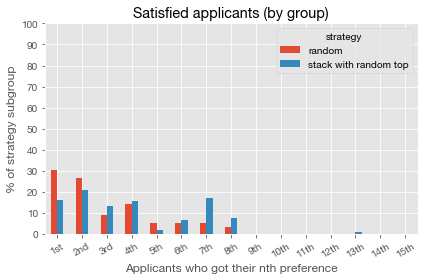

,random,stack with random top
Got first preference,30.36%,16.09%
Did not get first preference,69.64%,83.91%


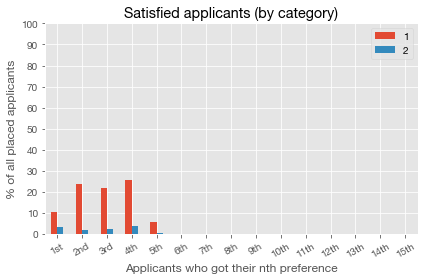

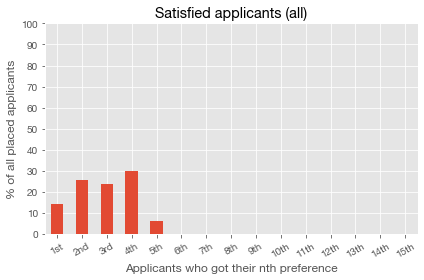

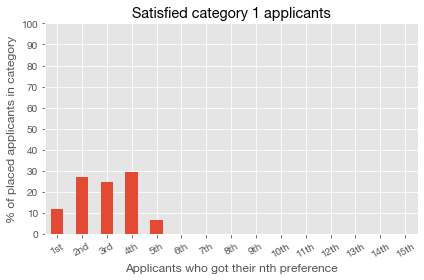

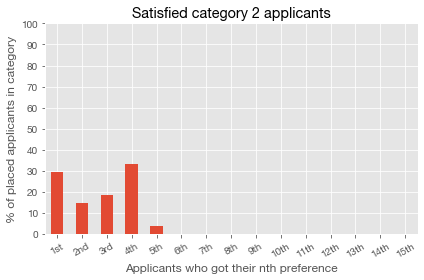

,Average unhappiness
strategy,
random,0.833333
stack with random top,1.908676


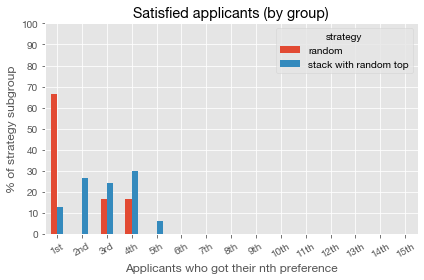

,random,stack with random top
Got first preference,66.67%,12.79%
Did not get first preference,33.33%,87.21%


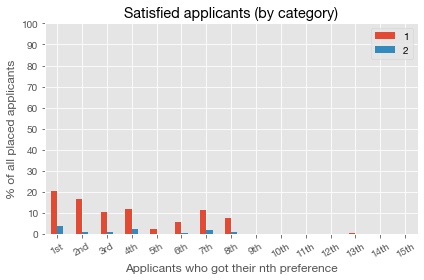

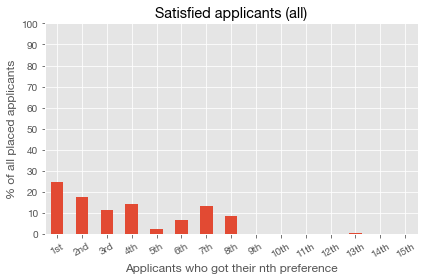

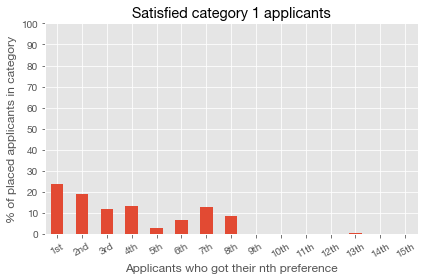

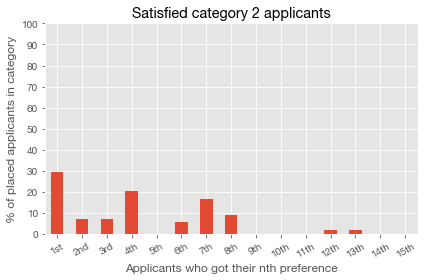

,Average unhappiness
strategy,
random,2.059524
stack with random top,2.969880


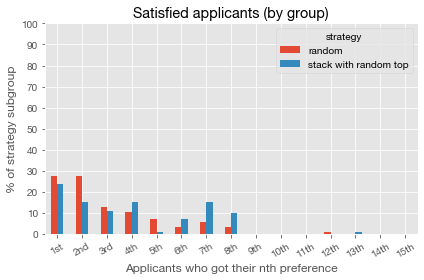

,random,stack with random top
Got first preference,27.38%,23.80%
Did not get first preference,72.62%,76.20%


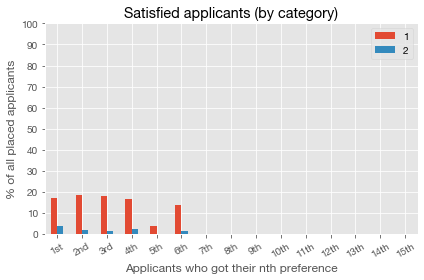

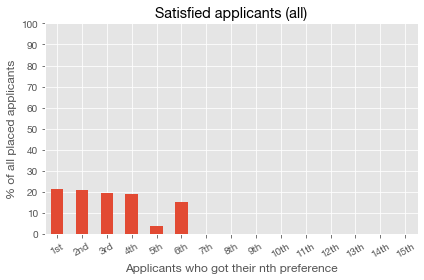

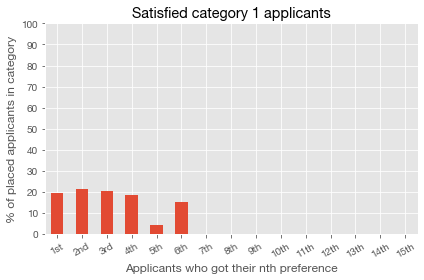

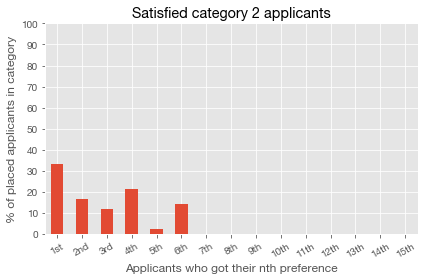

,Average unhappiness
strategy,
random,0.555556
stack with random top,2.179641


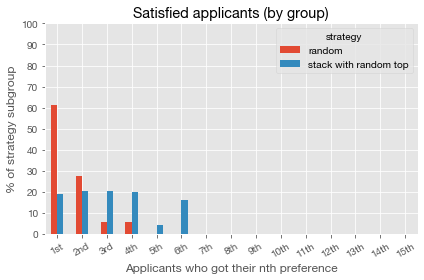

,random,stack with random top
Got first preference,61.11%,19.16%
Did not get first preference,38.89%,80.84%


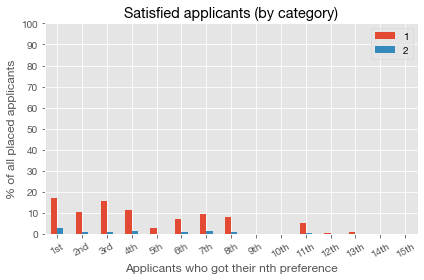

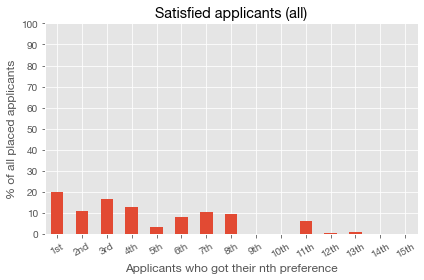

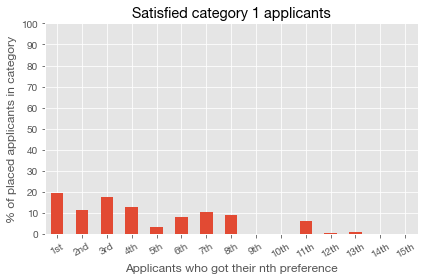

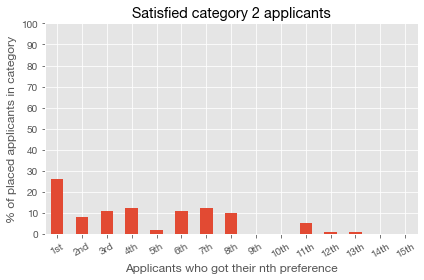

,Average unhappiness
strategy,
random,1.924107
stack with random top,3.890411


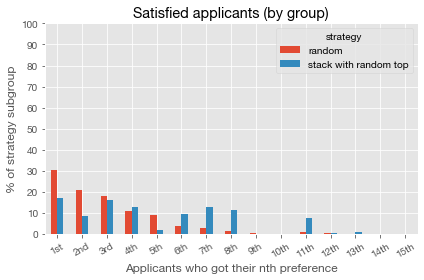

,random,stack with random top
Got first preference,30.36%,17.19%
Did not get first preference,69.64%,82.81%


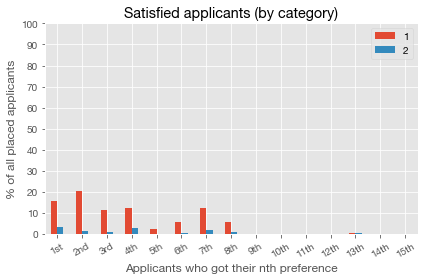

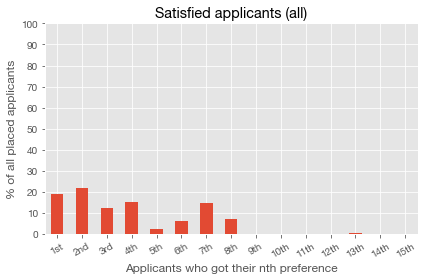

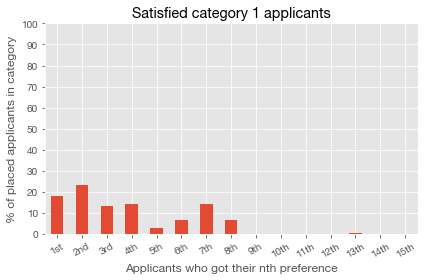

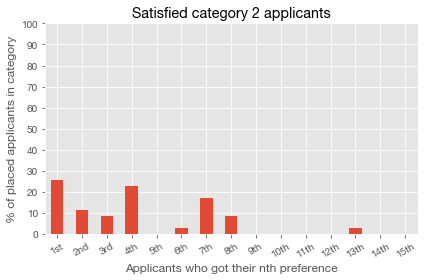

,Average unhappiness
strategy,
random,1.928571
stack with random top,3.013043


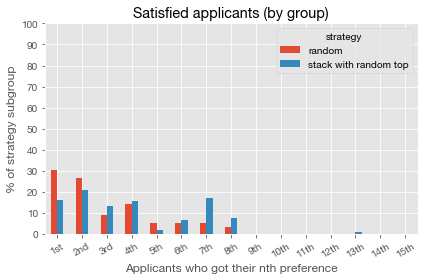

,random,stack with random top
Got first preference,30.36%,16.09%
Did not get first preference,69.64%,83.91%


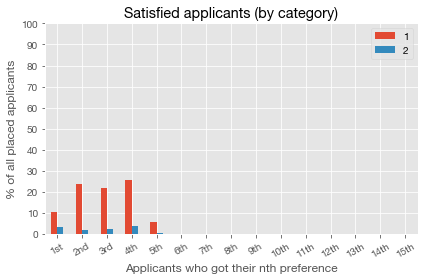

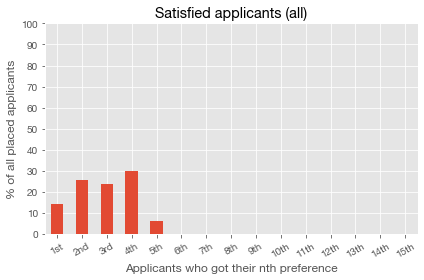

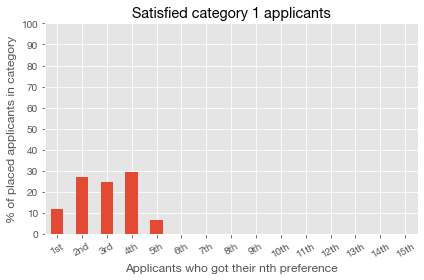

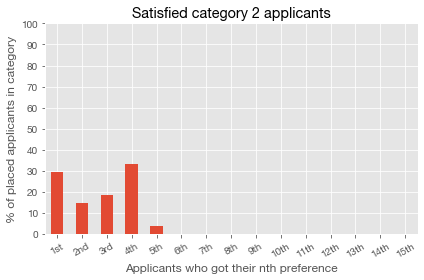

,Average unhappiness
strategy,
random,0.833333
stack with random top,1.908676


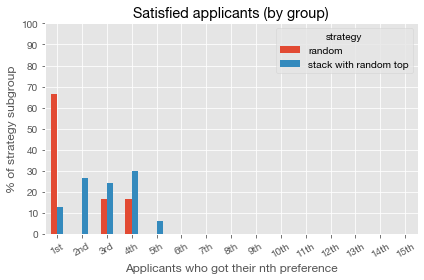

,random,stack with random top
Got first preference,66.67%,12.79%
Did not get first preference,33.33%,87.21%


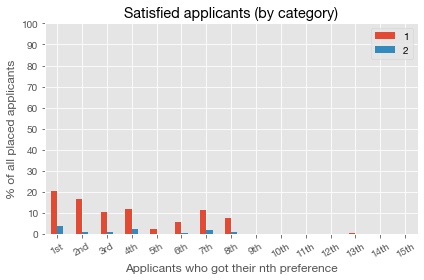

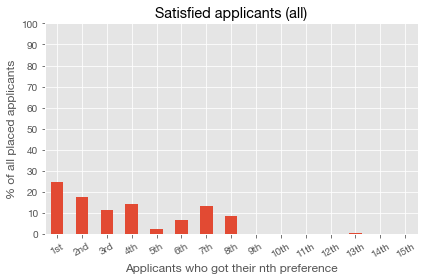

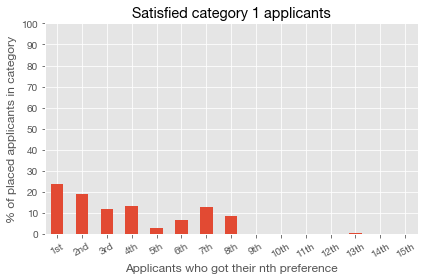

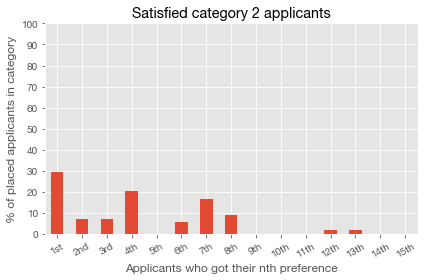

,Average unhappiness
strategy,
random,2.059524
stack with random top,2.969880


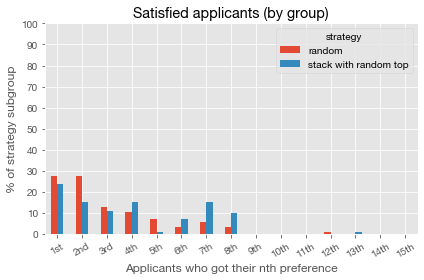

,random,stack with random top
Got first preference,27.38%,23.80%
Did not get first preference,72.62%,76.20%


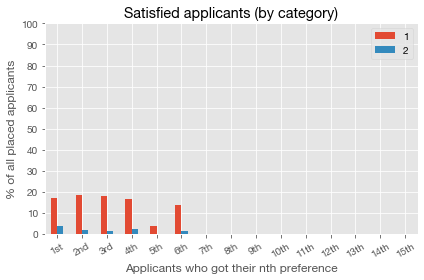

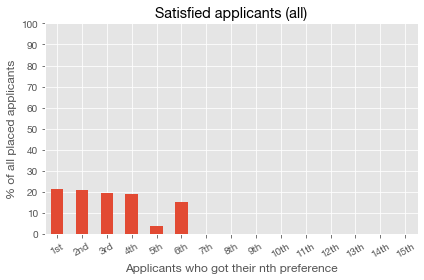

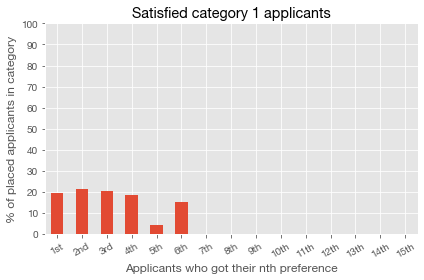

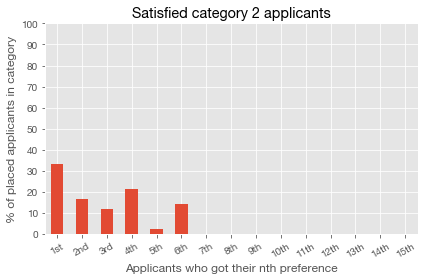

,Average unhappiness
strategy,
random,0.555556
stack with random top,2.179641


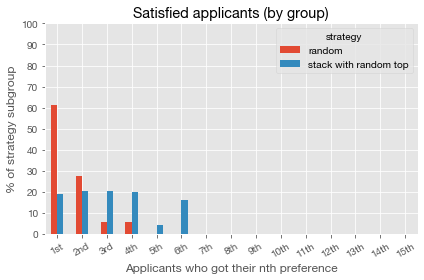

,random,stack with random top
Got first preference,61.11%,19.16%
Did not get first preference,38.89%,80.84%


AnnealSimulation([('stack with random top', 0.8), ('random', 0.2)])

In [14]:
create_and_run_sim([
    ("stack with random top", 0.8),
    ("random", 0.2)
])

#### 60% stack with random first, 40% random

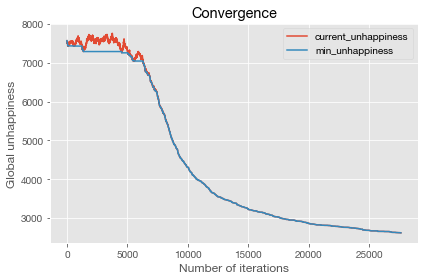

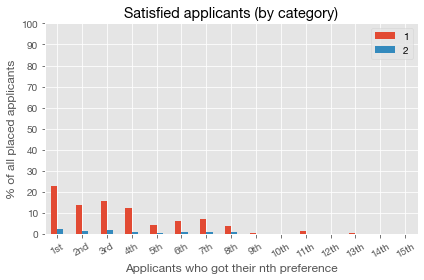

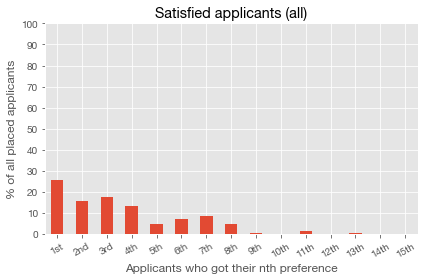

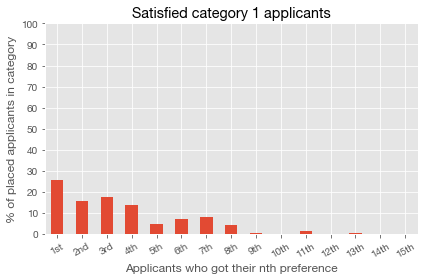

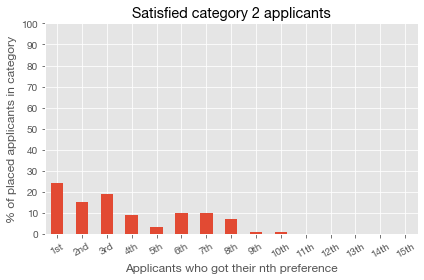

,Average unhappiness
strategy,
random,1.724466
stack with random top,3.128713


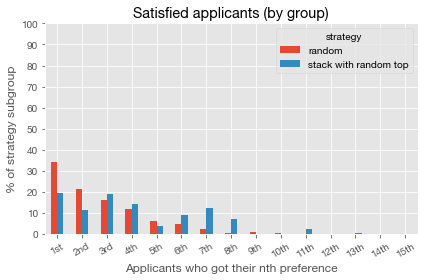

,random,stack with random top
Got first preference,34.20%,19.64%
Did not get first preference,65.80%,80.36%


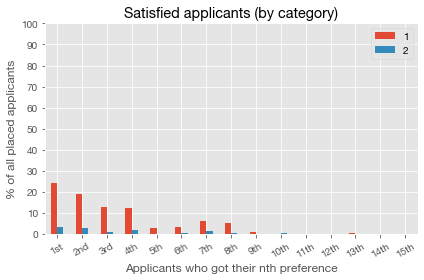

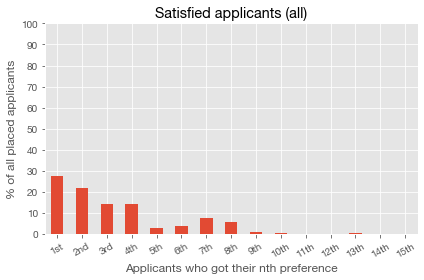

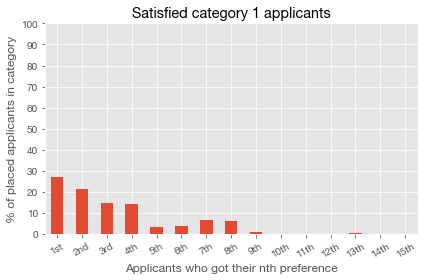

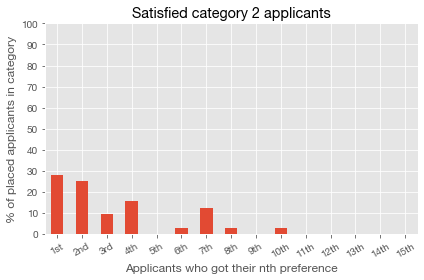

,Average unhappiness
strategy,
random,1.669811
stack with random top,2.643275


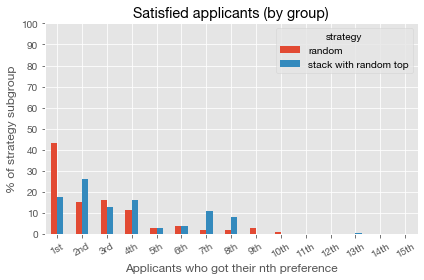

,random,stack with random top
Got first preference,43.40%,17.54%
Did not get first preference,56.60%,82.46%


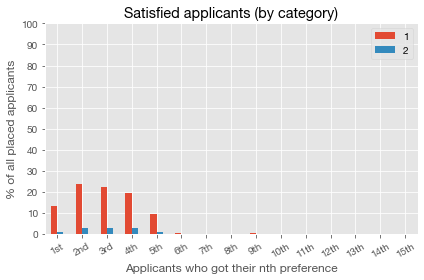

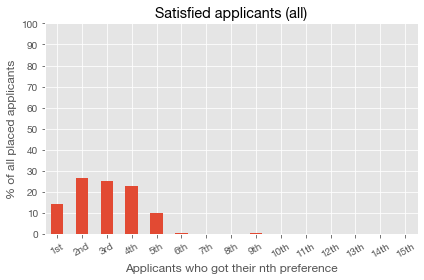

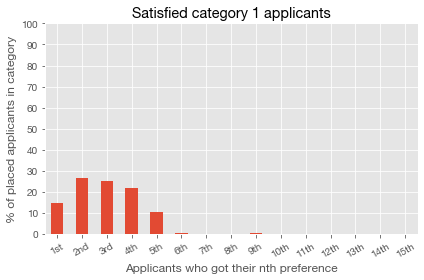

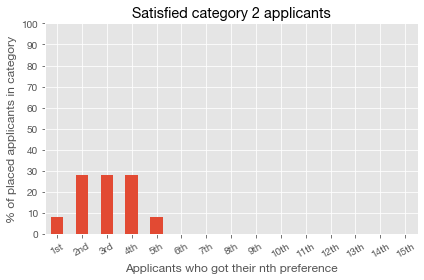

,Average unhappiness
strategy,
random,0.870968
stack with random top,2.087629


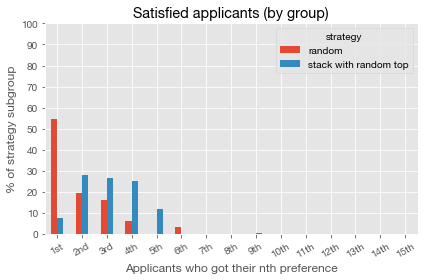

,random,stack with random top
Got first preference,54.84%,7.73%
Did not get first preference,45.16%,92.27%


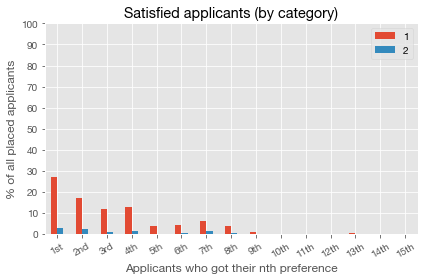

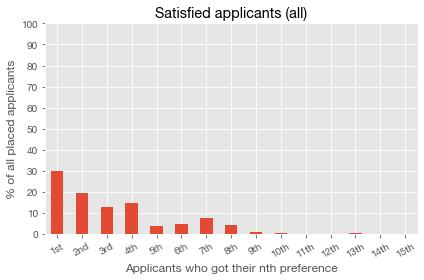

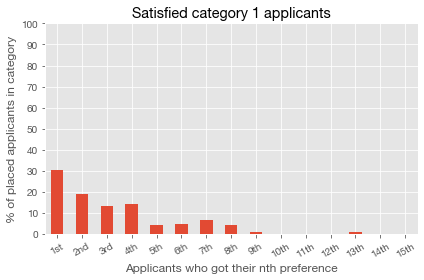

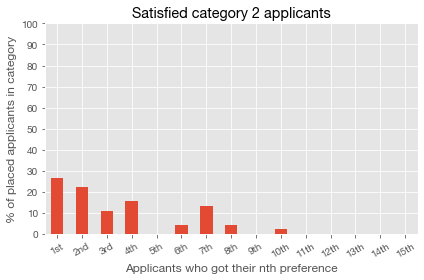

,Average unhappiness
strategy,
random,1.784884
stack with random top,2.577075


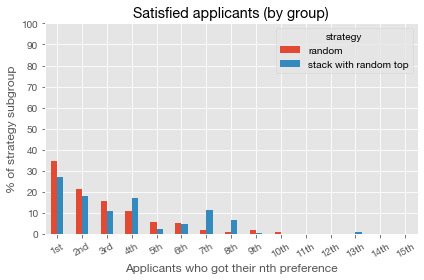

,random,stack with random top
Got first preference,34.88%,26.88%
Did not get first preference,65.12%,73.12%


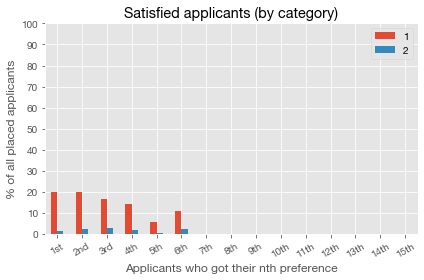

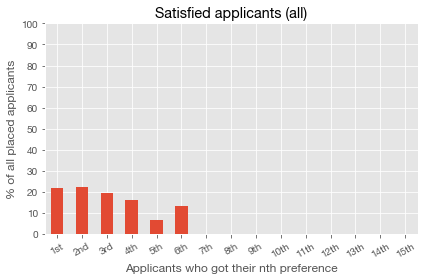

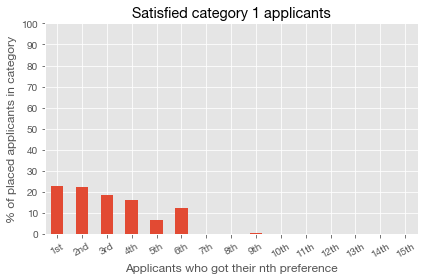

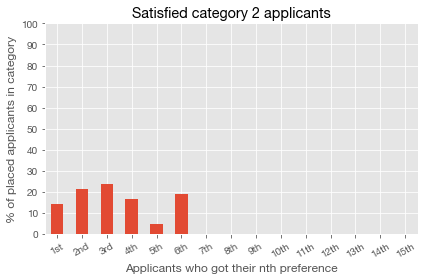

,Average unhappiness
strategy,
random,0.929825
stack with random top,2.264407


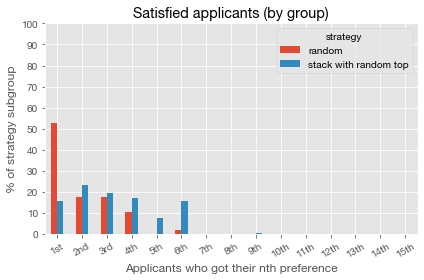

,random,stack with random top
Got first preference,52.63%,15.93%
Did not get first preference,47.37%,84.07%


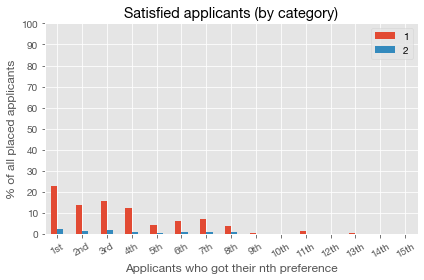

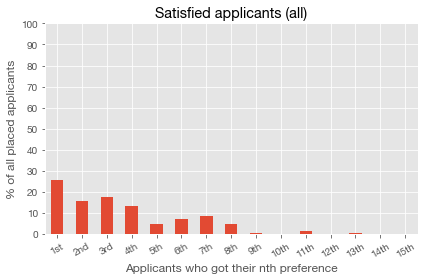

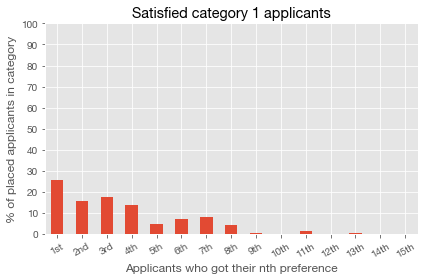

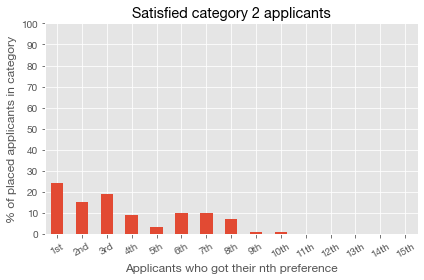

,Average unhappiness
strategy,
random,1.724466
stack with random top,3.128713


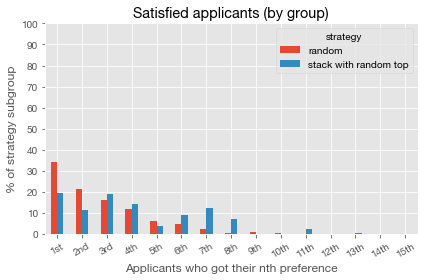

,random,stack with random top
Got first preference,34.20%,19.64%
Did not get first preference,65.80%,80.36%


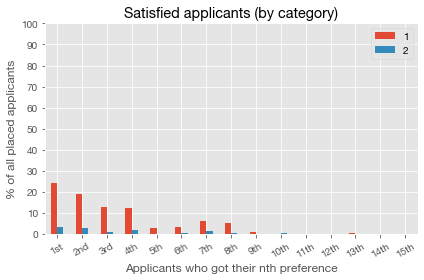

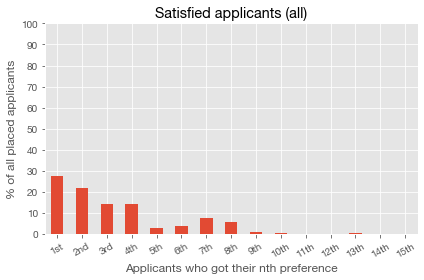

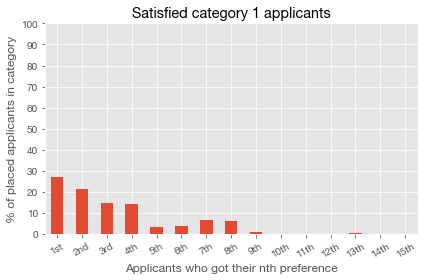

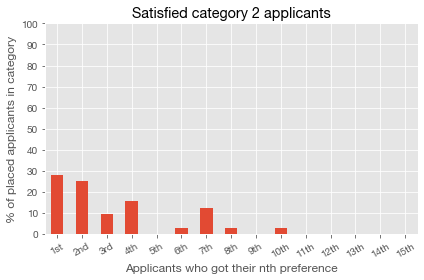

,Average unhappiness
strategy,
random,1.669811
stack with random top,2.643275


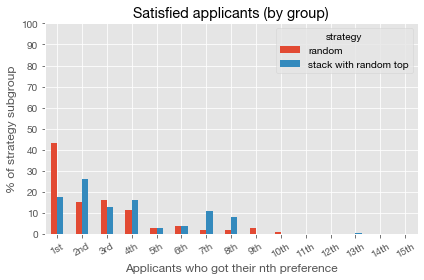

,random,stack with random top
Got first preference,43.40%,17.54%
Did not get first preference,56.60%,82.46%


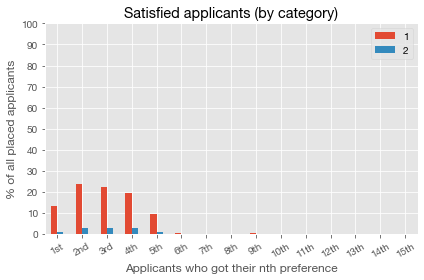

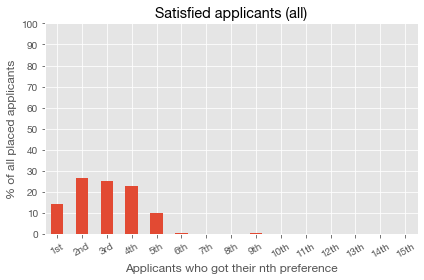

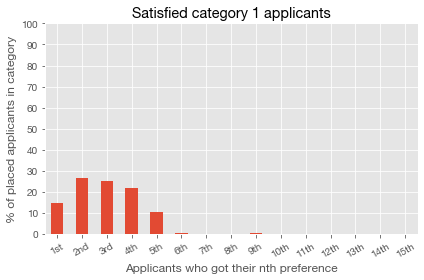

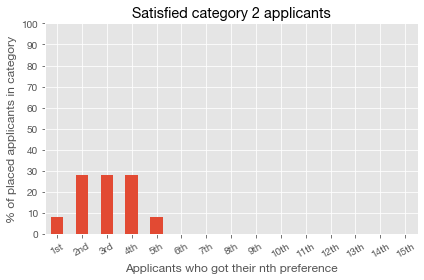

,Average unhappiness
strategy,
random,0.870968
stack with random top,2.087629


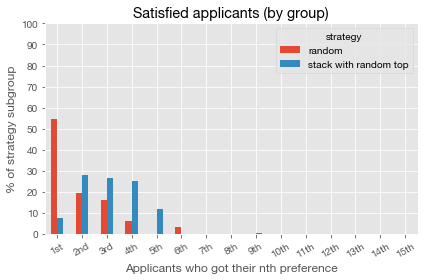

,random,stack with random top
Got first preference,54.84%,7.73%
Did not get first preference,45.16%,92.27%


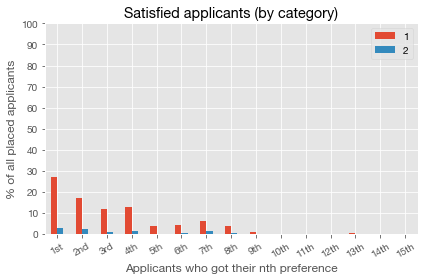

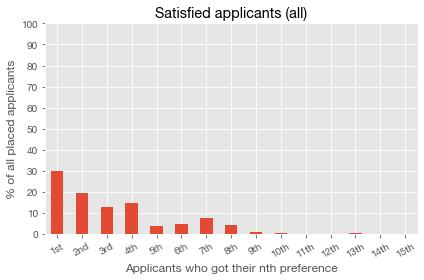

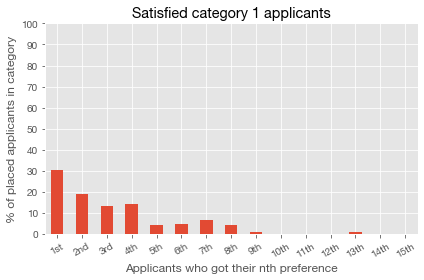

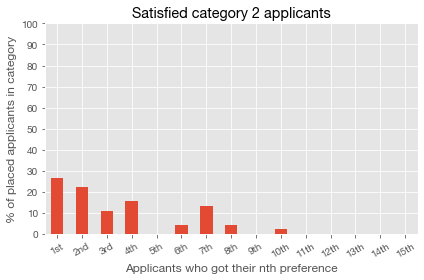

,Average unhappiness
strategy,
random,1.784884
stack with random top,2.577075


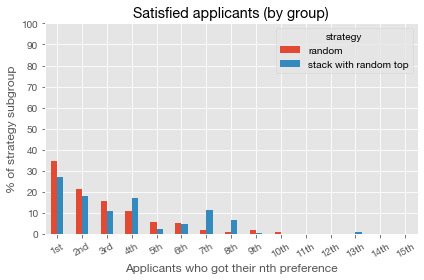

,random,stack with random top
Got first preference,34.88%,26.88%
Did not get first preference,65.12%,73.12%


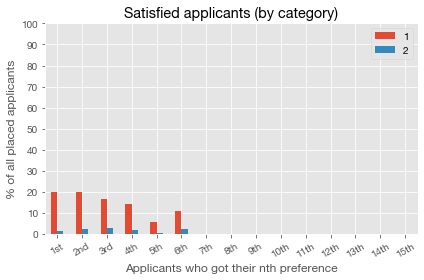

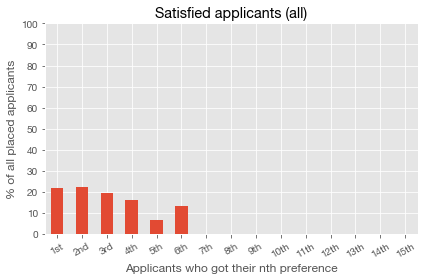

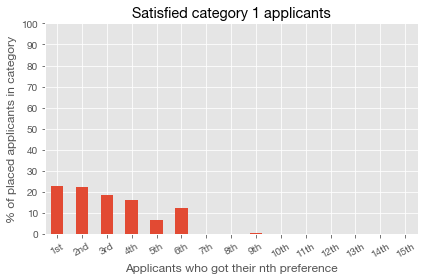

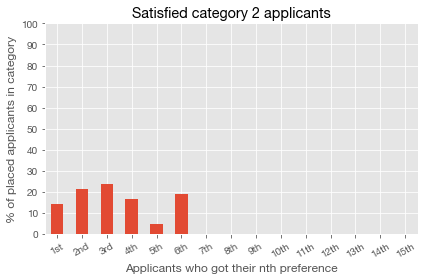

,Average unhappiness
strategy,
random,0.929825
stack with random top,2.264407


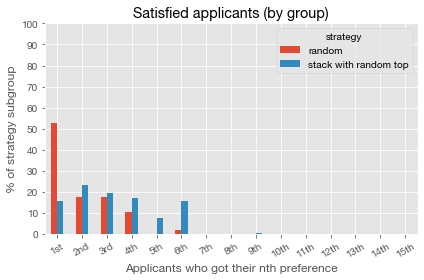

,random,stack with random top
Got first preference,52.63%,15.93%
Did not get first preference,47.37%,84.07%


AnnealSimulation([('stack with random top', 0.6), ('random', 0.4)])

In [15]:
create_and_run_sim([
    ("stack with random top", 0.6),
    ("random", 0.4)
])

#### 10% random with weighted random top, 30% mixed stacks, 60% default stack

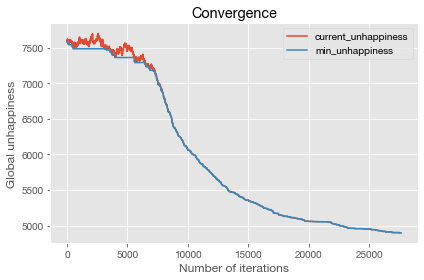

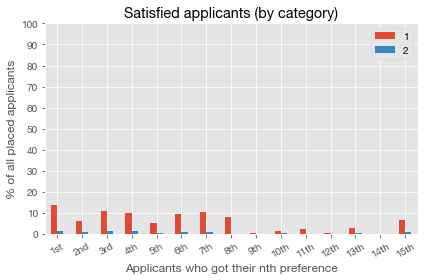

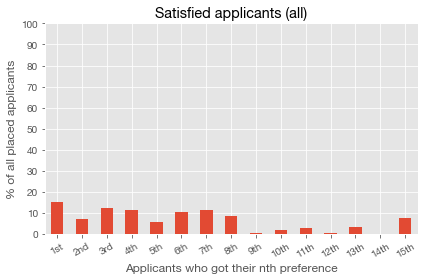

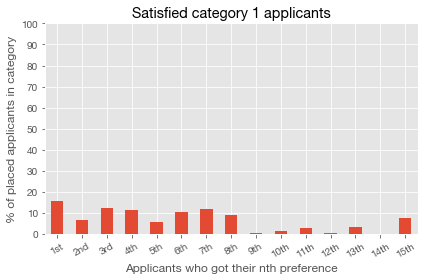

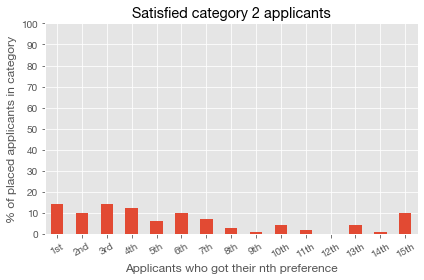

,Average unhappiness
strategy,
random with weighted random top,2.173913
stack,5.953074
variant stack,3.295918


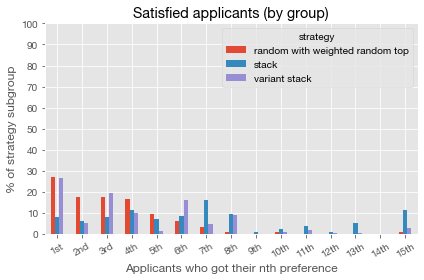

,random with weighted random top,stack,variant stack
Got first preference,26.96%,7.93%,26.87%
Did not get first preference,73.04%,92.07%,73.13%


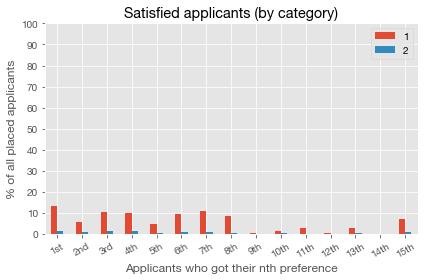

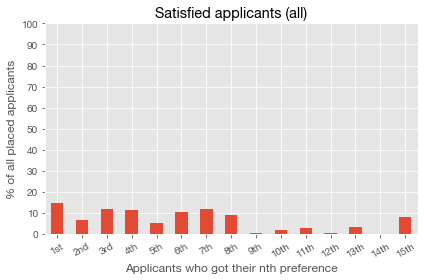

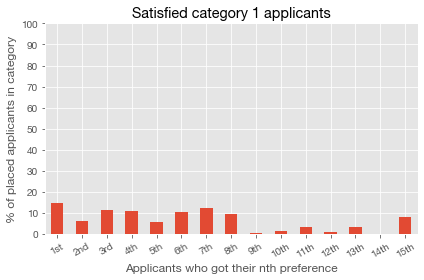

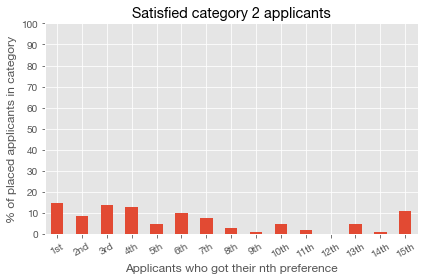

,Average unhappiness
strategy,
random with weighted random top,1.615385
stack,5.953074
variant stack,3.295918


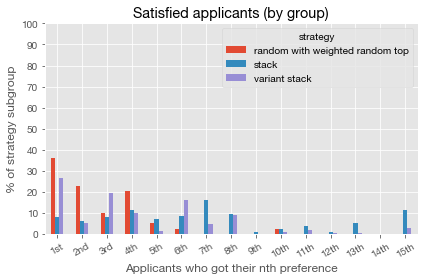

,random with weighted random top,stack,variant stack
Got first preference,35.90%,7.93%,26.87%
Did not get first preference,64.10%,92.07%,73.13%


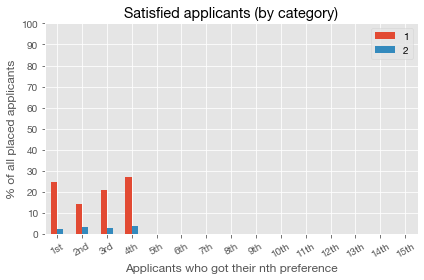

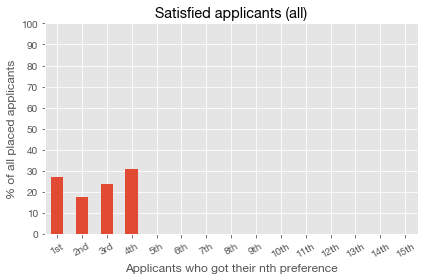

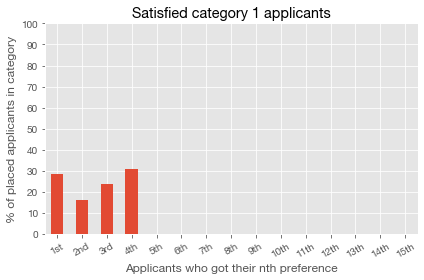

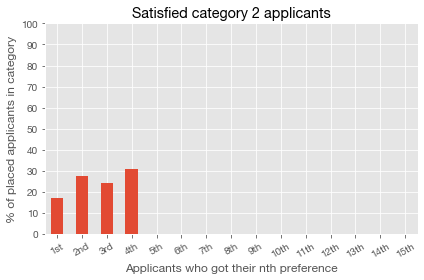

,Average unhappiness
strategy,
random with weighted random top,0.000000
stack,1.681159
variant stack,0.588235


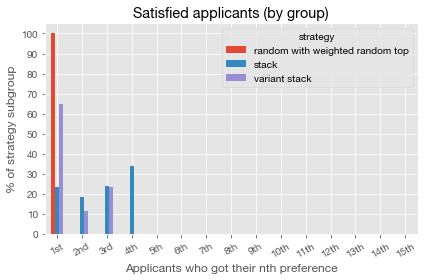

,random with weighted random top,stack,variant stack
Got first preference,100.00%,23.67%,64.71%
Did not get first preference,0.00%,76.33%,35.29%


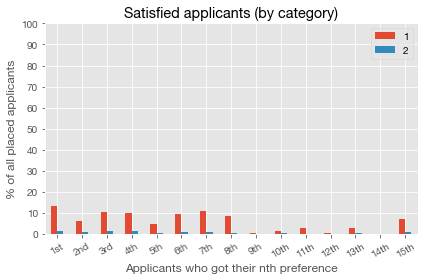

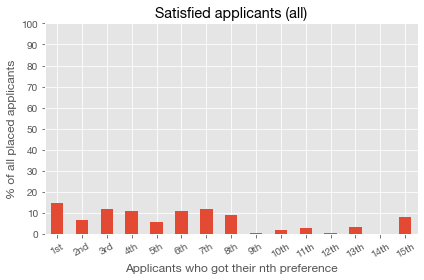

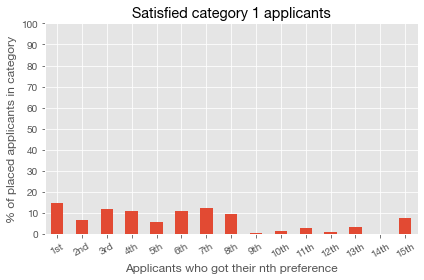

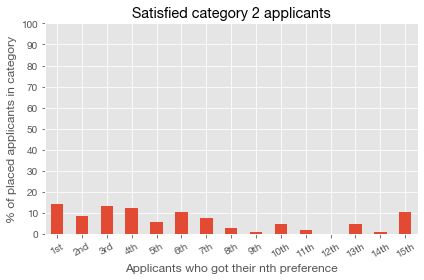

,Average unhappiness
strategy,
random with weighted random top,2.072727
stack,5.953074
variant stack,3.295918


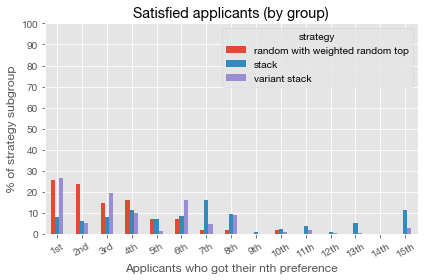

,random with weighted random top,stack,variant stack
Got first preference,25.45%,7.93%,26.87%
Did not get first preference,74.55%,92.07%,73.13%


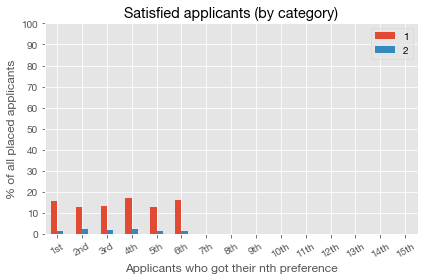

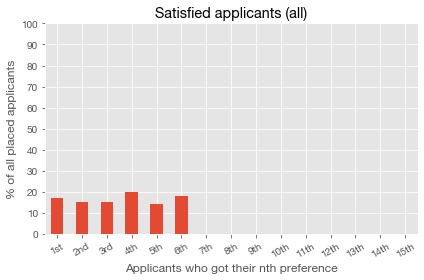

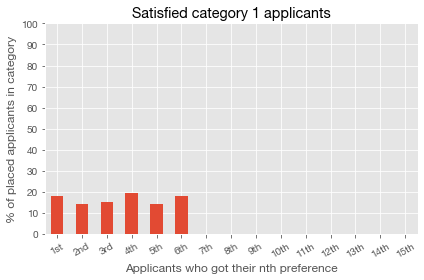

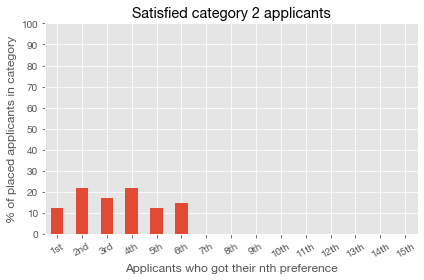

,Average unhappiness
strategy,
random with weighted random top,0.000000
stack,2.600000
variant stack,2.043478


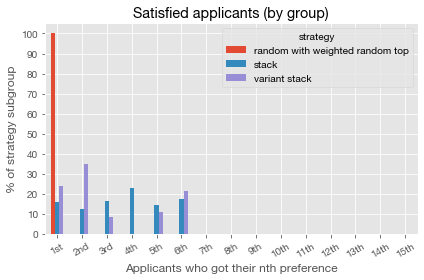

,random with weighted random top,stack,variant stack
Got first preference,100.00%,16.07%,23.91%
Did not get first preference,0.00%,83.93%,76.09%


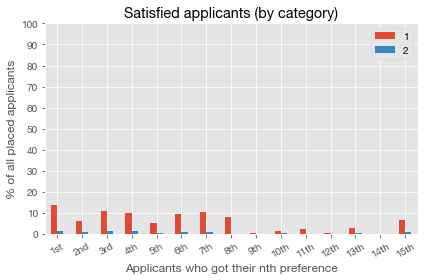

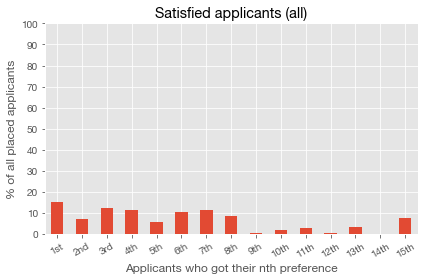

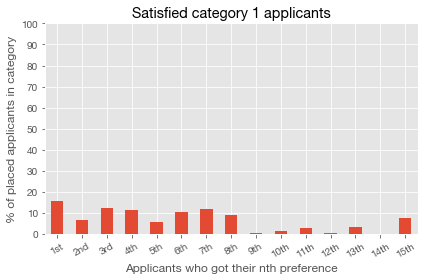

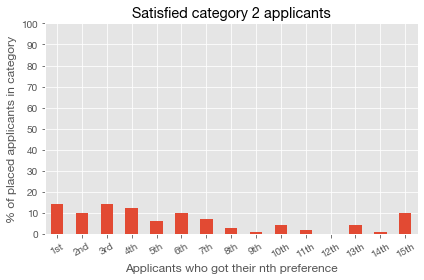

,Average unhappiness
strategy,
random with weighted random top,2.173913
stack,5.953074
variant stack,3.295918


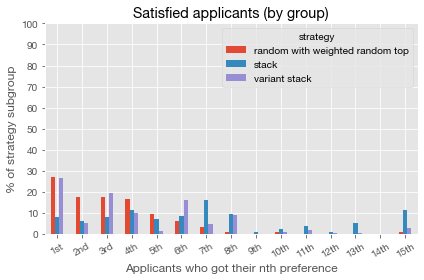

,random with weighted random top,stack,variant stack
Got first preference,26.96%,7.93%,26.87%
Did not get first preference,73.04%,92.07%,73.13%


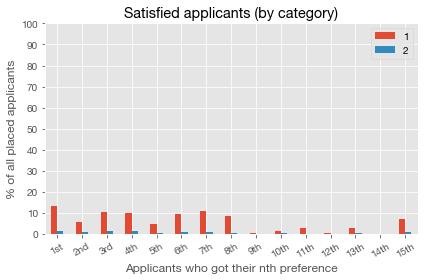

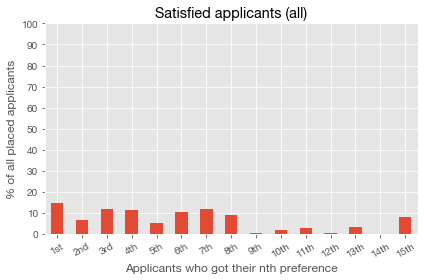

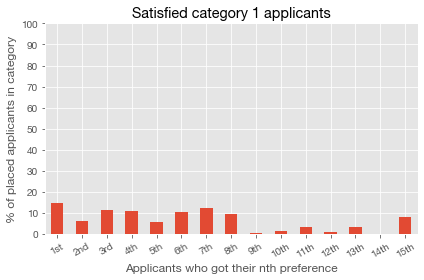

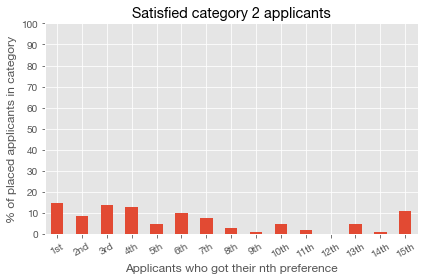

,Average unhappiness
strategy,
random with weighted random top,1.615385
stack,5.953074
variant stack,3.295918


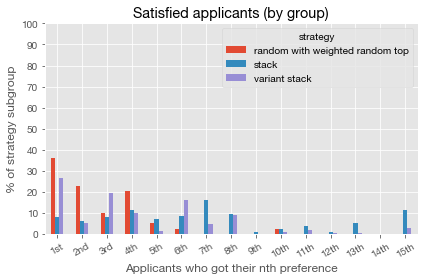

,random with weighted random top,stack,variant stack
Got first preference,35.90%,7.93%,26.87%
Did not get first preference,64.10%,92.07%,73.13%


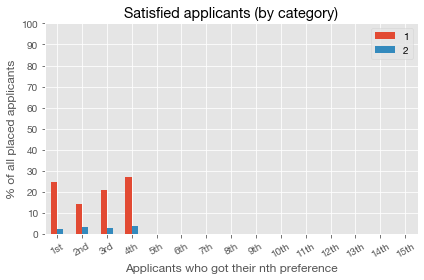

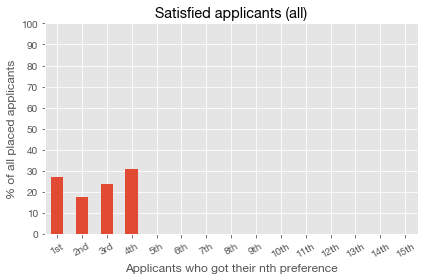

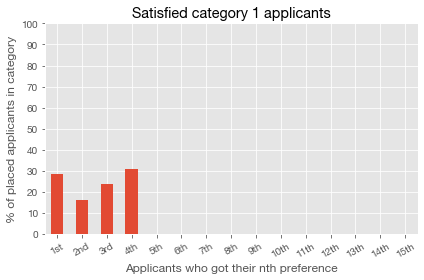

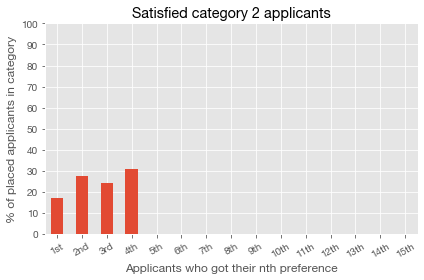

,Average unhappiness
strategy,
random with weighted random top,0.000000
stack,1.681159
variant stack,0.588235


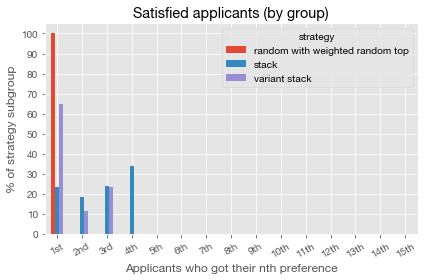

,random with weighted random top,stack,variant stack
Got first preference,100.00%,23.67%,64.71%
Did not get first preference,0.00%,76.33%,35.29%


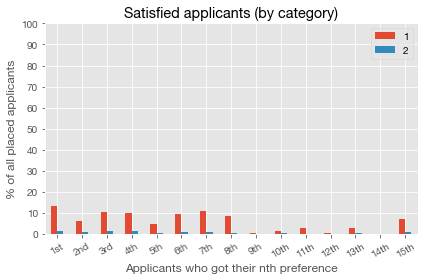

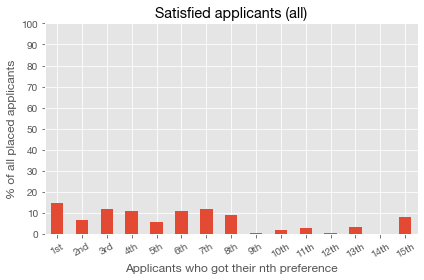

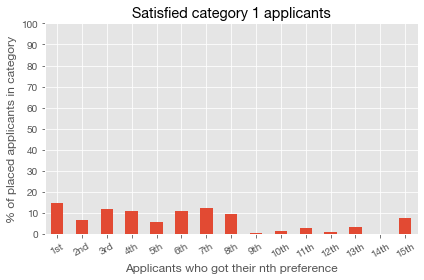

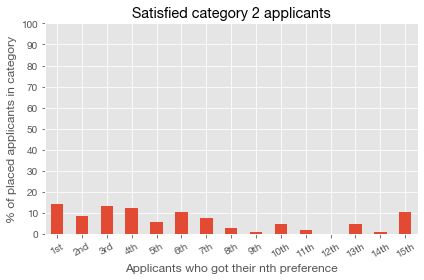

,Average unhappiness
strategy,
random with weighted random top,2.072727
stack,5.953074
variant stack,3.295918


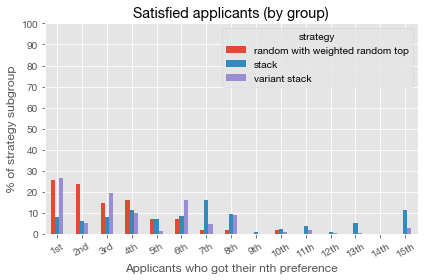

,random with weighted random top,stack,variant stack
Got first preference,25.45%,7.93%,26.87%
Did not get first preference,74.55%,92.07%,73.13%


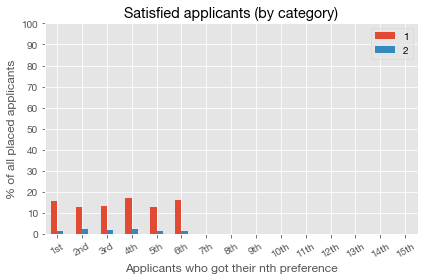

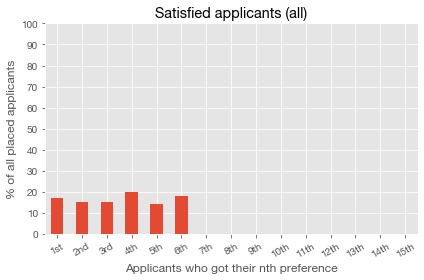

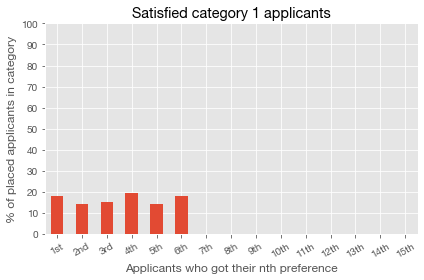

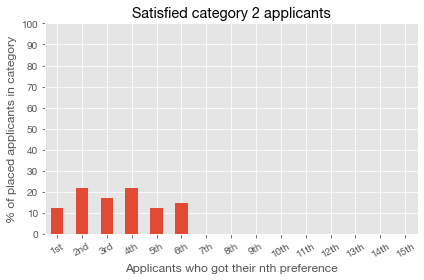

,Average unhappiness
strategy,
random with weighted random top,0.000000
stack,2.600000
variant stack,2.043478


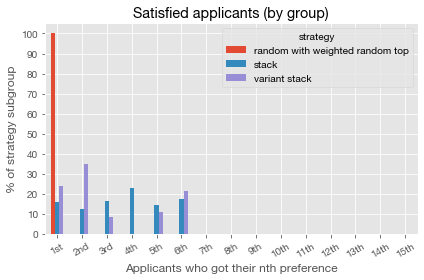

,random with weighted random top,stack,variant stack
Got first preference,100.00%,16.07%,23.91%
Did not get first preference,0.00%,83.93%,76.09%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,2.173913
variant stack+stack,5.096491


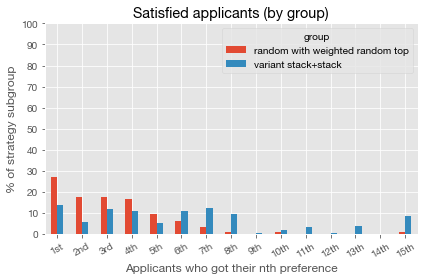

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack+stack
Got first preference,26.96%,14.04%
Did not get first preference,73.04%,85.96%


,Average unhappiness
group,
random with weighted random top,1.615385
variant stack+stack,5.096491


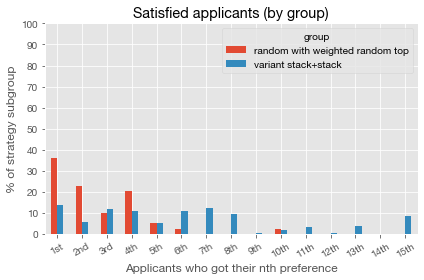

,random with weighted random top,variant stack+stack
Got first preference,35.90%,14.04%
Did not get first preference,64.10%,85.96%


,Average unhappiness
group,
random with weighted random top,0.000000
variant stack+stack,1.598214


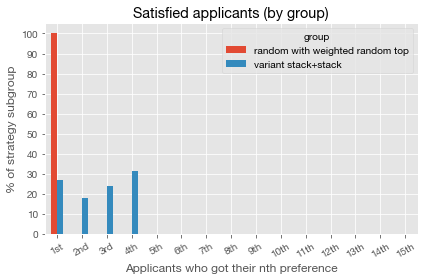

,random with weighted random top,variant stack+stack
Got first preference,100.00%,26.79%
Did not get first preference,0.00%,73.21%


,Average unhappiness
group,
random with weighted random top,2.072727
variant stack+stack,5.096491


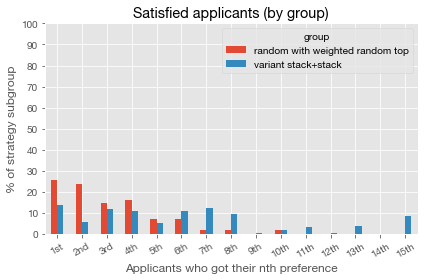

,random with weighted random top,variant stack+stack
Got first preference,25.45%,14.04%
Did not get first preference,74.55%,85.96%


,Average unhappiness
group,
random with weighted random top,0.000000
variant stack+stack,2.527066


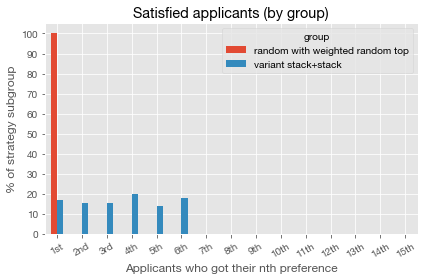

,random with weighted random top,variant stack+stack
Got first preference,100.00%,17.09%
Did not get first preference,0.00%,82.91%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,2.173913
variant stack+stack,5.096491


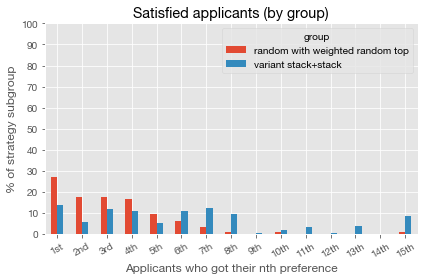

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack+stack
Got first preference,26.96%,14.04%
Did not get first preference,73.04%,85.96%


,Average unhappiness
group,
random with weighted random top,1.615385
variant stack+stack,5.096491


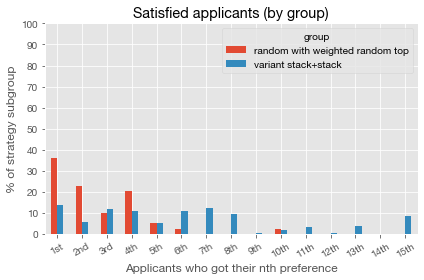

,random with weighted random top,variant stack+stack
Got first preference,35.90%,14.04%
Did not get first preference,64.10%,85.96%


,Average unhappiness
group,
random with weighted random top,0.000000
variant stack+stack,1.598214


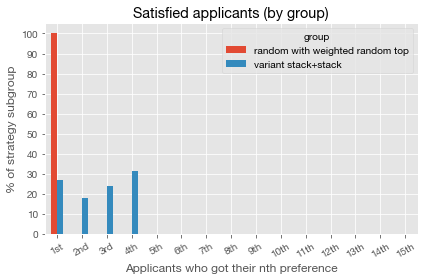

,random with weighted random top,variant stack+stack
Got first preference,100.00%,26.79%
Did not get first preference,0.00%,73.21%


,Average unhappiness
group,
random with weighted random top,2.072727
variant stack+stack,5.096491


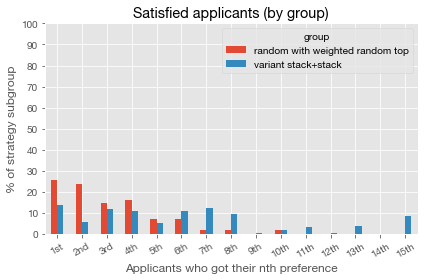

,random with weighted random top,variant stack+stack
Got first preference,25.45%,14.04%
Did not get first preference,74.55%,85.96%


,Average unhappiness
group,
random with weighted random top,0.000000
variant stack+stack,2.527066


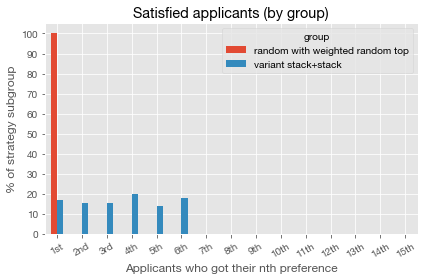

,random with weighted random top,variant stack+stack
Got first preference,100.00%,17.09%
Did not get first preference,0.00%,82.91%


In [16]:
sim = create_and_run_sim([
    ("random with weighted random top", 0.1),
    ("variant stack", 0.3),
    ("stack", 0.6)
])

compare_two_groups_all_conditions(sim, ["random with weighted random top", ["variant stack", "stack"]])

#### 15% random with weighted random top, 30% mixed stacks with weighted random top, 55% default stack with weighted random top

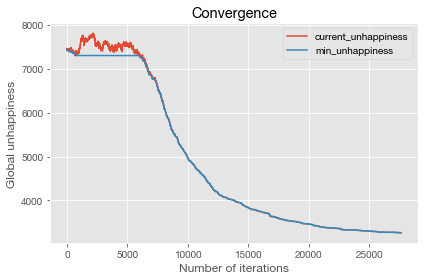

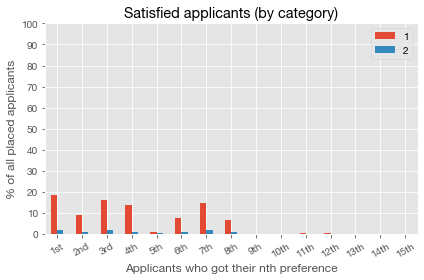

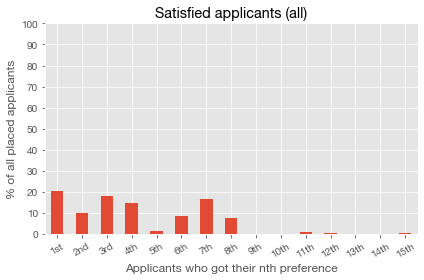

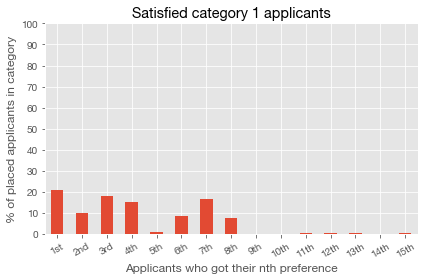

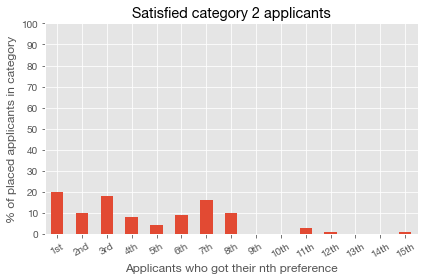

,Average unhappiness
strategy,
random with weighted random top,1.746914
stack with weighted random top,3.507018
variant stack with weighted random top,3.311864


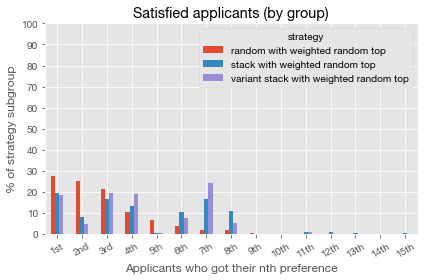

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,27.78%,19.65%,18.64%
Did not get first preference,72.22%,80.35%,81.36%


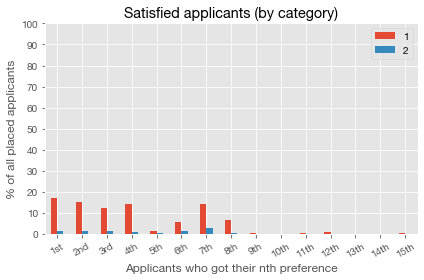

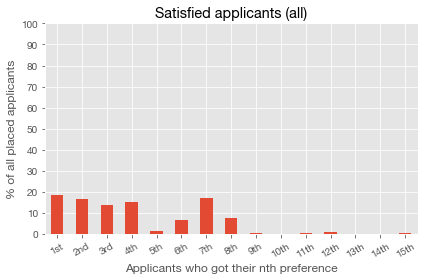

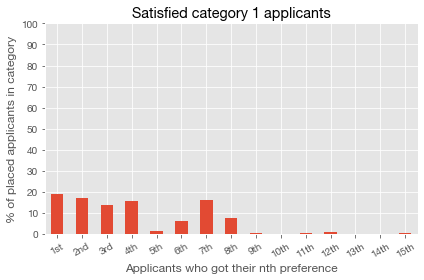

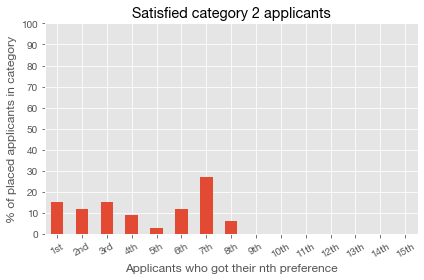

,Average unhappiness
strategy,
random with weighted random top,1.745763
stack with weighted random top,3.432749
variant stack with weighted random top,3.471264


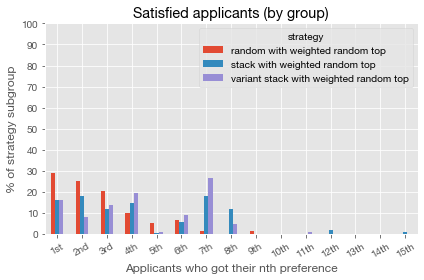

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,28.81%,16.37%,16.09%
Did not get first preference,71.19%,83.63%,83.91%


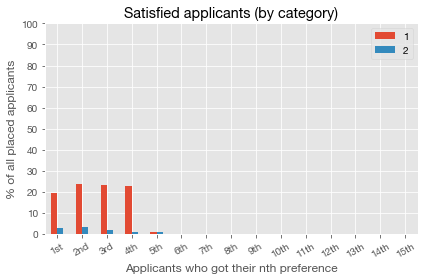

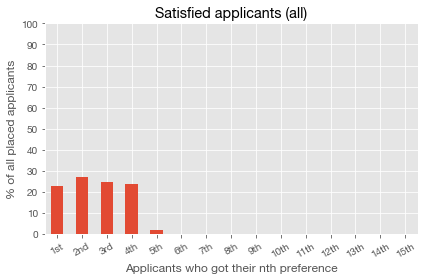

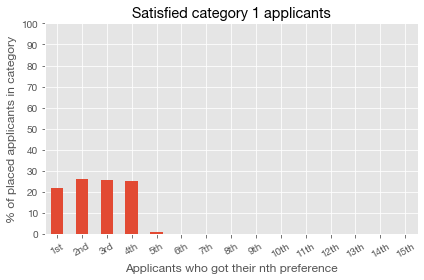

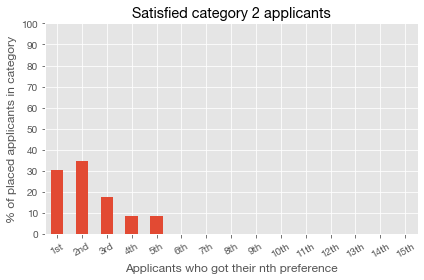

,Average unhappiness
strategy,
random with weighted random top,1.000000
stack with weighted random top,1.809524
variant stack with weighted random top,1.056338


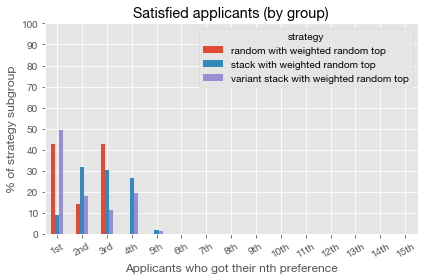

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,42.86%,8.84%,49.30%
Did not get first preference,57.14%,91.16%,50.70%


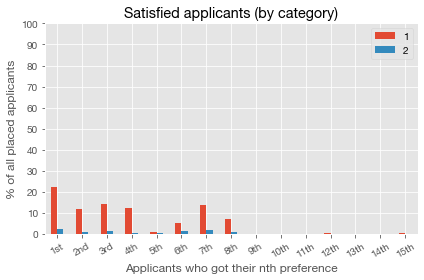

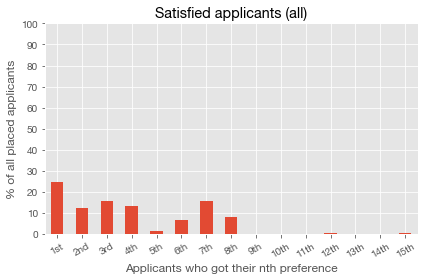

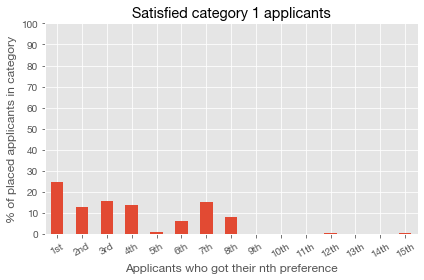

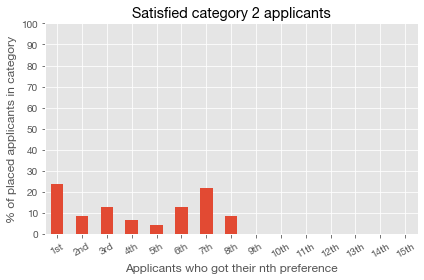

,Average unhappiness
strategy,
random with weighted random top,1.923077
stack with weighted random top,3.138340
variant stack with weighted random top,3.192308


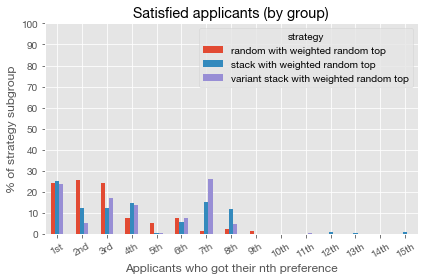

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,24.36%,25.30%,23.85%
Did not get first preference,75.64%,74.70%,76.15%


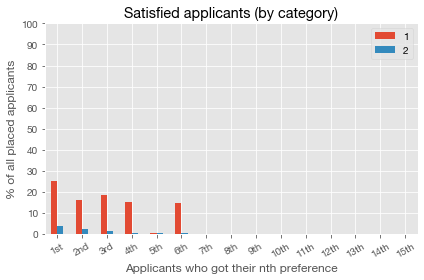

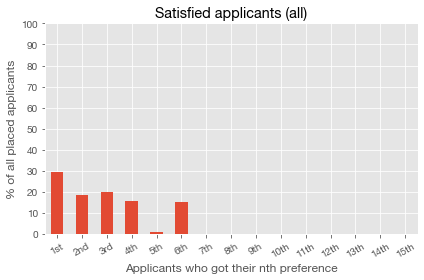

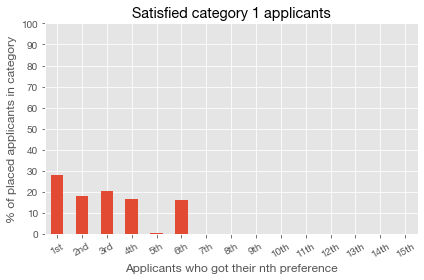

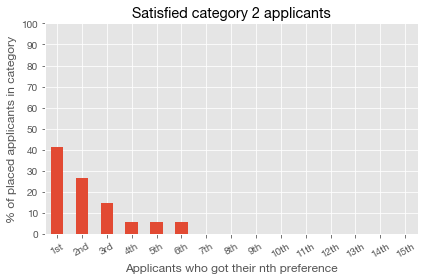

,Average unhappiness
strategy,
random with weighted random top,0.611111
stack with weighted random top,2.228216
variant stack with weighted random top,1.172043


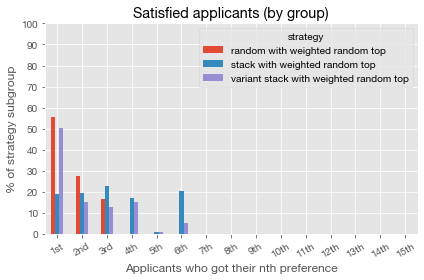

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,55.56%,19.09%,50.54%
Did not get first preference,44.44%,80.91%,49.46%


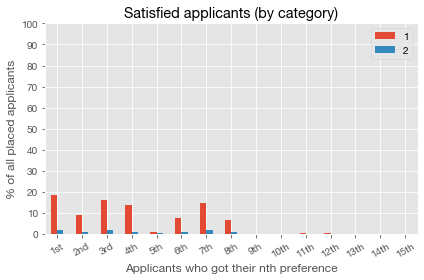

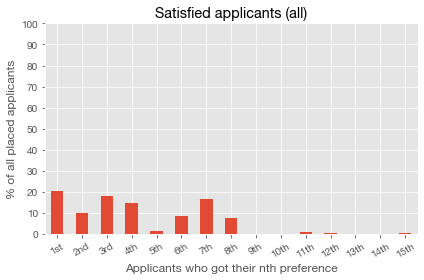

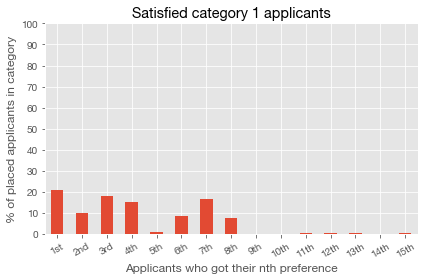

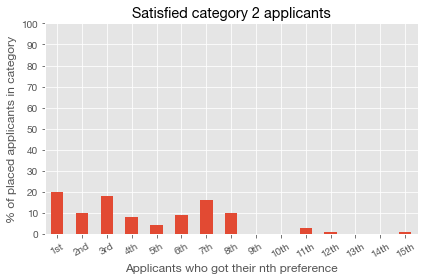

,Average unhappiness
strategy,
random with weighted random top,1.746914
stack with weighted random top,3.507018
variant stack with weighted random top,3.311864


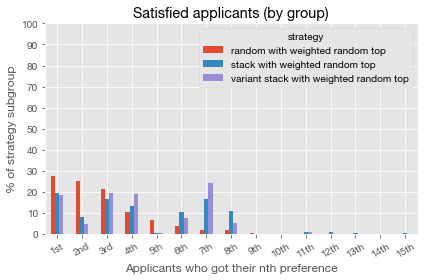

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,27.78%,19.65%,18.64%
Did not get first preference,72.22%,80.35%,81.36%


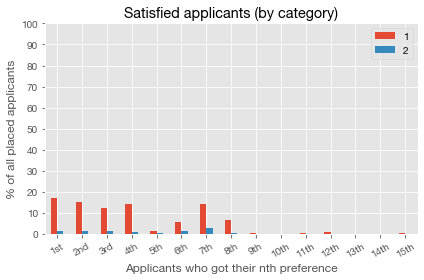

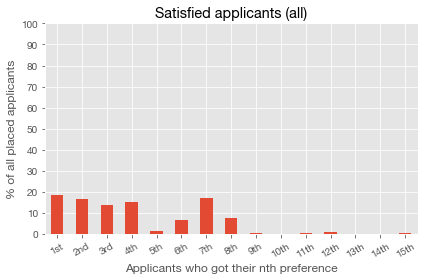

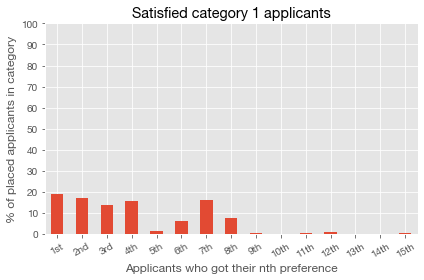

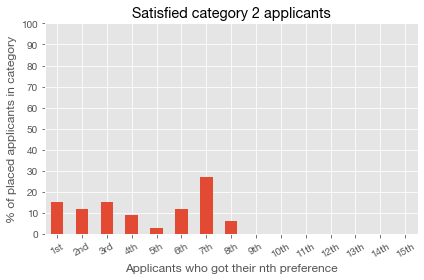

,Average unhappiness
strategy,
random with weighted random top,1.745763
stack with weighted random top,3.432749
variant stack with weighted random top,3.471264


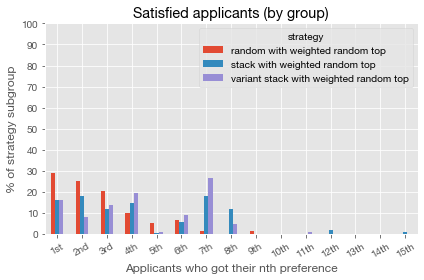

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,28.81%,16.37%,16.09%
Did not get first preference,71.19%,83.63%,83.91%


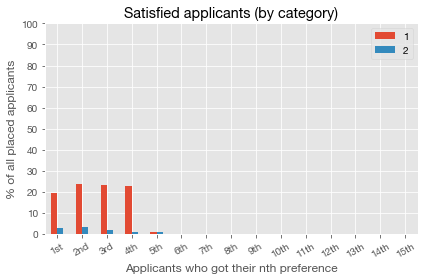

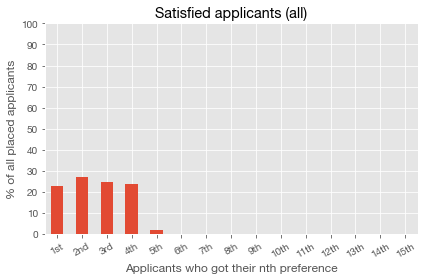

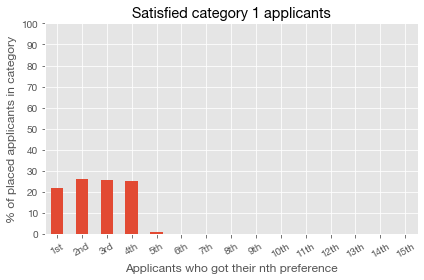

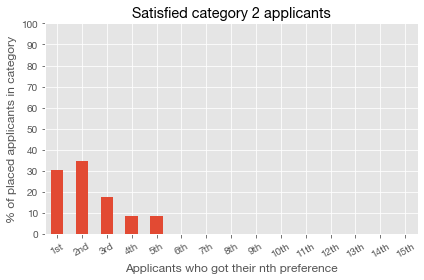

,Average unhappiness
strategy,
random with weighted random top,1.000000
stack with weighted random top,1.809524
variant stack with weighted random top,1.056338


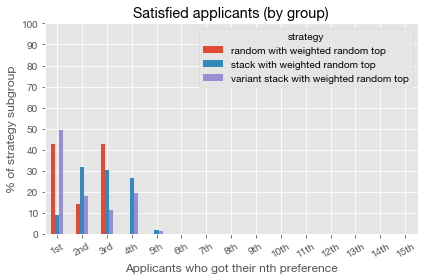

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,42.86%,8.84%,49.30%
Did not get first preference,57.14%,91.16%,50.70%


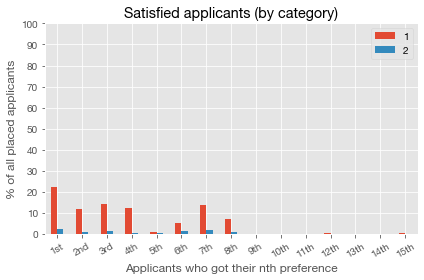

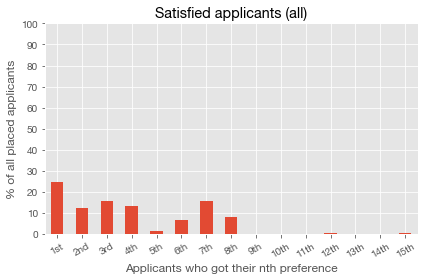

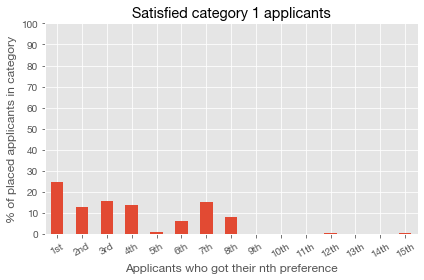

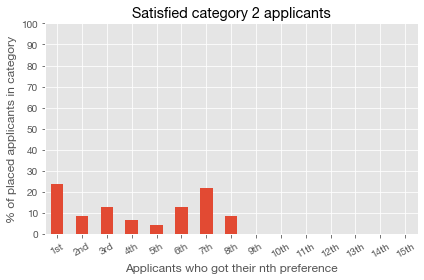

,Average unhappiness
strategy,
random with weighted random top,1.923077
stack with weighted random top,3.138340
variant stack with weighted random top,3.192308


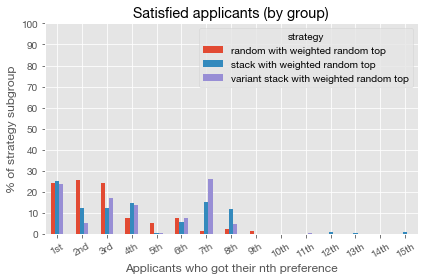

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,24.36%,25.30%,23.85%
Did not get first preference,75.64%,74.70%,76.15%


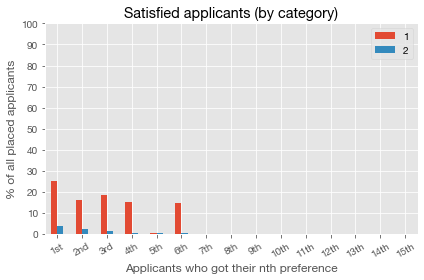

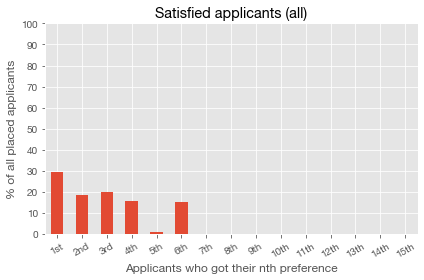

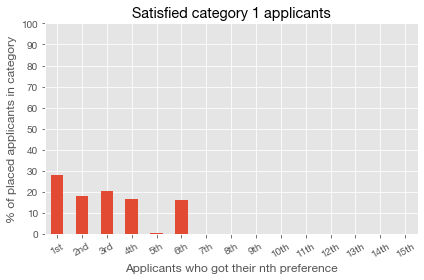

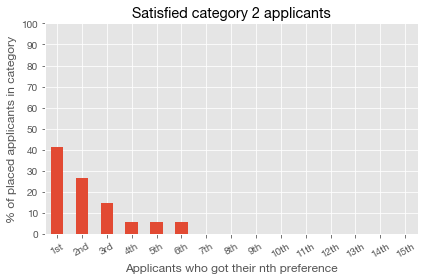

,Average unhappiness
strategy,
random with weighted random top,0.611111
stack with weighted random top,2.228216
variant stack with weighted random top,1.172043


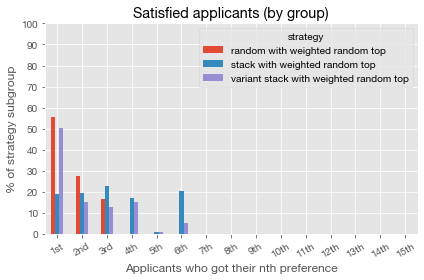

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,55.56%,19.09%,50.54%
Did not get first preference,44.44%,80.91%,49.46%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,1.746914
variant stack with weighted random top+stack with weighted random top,3.440462


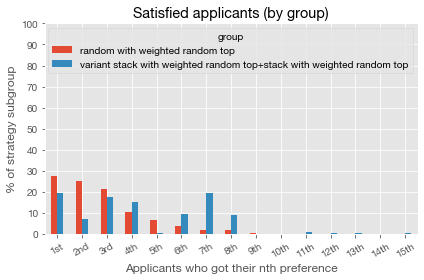

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,27.78%,19.31%
Did not get first preference,72.22%,80.69%


,Average unhappiness
group,
random with weighted random top,1.745763
variant stack with weighted random top+stack with weighted random top,3.445736


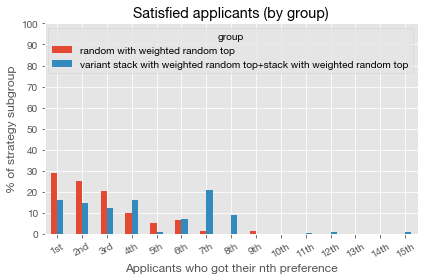

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,28.81%,16.28%
Did not get first preference,71.19%,83.72%


,Average unhappiness
group,
random with weighted random top,1.00000
variant stack with weighted random top+stack with weighted random top,1.56422


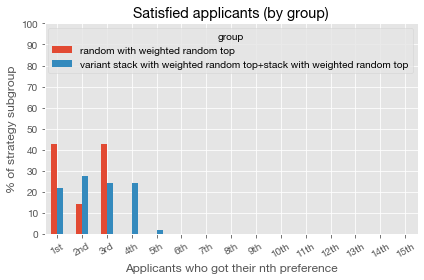

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,42.86%,22.02%
Did not get first preference,57.14%,77.98%


,Average unhappiness
group,
random with weighted random top,1.923077
variant stack with weighted random top+stack with weighted random top,3.156658


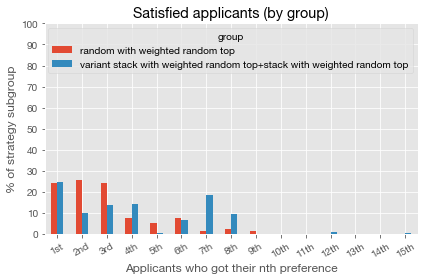

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,24.36%,24.80%
Did not get first preference,75.64%,75.20%


,Average unhappiness
group,
random with weighted random top,0.611111
variant stack with weighted random top+stack with weighted random top,1.934132


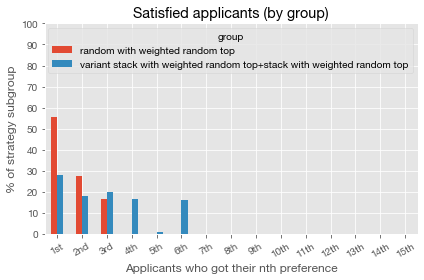

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,55.56%,27.84%
Did not get first preference,44.44%,72.16%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,1.746914
variant stack with weighted random top+stack with weighted random top,3.440462


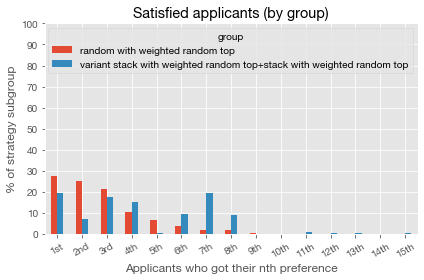

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,27.78%,19.31%
Did not get first preference,72.22%,80.69%


,Average unhappiness
group,
random with weighted random top,1.745763
variant stack with weighted random top+stack with weighted random top,3.445736


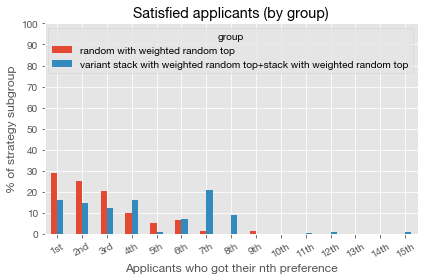

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,28.81%,16.28%
Did not get first preference,71.19%,83.72%


,Average unhappiness
group,
random with weighted random top,1.00000
variant stack with weighted random top+stack with weighted random top,1.56422


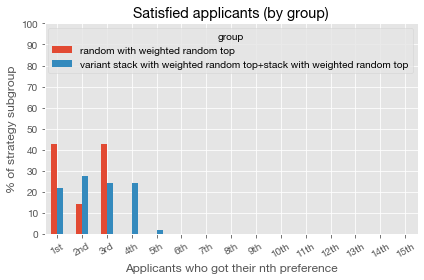

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,42.86%,22.02%
Did not get first preference,57.14%,77.98%


,Average unhappiness
group,
random with weighted random top,1.923077
variant stack with weighted random top+stack with weighted random top,3.156658


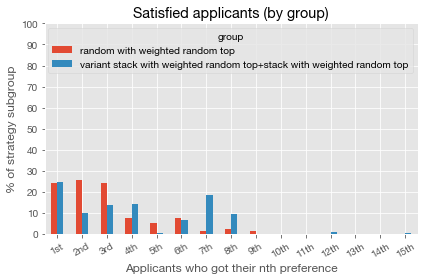

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,24.36%,24.80%
Did not get first preference,75.64%,75.20%


,Average unhappiness
group,
random with weighted random top,0.611111
variant stack with weighted random top+stack with weighted random top,1.934132


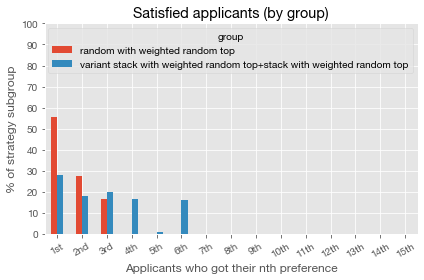

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,55.56%,27.84%
Did not get first preference,44.44%,72.16%


In [17]:
sim = create_and_run_sim([
    ("random with weighted random top", 0.15),
    ("variant stack with weighted random top", 0.3),
    ("stack with weighted random top", 0.55)
])

compare_two_groups_all_conditions(sim, ["random with weighted random top",
    ["variant stack with weighted random top", "stack with weighted random top"]])

#### 20% random with weighted random top, 25% mixed stacks with weighted random top, 55% default stack with weighted random top

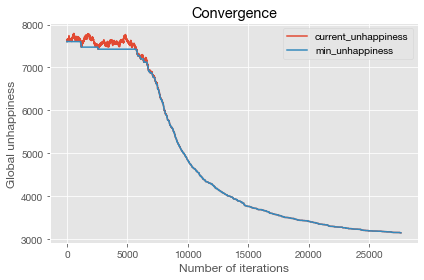

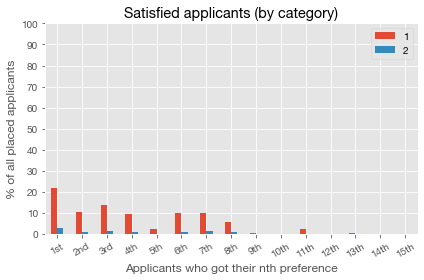

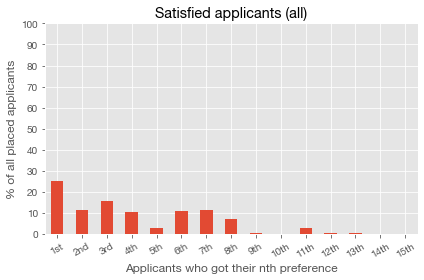

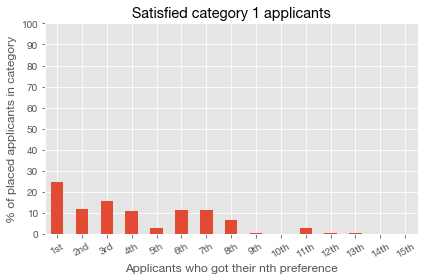

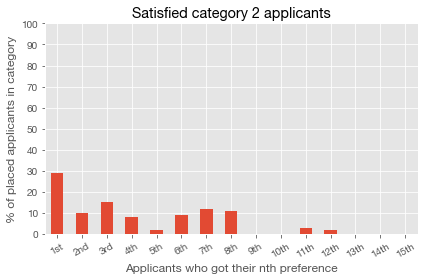

,Average unhappiness
strategy,
random with weighted random top,2.051064
stack with weighted random top,3.385768
variant stack with weighted random top,3.344961


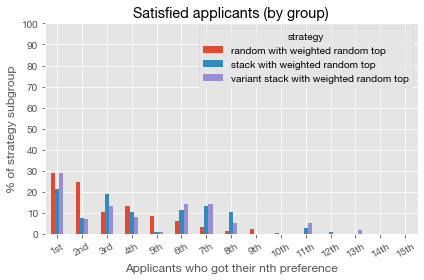

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,28.94%,21.54%,29.07%
Did not get first preference,71.06%,78.46%,70.93%


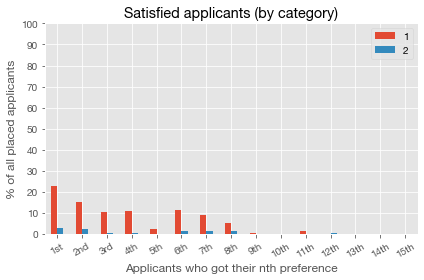

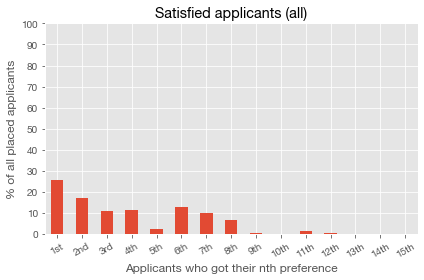

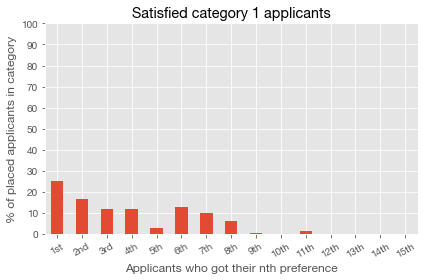

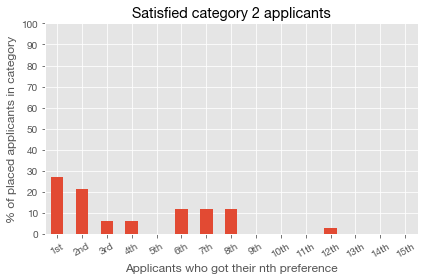

,Average unhappiness
strategy,
random with weighted random top,2.038961
stack with weighted random top,2.981818
variant stack with weighted random top,3.112676


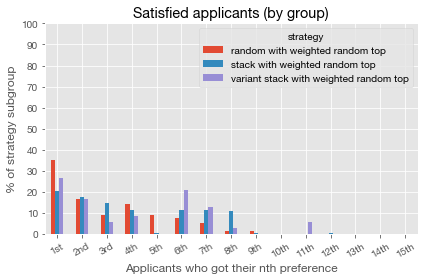

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,35.06%,20.61%,26.76%
Did not get first preference,64.94%,79.39%,73.24%


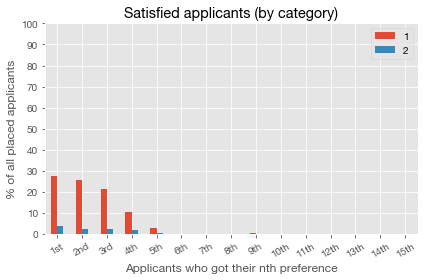

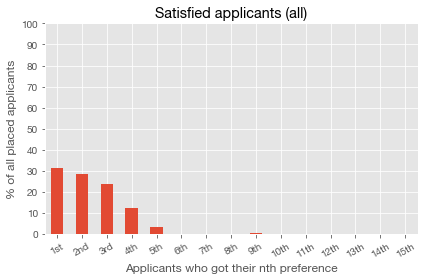

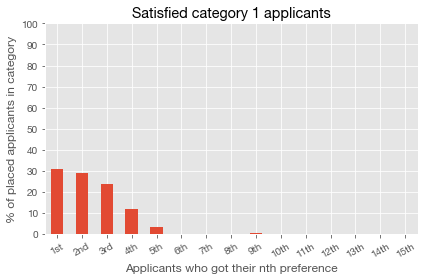

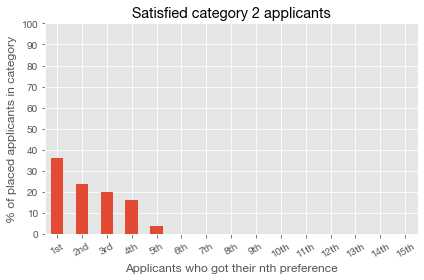

,Average unhappiness
strategy,
random with weighted random top,0.666667
stack with weighted random top,1.701493
variant stack with weighted random top,0.729412


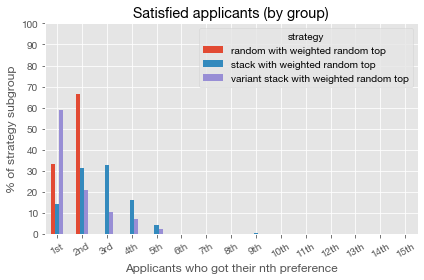

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,33.33%,14.18%,58.82%
Did not get first preference,66.67%,85.82%,41.18%


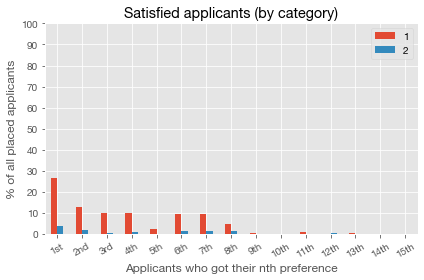

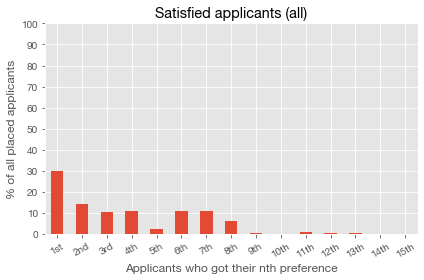

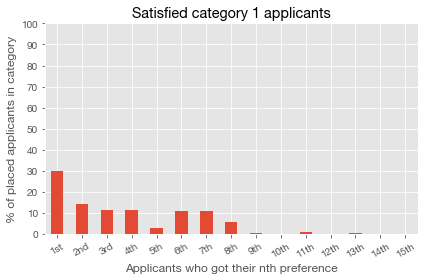

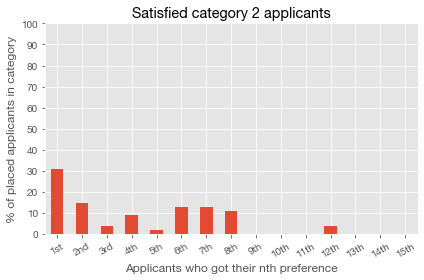

,Average unhappiness
strategy,
random with weighted random top,2.187500
stack with weighted random top,2.863248
variant stack with weighted random top,2.906780


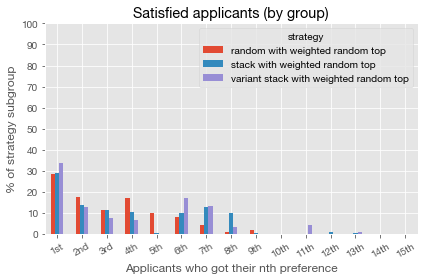

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,28.57%,29.06%,33.90%
Did not get first preference,71.43%,70.94%,66.10%


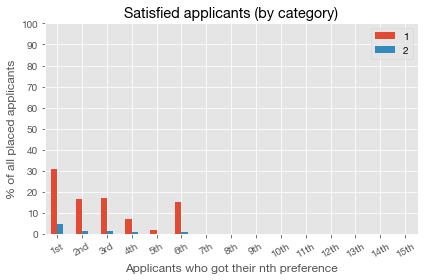

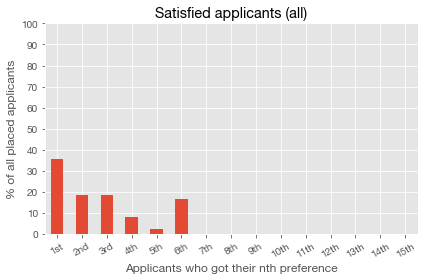

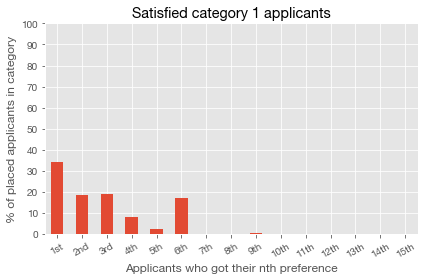

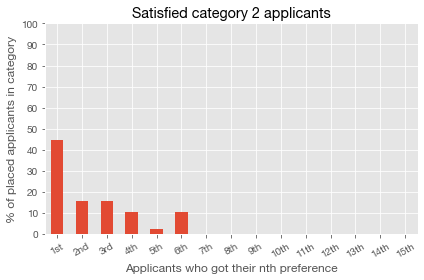

,Average unhappiness
strategy,
random with weighted random top,0.500000
stack with weighted random top,2.282609
variant stack with weighted random top,0.759259


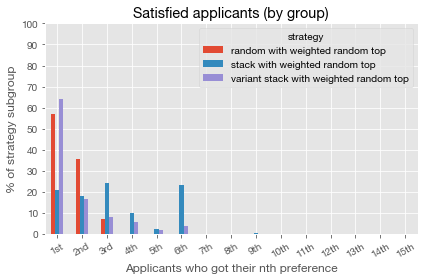

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,57.14%,20.87%,63.89%
Did not get first preference,42.86%,79.13%,36.11%


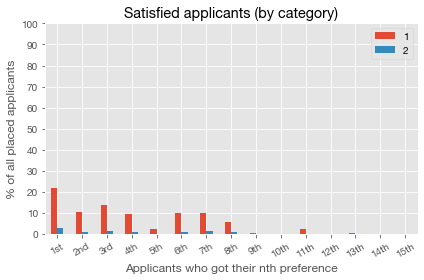

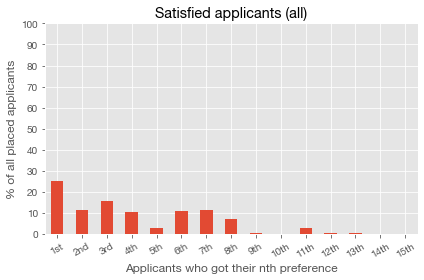

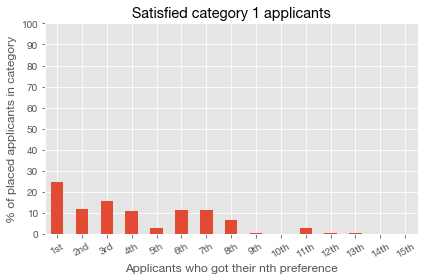

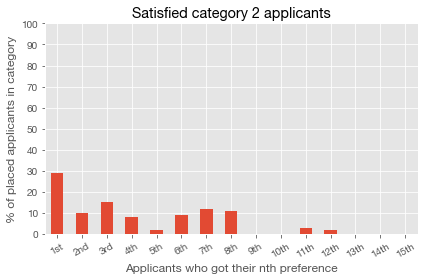

,Average unhappiness
strategy,
random with weighted random top,2.051064
stack with weighted random top,3.385768
variant stack with weighted random top,3.344961


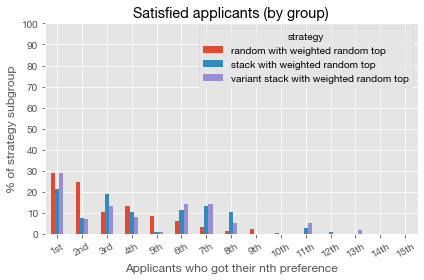

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,28.94%,21.54%,29.07%
Did not get first preference,71.06%,78.46%,70.93%


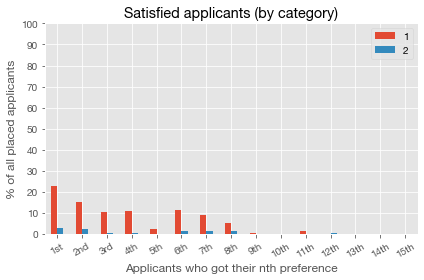

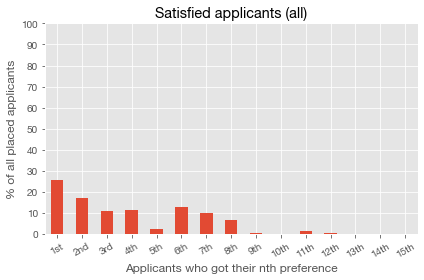

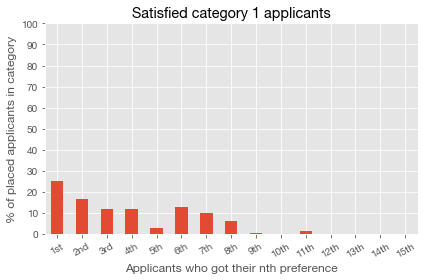

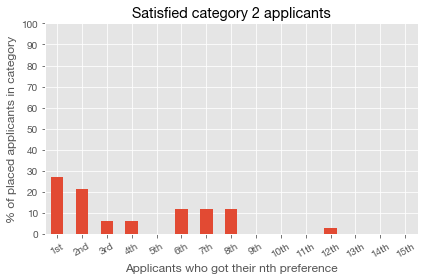

,Average unhappiness
strategy,
random with weighted random top,2.038961
stack with weighted random top,2.981818
variant stack with weighted random top,3.112676


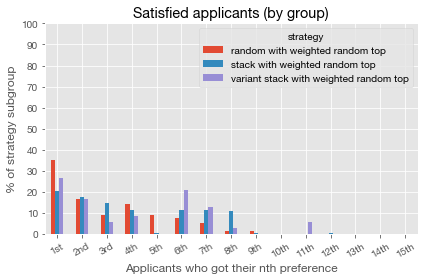

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,35.06%,20.61%,26.76%
Did not get first preference,64.94%,79.39%,73.24%


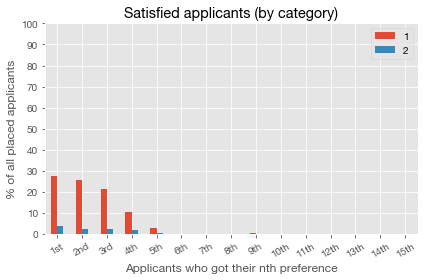

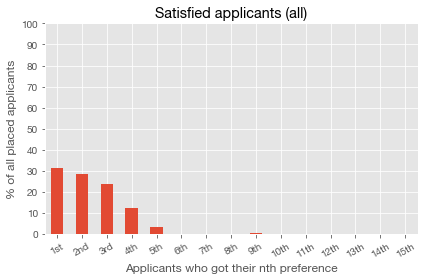

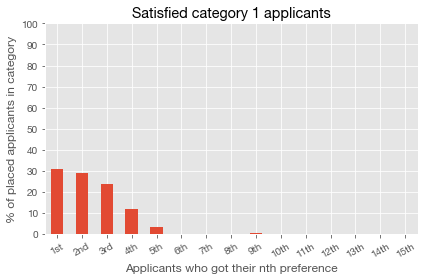

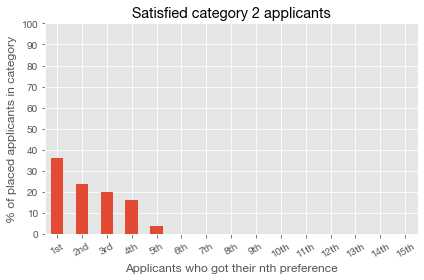

,Average unhappiness
strategy,
random with weighted random top,0.666667
stack with weighted random top,1.701493
variant stack with weighted random top,0.729412


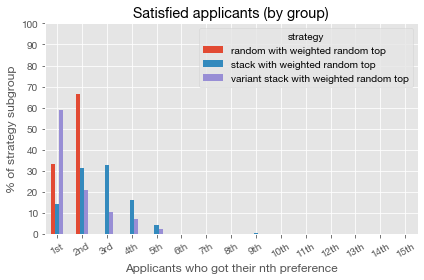

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,33.33%,14.18%,58.82%
Did not get first preference,66.67%,85.82%,41.18%


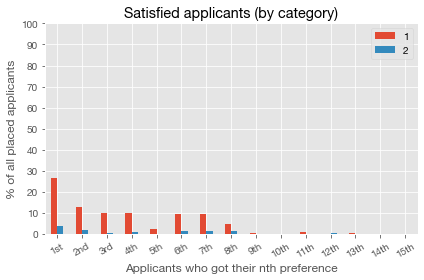

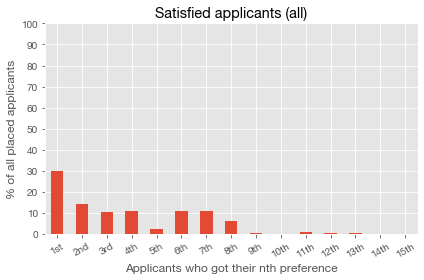

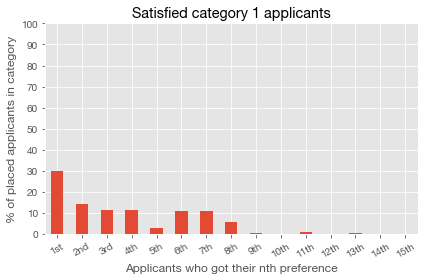

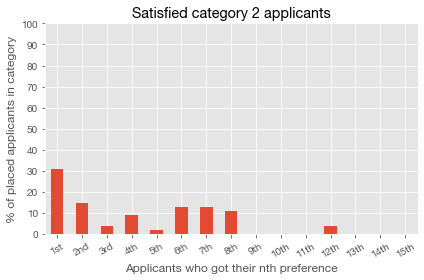

,Average unhappiness
strategy,
random with weighted random top,2.187500
stack with weighted random top,2.863248
variant stack with weighted random top,2.906780


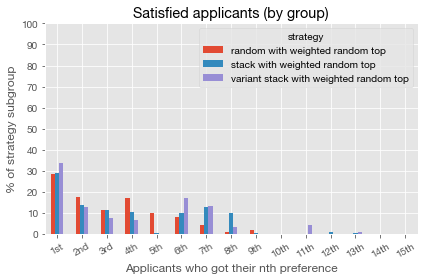

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,28.57%,29.06%,33.90%
Did not get first preference,71.43%,70.94%,66.10%


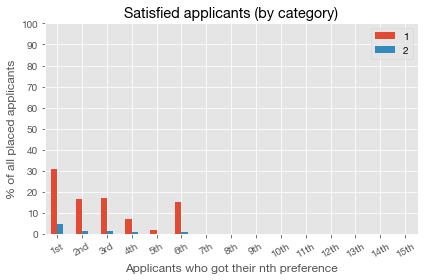

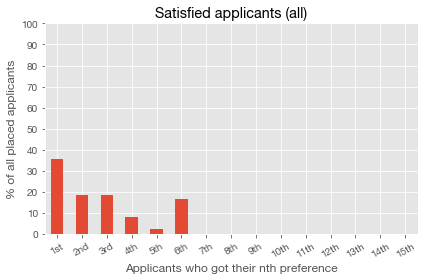

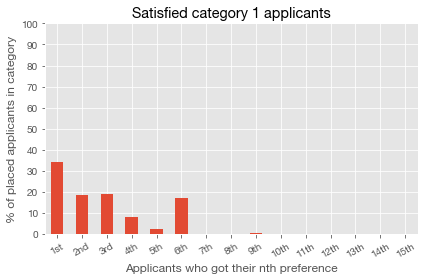

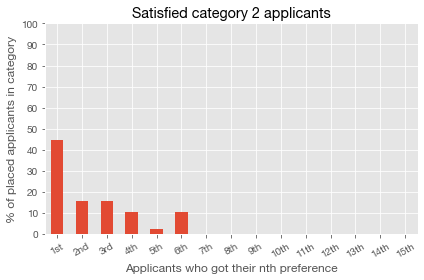

,Average unhappiness
strategy,
random with weighted random top,0.500000
stack with weighted random top,2.282609
variant stack with weighted random top,0.759259


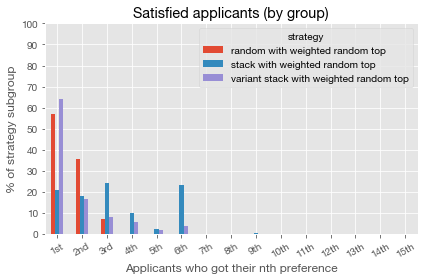

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,57.14%,20.87%,63.89%
Did not get first preference,42.86%,79.13%,36.11%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,2.051064
variant stack with weighted random top+stack with weighted random top,3.372475


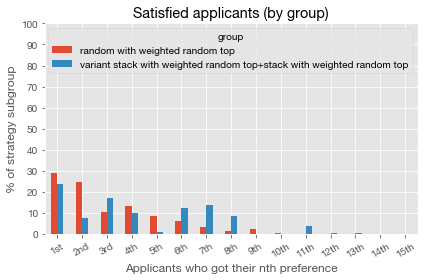

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,28.94%,23.99%
Did not get first preference,71.06%,76.01%


,Average unhappiness
group,
random with weighted random top,2.038961
variant stack with weighted random top+stack with weighted random top,3.021186


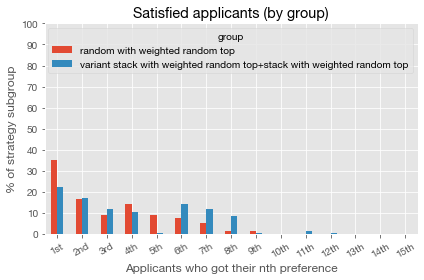

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,35.06%,22.46%
Did not get first preference,64.94%,77.54%


,Average unhappiness
group,
random with weighted random top,0.666667
variant stack with weighted random top+stack with weighted random top,1.324201


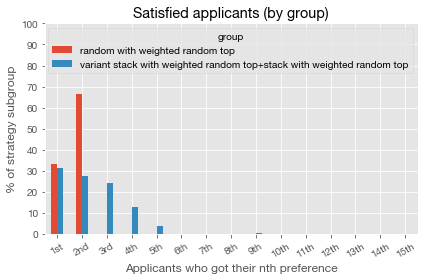

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,33.33%,31.51%
Did not get first preference,66.67%,68.49%


,Average unhappiness
group,
random with weighted random top,2.187500
variant stack with weighted random top+stack with weighted random top,2.877841


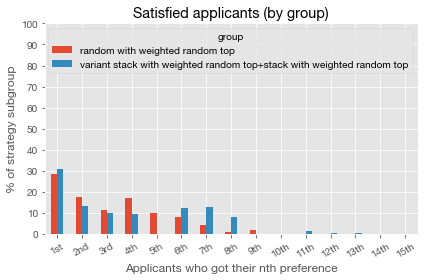

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,28.57%,30.68%
Did not get first preference,71.43%,69.32%


,Average unhappiness
group,
random with weighted random top,0.500000
variant stack with weighted random top+stack with weighted random top,1.795858


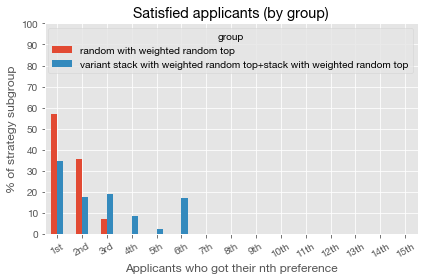

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,57.14%,34.62%
Did not get first preference,42.86%,65.38%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,2.051064
variant stack with weighted random top+stack with weighted random top,3.372475


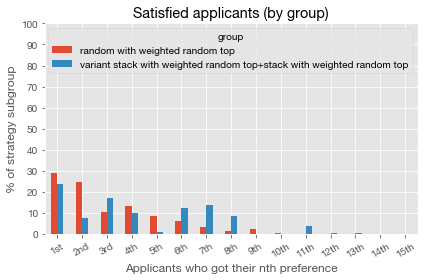

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,28.94%,23.99%
Did not get first preference,71.06%,76.01%


,Average unhappiness
group,
random with weighted random top,2.038961
variant stack with weighted random top+stack with weighted random top,3.021186


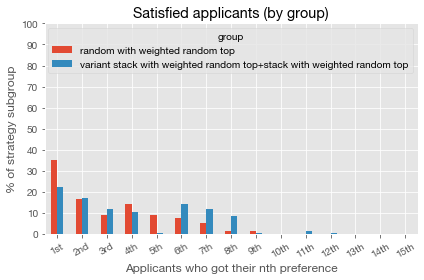

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,35.06%,22.46%
Did not get first preference,64.94%,77.54%


,Average unhappiness
group,
random with weighted random top,0.666667
variant stack with weighted random top+stack with weighted random top,1.324201


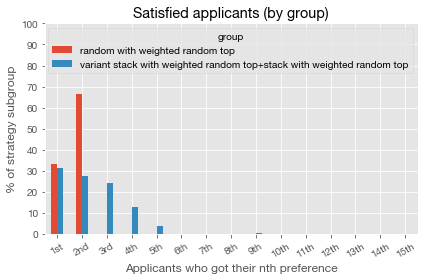

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,33.33%,31.51%
Did not get first preference,66.67%,68.49%


,Average unhappiness
group,
random with weighted random top,2.187500
variant stack with weighted random top+stack with weighted random top,2.877841


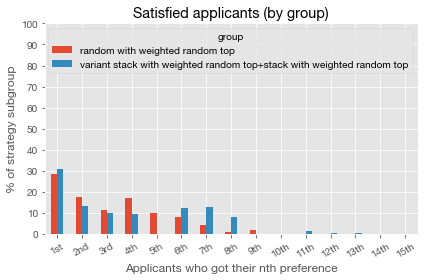

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,28.57%,30.68%
Did not get first preference,71.43%,69.32%


,Average unhappiness
group,
random with weighted random top,0.500000
variant stack with weighted random top+stack with weighted random top,1.795858


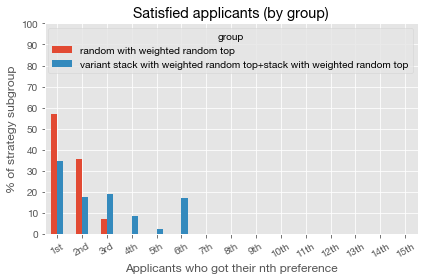

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,57.14%,34.62%
Did not get first preference,42.86%,65.38%


In [18]:
sim = create_and_run_sim([
    ("random with weighted random top", 0.2),
    ("variant stack with weighted random top", 0.25),
    ("stack with weighted random top", 0.55)
])

compare_two_groups_all_conditions(sim, ["random with weighted random top",
    ["variant stack with weighted random top", "stack with weighted random top"]])

#### 20% random with weighted random top, 50% mixed stacks with weighted random top, 30% default stack with weighted random top

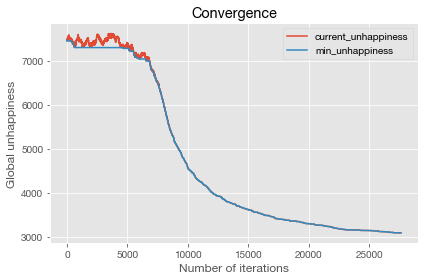

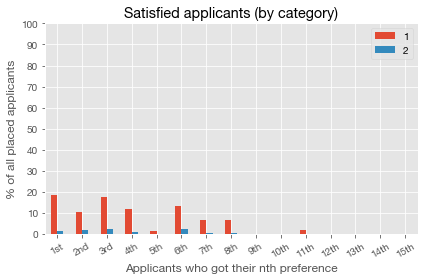

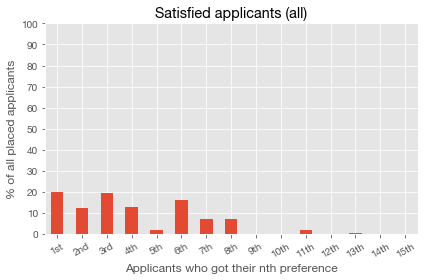

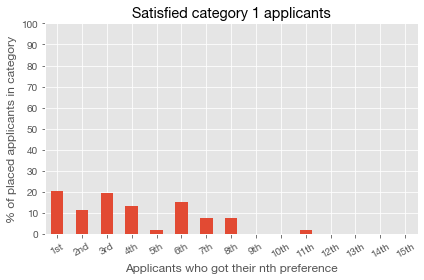

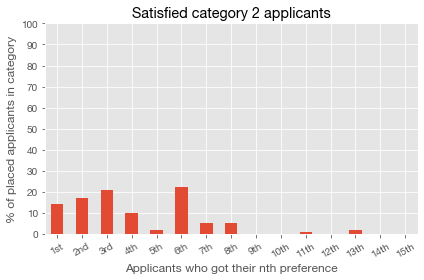

,Average unhappiness
strategy,
random with weighted random top,1.639024
stack with weighted random top,3.045307
variant stack with weighted random top,3.538012


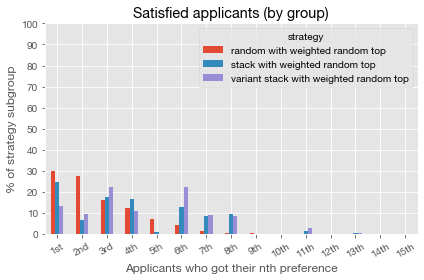

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,29.76%,24.60%,13.26%
Did not get first preference,70.24%,75.40%,86.74%


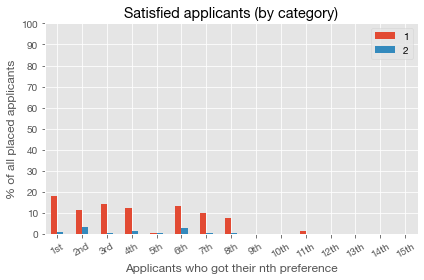

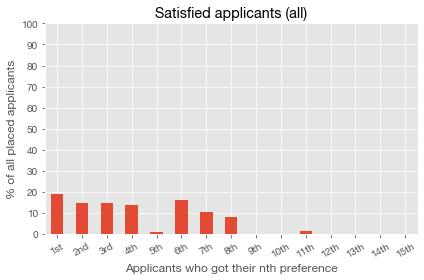

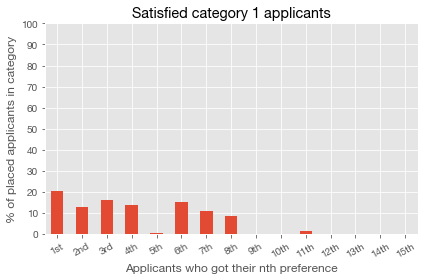

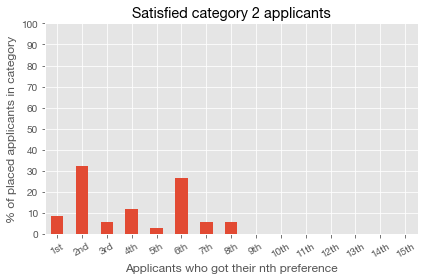

,Average unhappiness
strategy,
random with weighted random top,1.523810
stack with weighted random top,2.779070
variant stack with weighted random top,3.736842


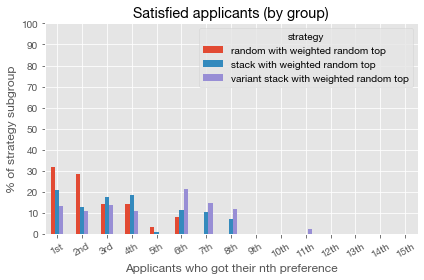

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,31.75%,20.93%,13.45%
Did not get first preference,68.25%,79.07%,86.55%


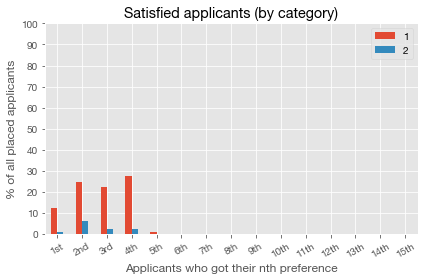

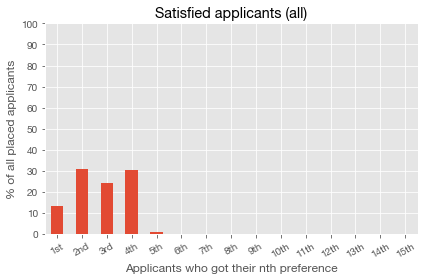

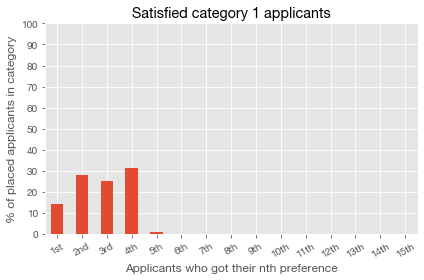

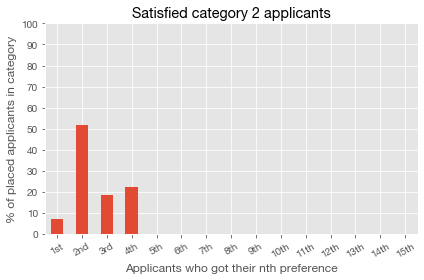

,Average unhappiness
strategy,
random with weighted random top,1.000000
stack with weighted random top,1.837209
variant stack with weighted random top,1.698529


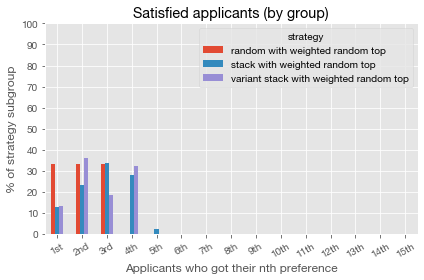

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,33.33%,12.79%,13.24%
Did not get first preference,66.67%,87.21%,86.76%


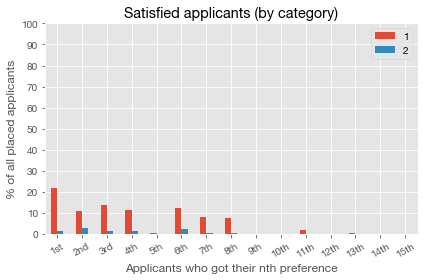

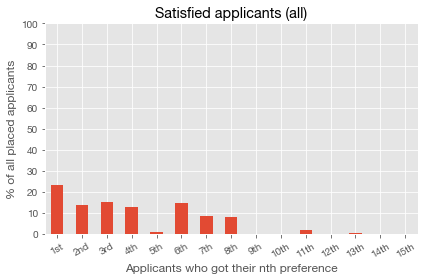

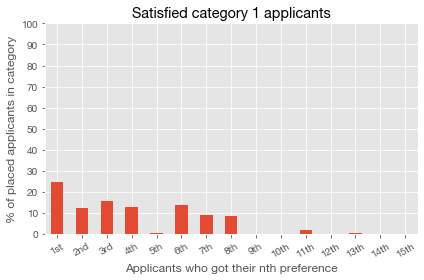

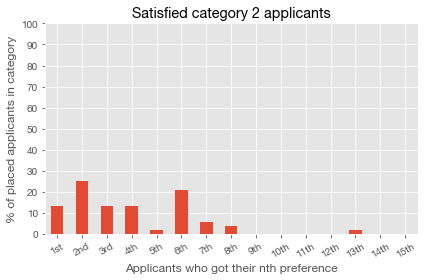

,Average unhappiness
strategy,
random with weighted random top,1.694737
stack with weighted random top,2.574627
variant stack with weighted random top,3.648305


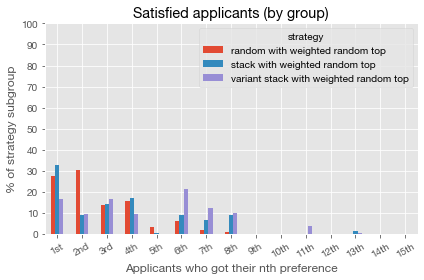

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,27.37%,32.84%,16.53%
Did not get first preference,72.63%,67.16%,83.47%


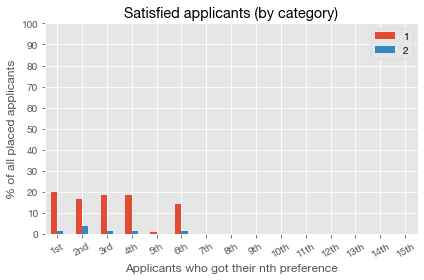

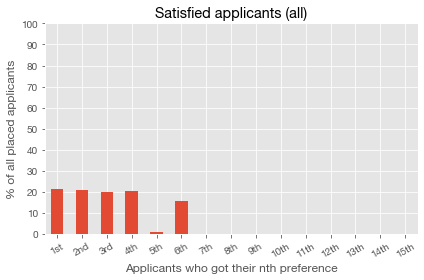

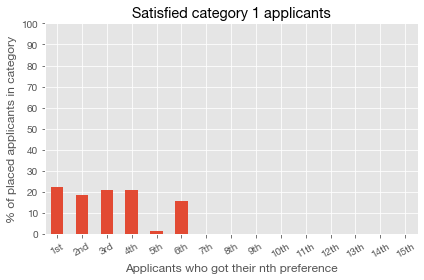

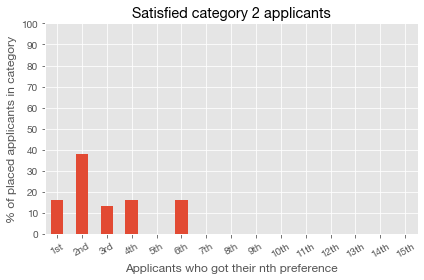

,Average unhappiness
strategy,
random with weighted random top,1.000000
stack with weighted random top,2.292994
variant stack with weighted random top,1.950276


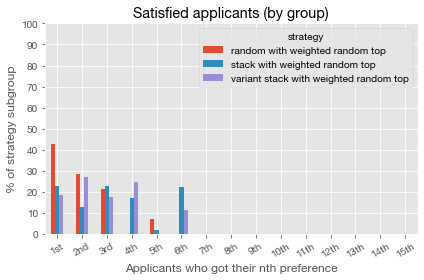

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,42.86%,22.93%,18.78%
Did not get first preference,57.14%,77.07%,81.22%


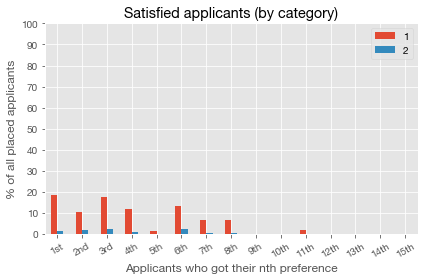

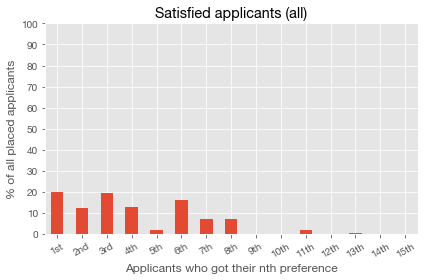

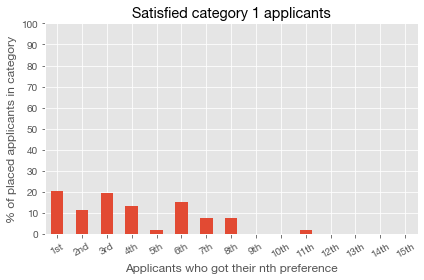

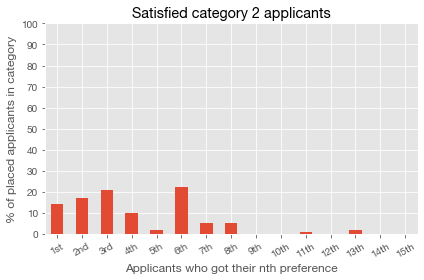

,Average unhappiness
strategy,
random with weighted random top,1.639024
stack with weighted random top,3.045307
variant stack with weighted random top,3.538012


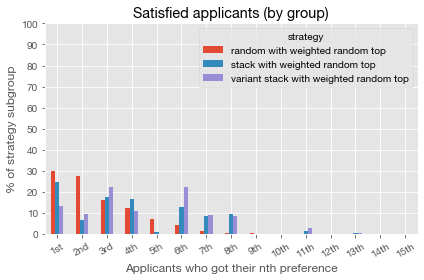

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,29.76%,24.60%,13.26%
Did not get first preference,70.24%,75.40%,86.74%


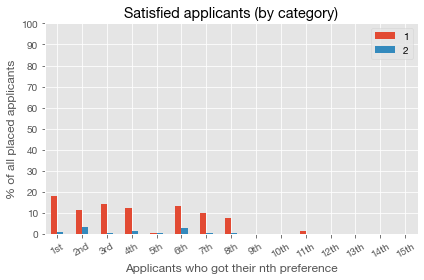

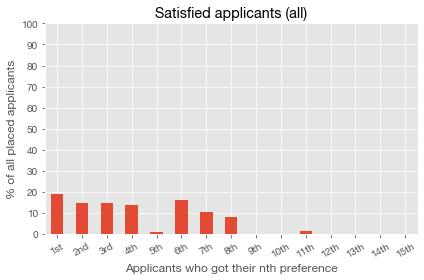

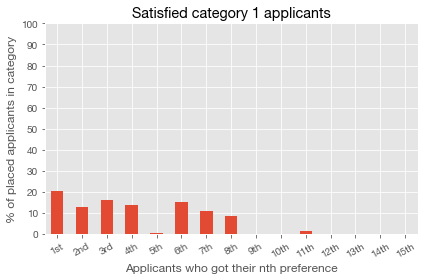

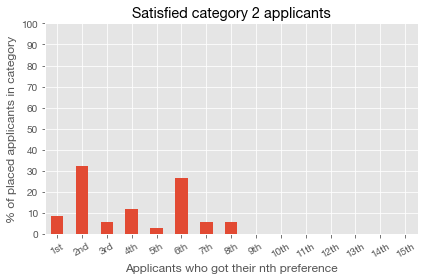

,Average unhappiness
strategy,
random with weighted random top,1.523810
stack with weighted random top,2.779070
variant stack with weighted random top,3.736842


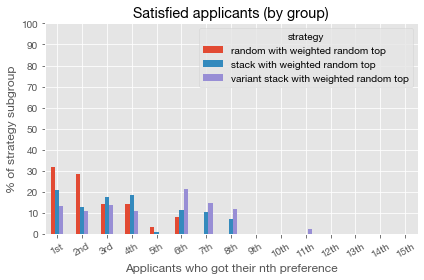

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,31.75%,20.93%,13.45%
Did not get first preference,68.25%,79.07%,86.55%


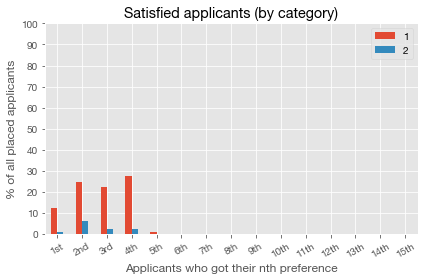

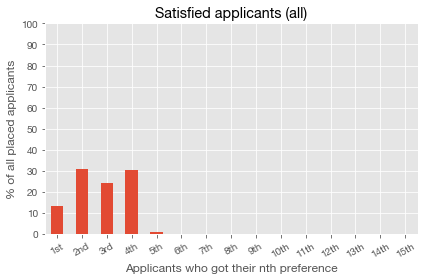

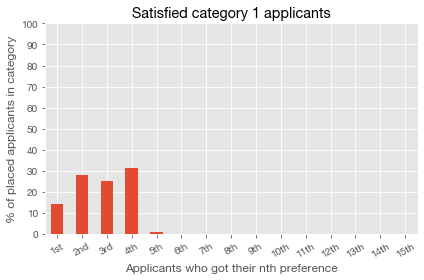

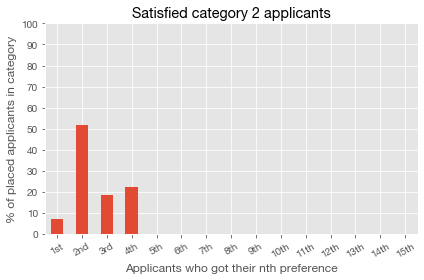

,Average unhappiness
strategy,
random with weighted random top,1.000000
stack with weighted random top,1.837209
variant stack with weighted random top,1.698529


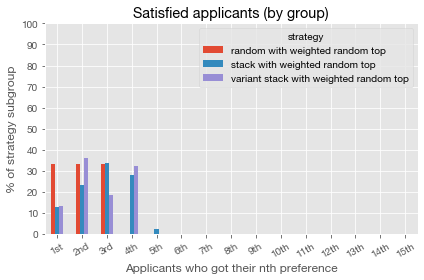

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,33.33%,12.79%,13.24%
Did not get first preference,66.67%,87.21%,86.76%


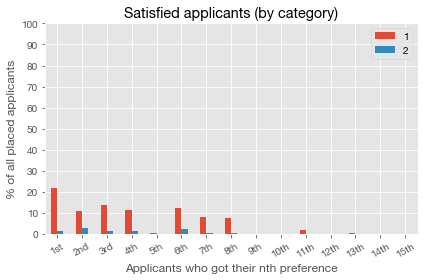

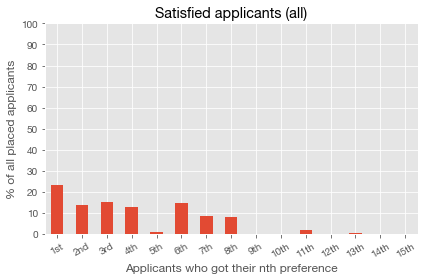

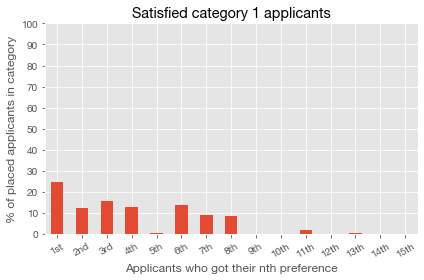

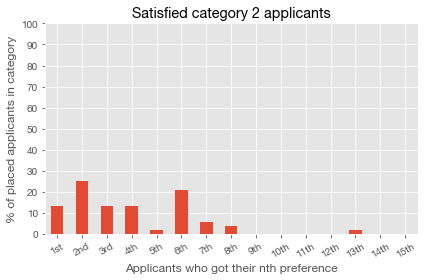

,Average unhappiness
strategy,
random with weighted random top,1.694737
stack with weighted random top,2.574627
variant stack with weighted random top,3.648305


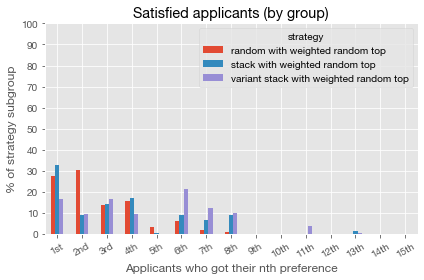

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,27.37%,32.84%,16.53%
Did not get first preference,72.63%,67.16%,83.47%


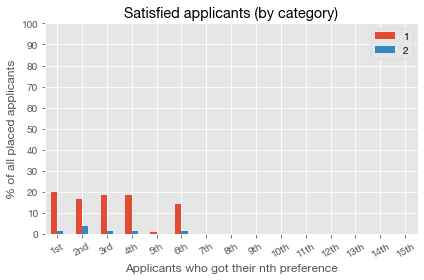

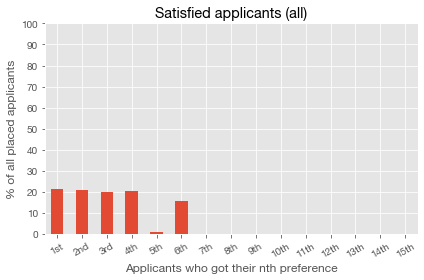

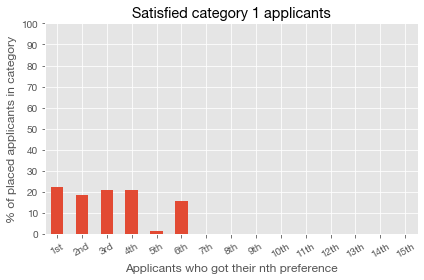

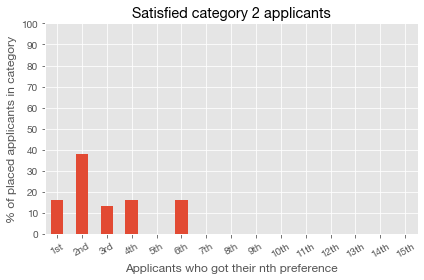

,Average unhappiness
strategy,
random with weighted random top,1.000000
stack with weighted random top,2.292994
variant stack with weighted random top,1.950276


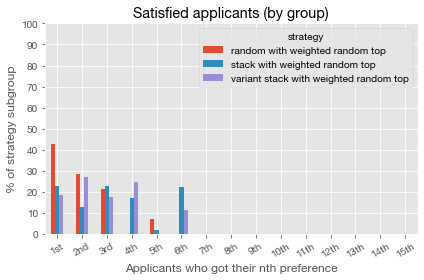

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,42.86%,22.93%,18.78%
Did not get first preference,57.14%,77.07%,81.22%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,1.639024
variant stack with weighted random top+stack with weighted random top,3.352798


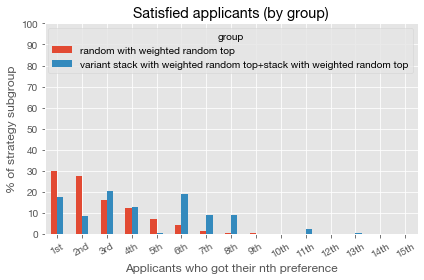

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,29.76%,17.52%
Did not get first preference,70.24%,82.48%


,Average unhappiness
group,
random with weighted random top,1.523810
variant stack with weighted random top+stack with weighted random top,3.416342


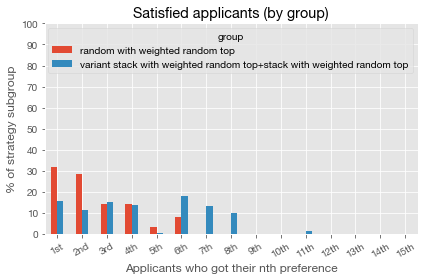

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,31.75%,15.95%
Did not get first preference,68.25%,84.05%


,Average unhappiness
group,
random with weighted random top,1.000000
variant stack with weighted random top+stack with weighted random top,1.752252


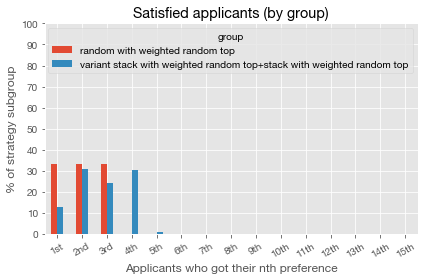

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,33.33%,13.06%
Did not get first preference,66.67%,86.94%


,Average unhappiness
group,
random with weighted random top,1.694737
variant stack with weighted random top+stack with weighted random top,3.259459


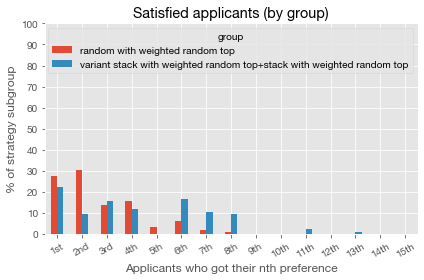

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,27.37%,22.43%
Did not get first preference,72.63%,77.57%


,Average unhappiness
group,
random with weighted random top,1.000000
variant stack with weighted random top+stack with weighted random top,2.109467


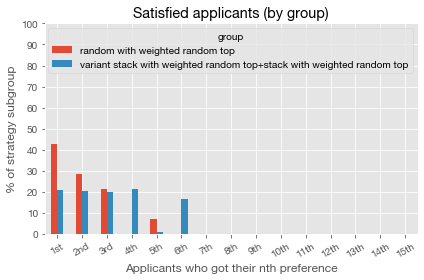

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,42.86%,20.71%
Did not get first preference,57.14%,79.29%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,1.639024
variant stack with weighted random top+stack with weighted random top,3.352798


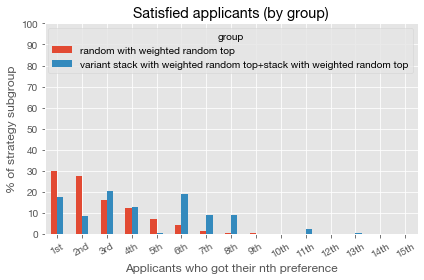

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,29.76%,17.52%
Did not get first preference,70.24%,82.48%


,Average unhappiness
group,
random with weighted random top,1.523810
variant stack with weighted random top+stack with weighted random top,3.416342


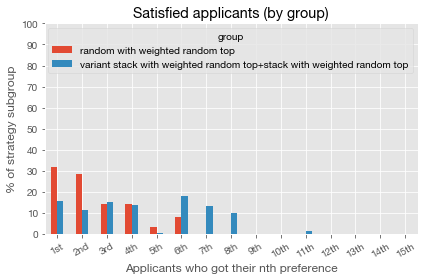

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,31.75%,15.95%
Did not get first preference,68.25%,84.05%


,Average unhappiness
group,
random with weighted random top,1.000000
variant stack with weighted random top+stack with weighted random top,1.752252


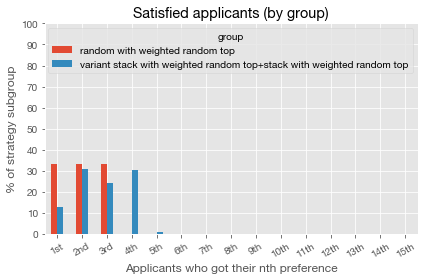

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,33.33%,13.06%
Did not get first preference,66.67%,86.94%


,Average unhappiness
group,
random with weighted random top,1.694737
variant stack with weighted random top+stack with weighted random top,3.259459


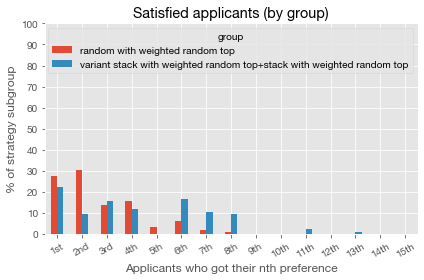

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,27.37%,22.43%
Did not get first preference,72.63%,77.57%


,Average unhappiness
group,
random with weighted random top,1.000000
variant stack with weighted random top+stack with weighted random top,2.109467


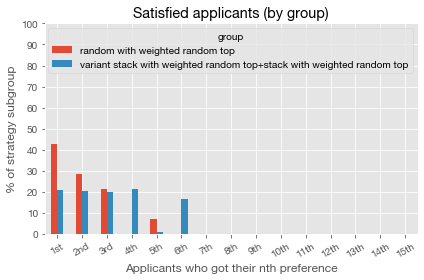

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,42.86%,20.71%
Did not get first preference,57.14%,79.29%


In [19]:
sim = create_and_run_sim([
    ("random with weighted random top", 0.2),
    ("variant stack with weighted random top", 0.5),
    ("stack with weighted random top", 0.3)
])

compare_two_groups_all_conditions(sim, ["random with weighted random top",
    ["variant stack with weighted random top", "stack with weighted random top"]])

#### 50% random with weighted random top, 25% mixed stacks with weighted random top, 25% default stack with weighted random top

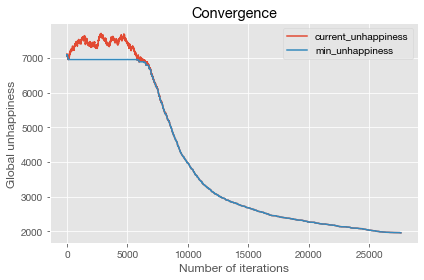

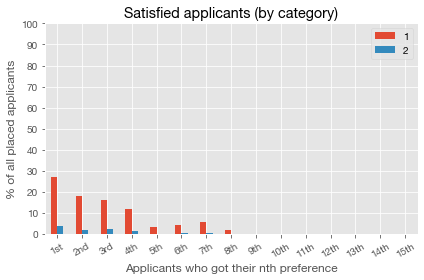

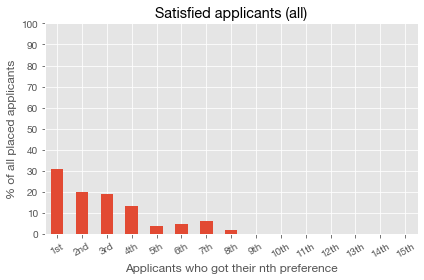

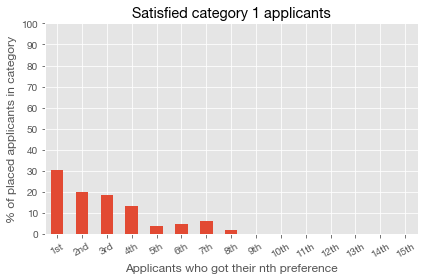

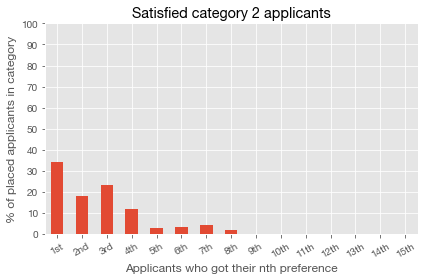

,Average unhappiness
strategy,
random with weighted random top,1.385321
stack with weighted random top,2.550420
variant stack with weighted random top,2.426230


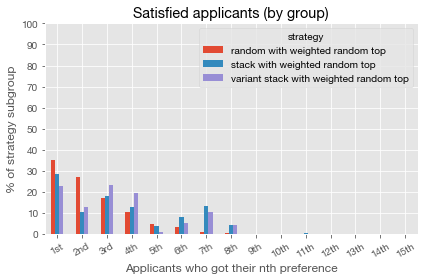

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,35.41%,28.57%,22.95%
Did not get first preference,64.59%,71.43%,77.05%


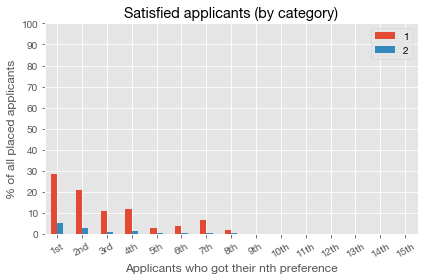

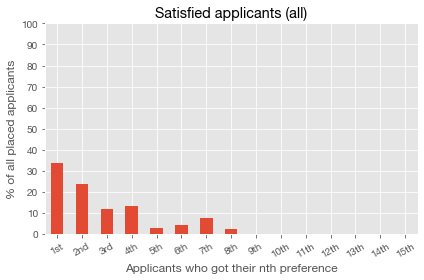

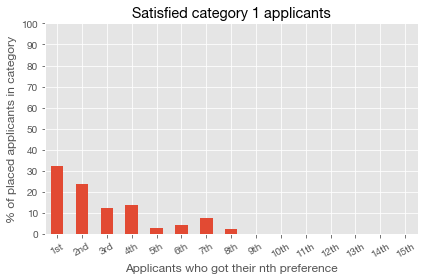

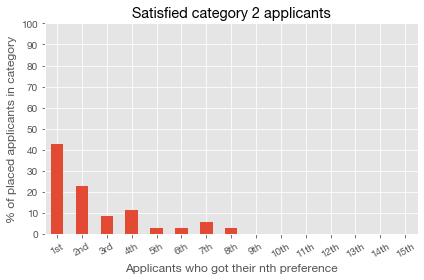

,Average unhappiness
strategy,
random with weighted random top,1.265306
stack with weighted random top,2.257576
variant stack with weighted random top,2.538462


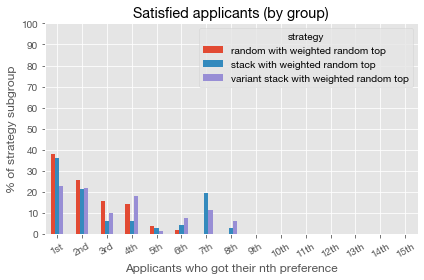

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,38.10%,36.36%,23.08%
Did not get first preference,61.90%,63.64%,76.92%


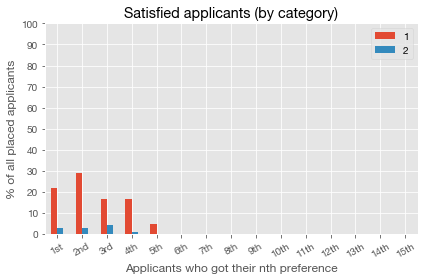

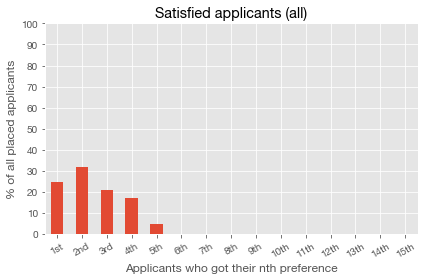

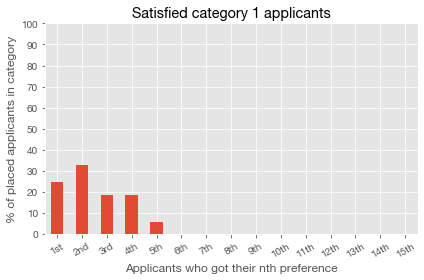

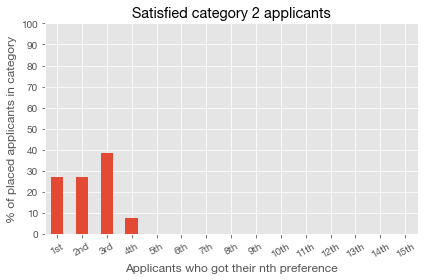

,Average unhappiness
strategy,
random with weighted random top,0.822581
stack with weighted random top,1.790123
variant stack with weighted random top,1.597561


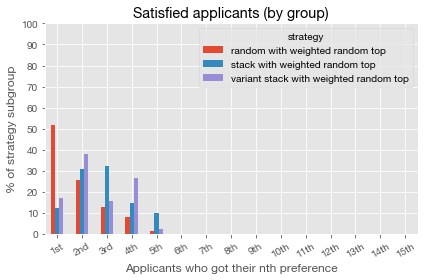

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,51.61%,12.35%,17.07%
Did not get first preference,48.39%,87.65%,82.93%


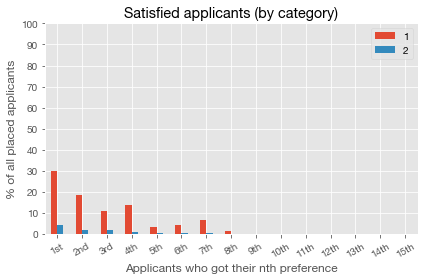

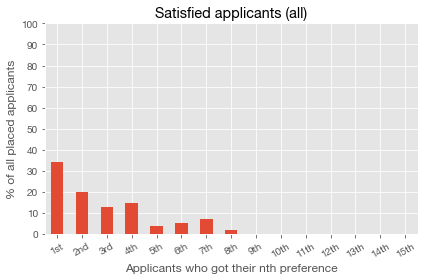

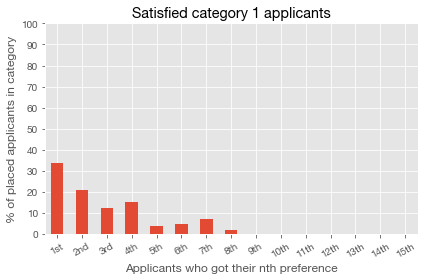

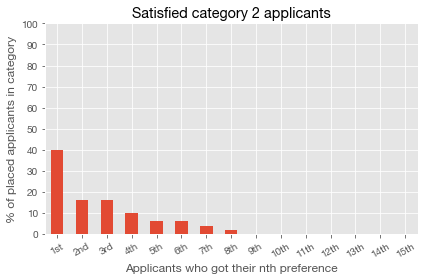

,Average unhappiness
strategy,
random with weighted random top,1.412766
stack with weighted random top,2.270270
variant stack with weighted random top,2.403670


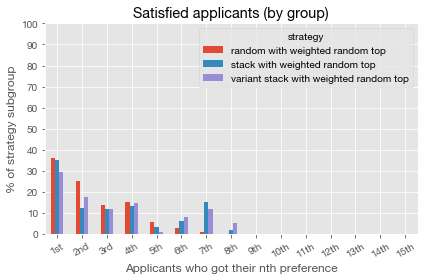

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,36.17%,35.14%,29.36%
Did not get first preference,63.83%,64.86%,70.64%


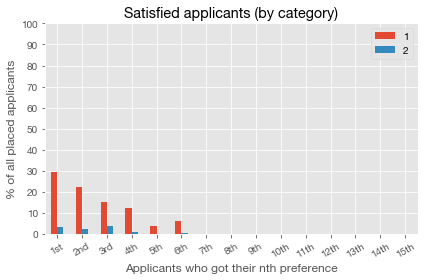

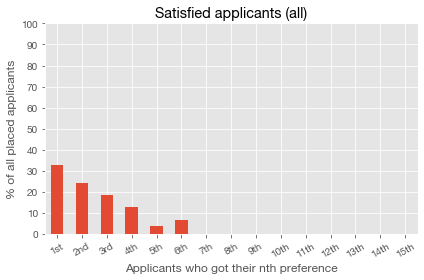

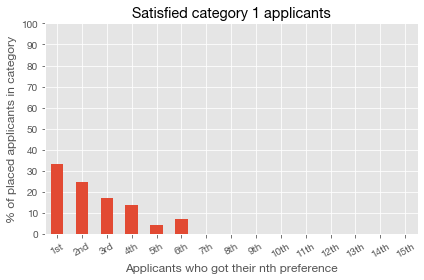

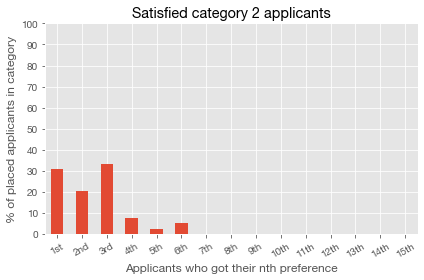

,Average unhappiness
strategy,
random with weighted random top,0.906250
stack with weighted random top,2.142857
variant stack with weighted random top,1.533333


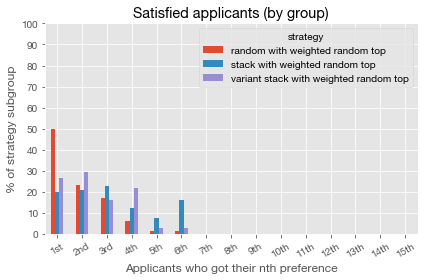

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,50.00%,20.17%,26.67%
Did not get first preference,50.00%,79.83%,73.33%


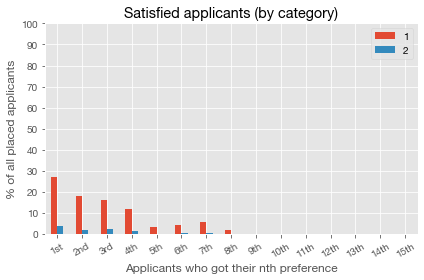

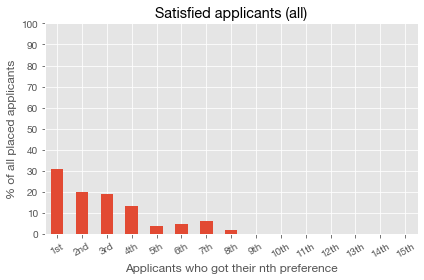

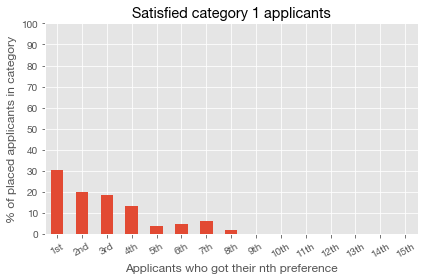

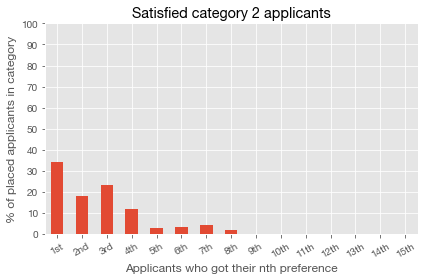

,Average unhappiness
strategy,
random with weighted random top,1.385321
stack with weighted random top,2.550420
variant stack with weighted random top,2.426230


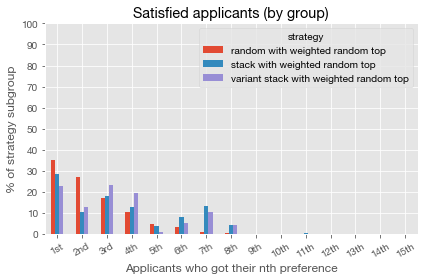

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,35.41%,28.57%,22.95%
Did not get first preference,64.59%,71.43%,77.05%


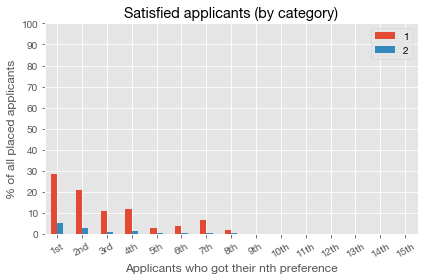

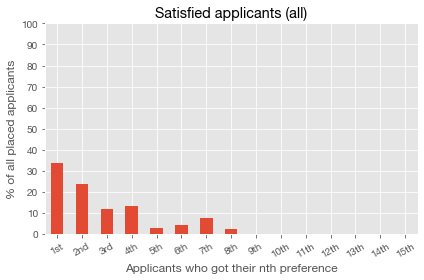

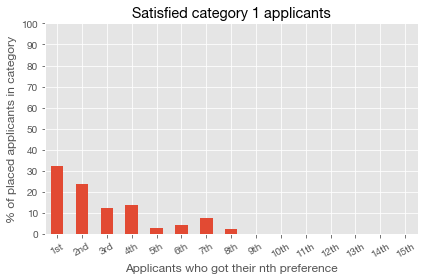

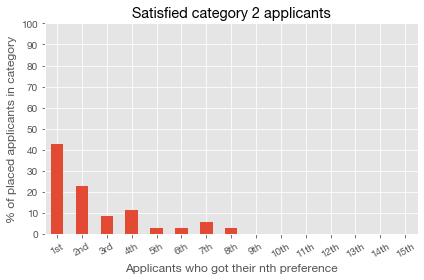

,Average unhappiness
strategy,
random with weighted random top,1.265306
stack with weighted random top,2.257576
variant stack with weighted random top,2.538462


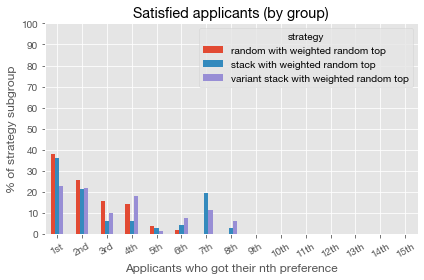

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,38.10%,36.36%,23.08%
Did not get first preference,61.90%,63.64%,76.92%


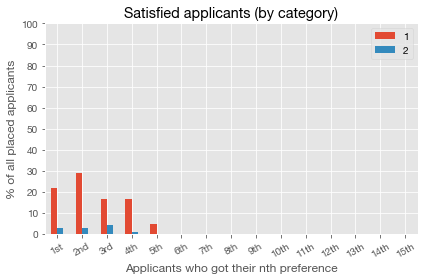

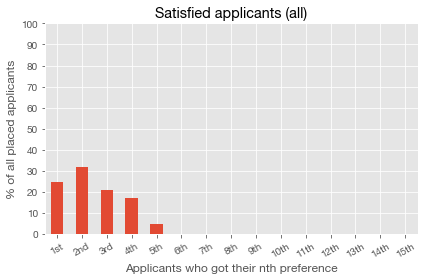

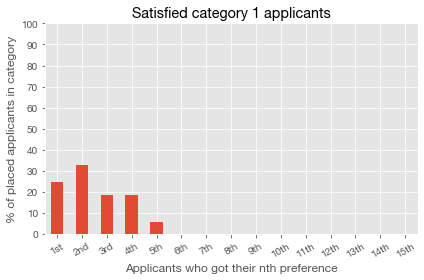

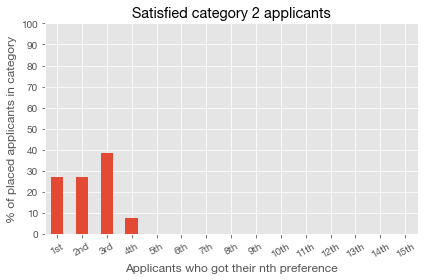

,Average unhappiness
strategy,
random with weighted random top,0.822581
stack with weighted random top,1.790123
variant stack with weighted random top,1.597561


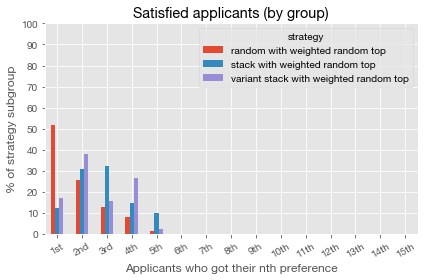

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,51.61%,12.35%,17.07%
Did not get first preference,48.39%,87.65%,82.93%


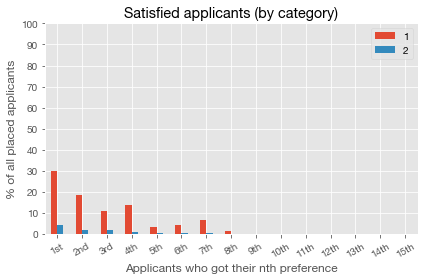

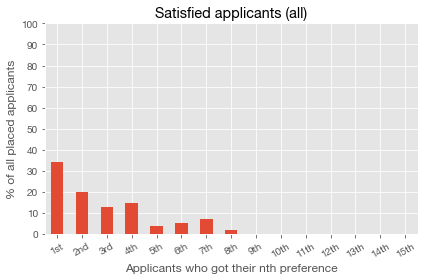

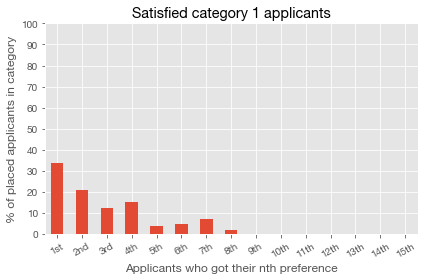

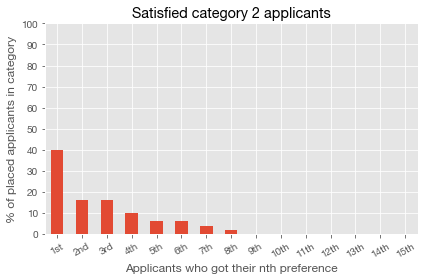

,Average unhappiness
strategy,
random with weighted random top,1.412766
stack with weighted random top,2.270270
variant stack with weighted random top,2.403670


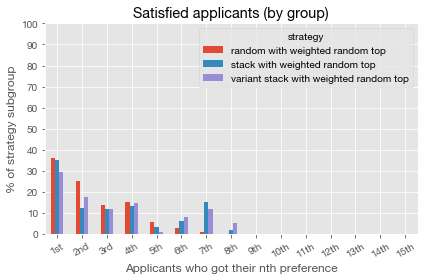

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,36.17%,35.14%,29.36%
Did not get first preference,63.83%,64.86%,70.64%


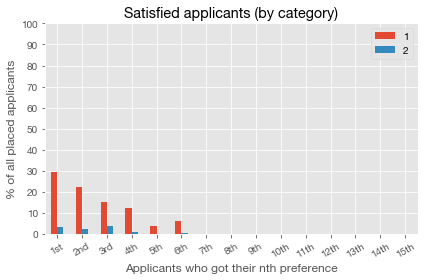

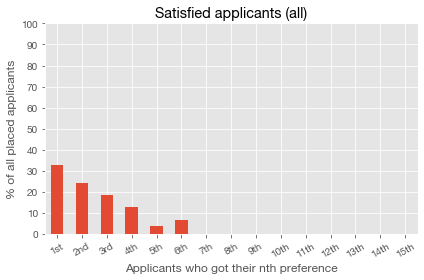

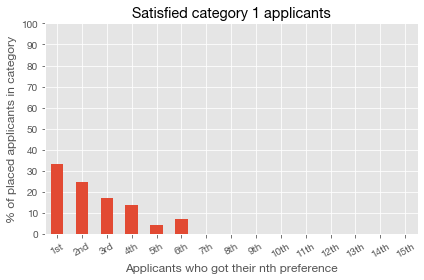

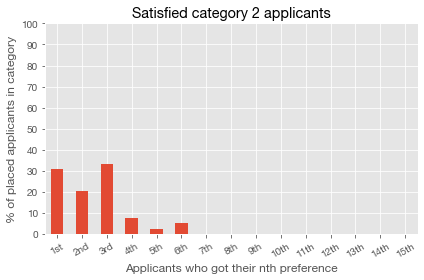

,Average unhappiness
strategy,
random with weighted random top,0.906250
stack with weighted random top,2.142857
variant stack with weighted random top,1.533333


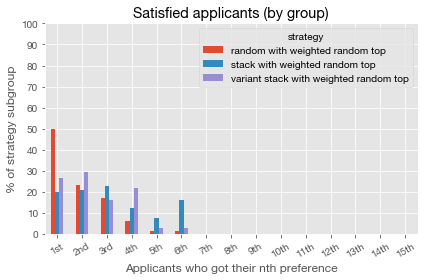

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,50.00%,20.17%,26.67%
Did not get first preference,50.00%,79.83%,73.33%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,1.385321
variant stack with weighted random top+stack with weighted random top,2.487552


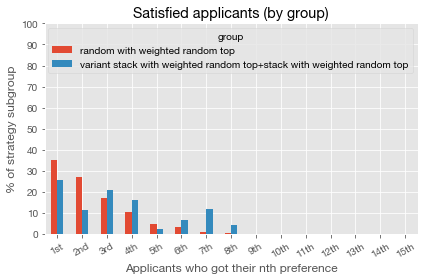

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,35.41%,25.73%
Did not get first preference,64.59%,74.27%


,Average unhappiness
group,
random with weighted random top,1.265306
variant stack with weighted random top+stack with weighted random top,2.409722


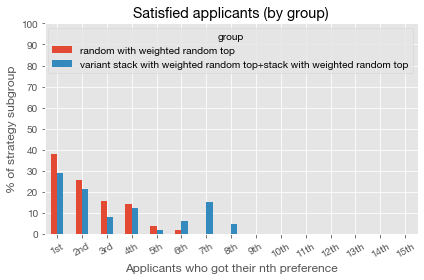

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,38.10%,29.17%
Did not get first preference,61.90%,70.83%


,Average unhappiness
group,
random with weighted random top,0.822581
variant stack with weighted random top+stack with weighted random top,1.693252


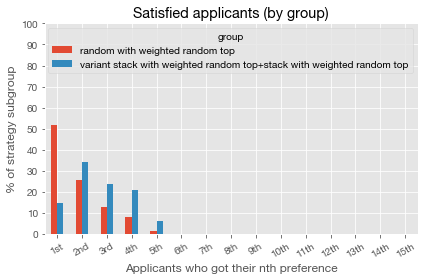

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,51.61%,14.72%
Did not get first preference,48.39%,85.28%


,Average unhappiness
group,
random with weighted random top,1.412766
variant stack with weighted random top+stack with weighted random top,2.336364


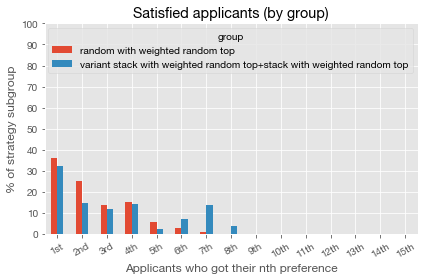

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,36.17%,32.27%
Did not get first preference,63.83%,67.73%


,Average unhappiness
group,
random with weighted random top,0.906250
variant stack with weighted random top+stack with weighted random top,1.857143


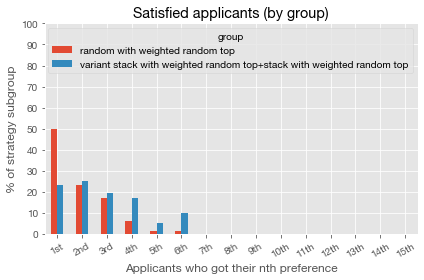

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,50.00%,23.21%
Did not get first preference,50.00%,76.79%


C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,Average unhappiness
group,
random with weighted random top,1.385321
variant stack with weighted random top+stack with weighted random top,2.487552


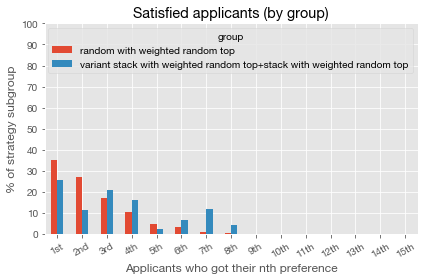

C:\Users\camin\Code\stack_sim_revisited\heti_stack\applicant.py:322: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["group"] = ""
c:\users\camin\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,35.41%,25.73%
Did not get first preference,64.59%,74.27%


,Average unhappiness
group,
random with weighted random top,1.265306
variant stack with weighted random top+stack with weighted random top,2.409722


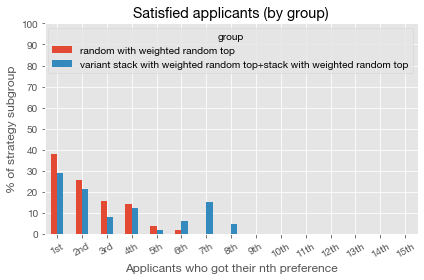

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,38.10%,29.17%
Did not get first preference,61.90%,70.83%


,Average unhappiness
group,
random with weighted random top,0.822581
variant stack with weighted random top+stack with weighted random top,1.693252


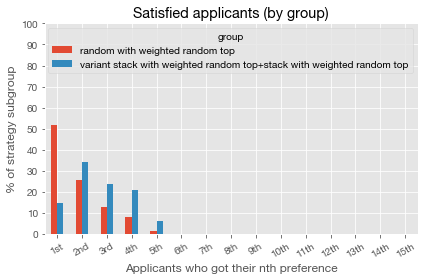

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,51.61%,14.72%
Did not get first preference,48.39%,85.28%


,Average unhappiness
group,
random with weighted random top,1.412766
variant stack with weighted random top+stack with weighted random top,2.336364


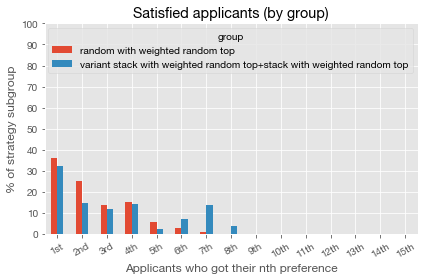

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,36.17%,32.27%
Did not get first preference,63.83%,67.73%


,Average unhappiness
group,
random with weighted random top,0.906250
variant stack with weighted random top+stack with weighted random top,1.857143


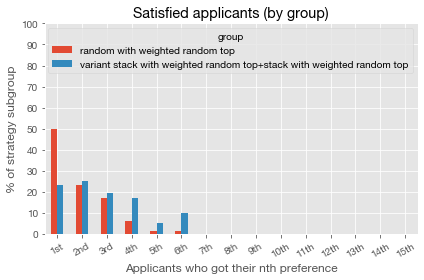

,random with weighted random top,variant stack with weighted random top+stack with weighted random top
Got first preference,50.00%,23.21%
Did not get first preference,50.00%,76.79%


In [22]:
sim = create_and_run_sim([
    ("random with weighted random top", 0.5),
    ("variant stack with weighted random top", 0.25),
    ("stack with weighted random top", 0.25)
])

compare_two_groups_all_conditions(sim, ["random with weighted random top",
    ["variant stack with weighted random top", "stack with weighted random top"]])

## Discussion

Interpretation of the results is challenging because it appears to show different things with different parameters. However, it would often appear, under this new analysis, that stacking is not necessarily superior to random preferencing, and it in fact may be the other way around. This includes after the exclusion of DRA applicants.

- Addressing common rumours
    - It's often claimed that "the last 4 are the most important". Under simulated annealing, this is not the case. There also appears to be a lot of confusion among the general medical cohort regarding how the algorithm *actually* works.
    - HETI themselves claim that stacking actually hurts your chance of getting to your first-preferenced hospital. Whether this serves as experimental proof of that is hard to say and requires someone else to check over and verify that the code is doing what it's supposed to, and hopefully replicate the results independently.
- Comparison with categorical allocation
    - Categorical allocation suffers from many of the same problems as far as being vulnerable to "stacking".
    - Many of the ideas of placing a random hospital at the 12th or 14th place to have a better chance at getting that hospital come from an understanding that the algorithm is categorical rather than annealing. Strategies like this do not work, please do not try them.

## Limitations

- The exact parameters HETI uses are unknown to us.
- Output doesn't exactly resemble the figures in HETI's report. This could easily be due to earlier-mentioned implementational simplifications, but there may be some unknown unknowns that require someone from HETI to comment on before this can be called an accurate representation of the allocation process.

## Conclusion (what should you do?)

If you're a student, the best course of action would be to keep stacking. While this simulation could use some improvement, it does appear to demonstrate the superiority of stacking over random preferencing in a manner that is statistically significant.

However this is an interactive article, and there's much more I haven't tested simply because I can't exhaust the real number line. An extra code block has been left down below for you to experiment with your own scenario if you so choose. Happy hacking!

In [ ]:
# Experiment with your own applicant pool simulation here

sim = create_and_run_sim([
    # Add the strategies you want to test here as a pair with a comma at the end of the line
    # Include the strategy and the fraction of people you want to use it as a decimal
    # e.g.
    ("stack with weighted random top", 0.50),
    ("variant stack with weighted random top", 0.25),
    ("random", 0.25)
])

# You can also choose to compare different strategy subgroups of the candidates for significance testing
compare_two_groups_all_scenarios(sim, [
    # put the groups you want to compare here
    # e.g.
    "random",
    # if you want to combine two groups together, write it like this
    ["stack with weighted random top", "variant stack with weighted random top"]
])

Join me again later for Part 2: Alternatives to the current algorithm.